# Deep Learning in Data Science
## Assignment 1 - One layer multi class classifier

The overall goal of this first assignment is to implement a one layer network that performs classification on a multi class problem. We'll be using the CIFAR-10 image dataset. The network will be trained with stochastic mini-batch gradient descent, aiming at minimizing a loss function. The loss function used is the cross-entropy plus a regularization term.

In [1]:
%matplotlib inline

import os
import sys
import time
import pickle
import tarfile
import numpy as np
import pandas as pd
import urllib.request
import matplotlib.cm as cm
import matplotlib.pyplot as plt

from tqdm import tqdm
from functools import reduce
from sklearn.manifold import TSNE
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import TruncatedSVD
from IPython.display import Image, display, HTML

In [2]:
np.random.seed(42)
np.seterr(over='raise');
plt.rcParams['figure.figsize'] = (14.0, 8.0)

if not os.path.isdir('images'):
    os.mkdir('images')
    with open('.gitignore', 'a+') as out:
        out.write('images\n')

## CIFAR-10 dataset

The Python version of the dataset is downloaded from [https://www.cs.toronto.edu/~kriz/cifar.html](https://www.cs.toronto.edu/~kriz/cifar.html).

The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images. 

The dataset is divided into five training batches and one test batch, each with 10000 images. The test batch contains exactly 1000 randomly-selected images from each class. The training batches contain the remaining images in random order, but some training batches may contain more images from one class than another. Between them, the training batches contain exactly 5000 images from each class.

In [3]:
class CIFAR10:
    def __init__(self):
        self.output_size = 10
        self.input_size = 32 * 32 * 3
        self.download_dataset()
        self.load_labels()
        self.loaded_batches = {}
        self.label_encoder = preprocessing.LabelBinarizer()
        self.label_encoder.fit([x for x in range(self.output_size)])

    def load_labels(self):
        with open('cifar-10-batches-py/batches.meta', 'rb') as f:
            data = pickle.load(f, encoding='bytes')
            self.labels = [x.decode('ascii') for x in data[b'label_names']]

    def download_dataset(self):
        if not os.path.isdir('cifar-10-batches-py'):
            file, _ = urllib.request.urlretrieve("https://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz",
                                                 "temp.tar.gz")
            with tarfile.open(file, "r:gz") as tar:
                tar.extractall()
            os.remove(file)
            with open('.gitignore', 'a+') as out:
                out.write('cifar-10-batches-py\n')

    def get_batch(self, batch_name):
        if not batch_name in self.loaded_batches:
            with open('cifar-10-batches-py/' + batch_name, 'rb') as f:
                data = pickle.load(f, encoding='bytes')
                
            data[b'labels'] = np.array(data[b'labels'])
            # data[b'labels'] %= 5 # Cheating
            
            self.loaded_batches[batch_name] = {
                'batch_name': data[b'batch_label'],
                'images': np.divide(data[b'data'], 255),
                'one_hot_labels': self.label_encoder.transform(data[b'labels']),
                'labels': data[b'labels']
            }
        return self.loaded_batches[batch_name]

    def get_batches(self, *args):
        batches = [self.get_batch(name) for name in args]
        return {
            'batch_name': ", ".join(args),
            'images': np.vstack([b['images'] for b in batches]),
            'one_hot_labels': np.vstack([b['one_hot_labels'] for b in batches]),
            'labels': np.hstack([b['labels'] for b in batches])
        }
    
def describe_dataset(dataset, name, labels):
    print(name)
    print('- total images', dataset['labels'].size)
    for l in np.unique(dataset['labels']):
        print('- {:.2%}  {}'.format((dataset['labels'] == l).sum() / dataset['labels'].size, labels[l]))
    print()

In [4]:
cifar = CIFAR10()
training = cifar.get_batches('data_batch_1','data_batch_2','data_batch_3','data_batch_4')
validation = cifar.get_batches('data_batch_5')
test = cifar.get_batches('test_batch')
    
describe_dataset(training, 'Training:', cifar.labels)
describe_dataset(validation, 'Validation:', cifar.labels)
describe_dataset(test, 'Test:', cifar.labels)

Training:
- total images 40000
- 9.96%  airplane
- 9.96%  automobile
- 10.12%  bird
- 9.96%  cat
- 10.01%  deer
- 9.94%  dog
- 10.05%  frog
- 10.06%  horse
- 9.99%  ship
- 9.95%  truck

Validation:
- total images 10000
- 10.14%  airplane
- 10.14%  automobile
- 9.52%  bird
- 10.16%  cat
- 9.97%  deer
- 10.25%  dog
- 9.80%  frog
- 9.77%  horse
- 10.03%  ship
- 10.22%  truck

Test:
- total images 10000
- 10.00%  airplane
- 10.00%  automobile
- 10.00%  bird
- 10.00%  cat
- 10.00%  deer
- 10.00%  dog
- 10.00%  frog
- 10.00%  horse
- 10.00%  ship
- 10.00%  truck



### Showing some images

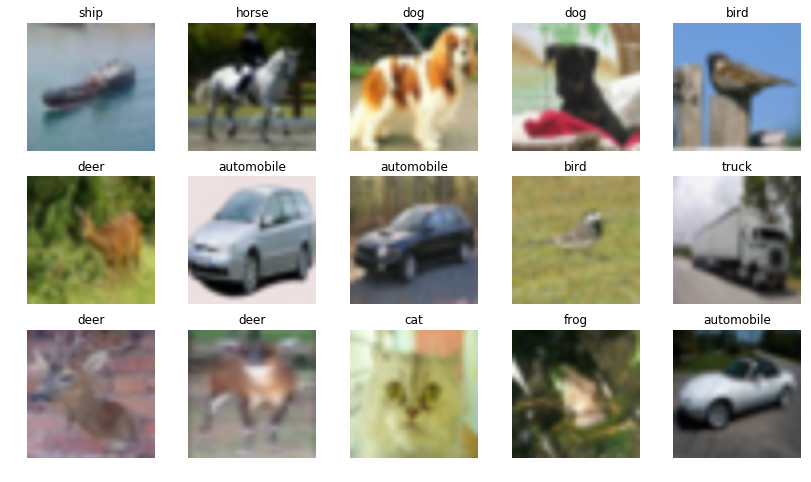

In [5]:
def show_image(img, label='', interpolation='gaussian'):
    squared_image = np.rot90(np.reshape(img, (32, 32, 3), order='F'), k=3)
    plt.imshow(squared_image, interpolation=interpolation)
    plt.axis('off')
    plt.title(label)

for plot_i, img_i  in enumerate(np.random.choice(training['images'].shape[0], 15, replace=False)):
    plt.subplot(3, 5, plot_i+1)
    show_image(training['images'][img_i], cifar.labels[training['labels'][img_i]])
plt.show()

### About the dataset

#### Mean and variance of the individual classes
To see check in advance if the network is going to be able to correctly learn a classification function, we can have a look at the individual classes and measure their mean and variance. Intuitively, if all the dog images look the same (same dog, same angle, same size of the subject), their mean will still look like a dog and the variance will be low. On the contrary, if all the automobile images are different from each other, their mean will be unrecognizable and it will have an higher variance.

Note that the we first compute the variances along the corresponding pixels in each image and then sum them.

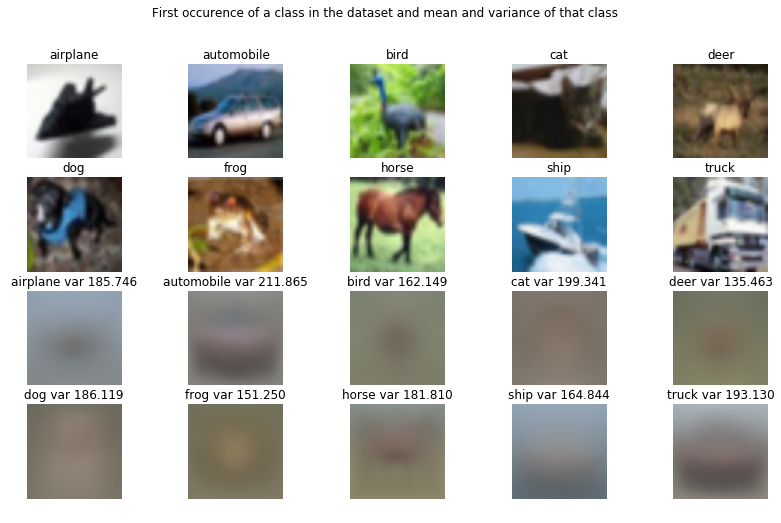

In [6]:
all_images = cifar.get_batches('data_batch_1','data_batch_2','data_batch_3',
                               'data_batch_4', 'data_batch_5', 'test_batch')

for klass, name in enumerate(cifar.labels):
    images_per_class = all_images['images'][(all_images['labels'] == klass)]
    
    plt.subplot(4,5,klass+1)
    show_image(images_per_class[0], name)
    
    plt.subplot(4,5,klass+11)
    show_image(images_per_class.mean(axis=0), 
               '{} var {:.3f}'.format(name, images_per_class.var(axis=0).sum()))
    
plt.suptitle('First occurence of a class in the dataset and mean and variance of that class')
plt.show()

#### Dimensionality reduction

We use a combination of PCA and t-SNE to have a look at the dataset and check its separability properties. In the following section, these techniques are applied to the test set. From the looks of the result, obtaining a good accuracy with a linear classifier does not seem feasible.

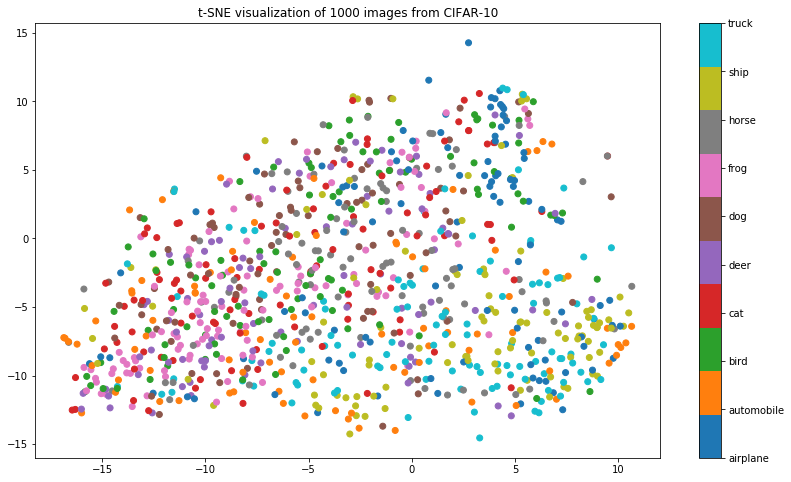

In [7]:
def dim_reduction(dataset, how_many=1000):
    X_50_dim = TruncatedSVD(n_components=50, random_state=42).fit_transform(dataset['images'][:how_many])
    X_2_dim = TSNE(n_components=2, perplexity=40).fit_transform(X_50_dim)
    plt.scatter(X_2_dim[:, 0], X_2_dim[:, 1], c=dataset['labels'][0:how_many], cmap=cm.Vega10)
    plt.title('t-SNE visualization of ' + str(how_many) + ' images from CIFAR-10');
    cbar = plt.colorbar()
    cbar.ax.set_yticklabels(cifar.labels)
    plt.show()
dim_reduction(test)

## Building the model

In [8]:
class Network():
    def __init__(self, input_size, output_size, l=0.0):
        self.input_size = input_size
        self.output_size = output_size
        self.W = np.random.normal(loc=0.0, scale=0.01, size=(output_size, input_size))
        self.b = np.random.normal(loc=0.0, scale=0.01, size=(output_size, 1))
        self.l = l

    def softmax(self, x):
        try:
            e = np.exp(x)
            return e / np.sum(e, axis=0)
        except FloatingPointError:
            # What happens here is that we get some of the values in x that are too big
            # so the exp overflows. In that case we check column by column where the
            # problem is
            return self.softmax_column_by_column(x)

    def softmax_column_by_column(self, x):
        cols = x.shape[1]
        res = np.finfo(float).eps * np.ones_like(x)
        for c in range(cols):
            try:
                e = np.exp(x[:, c])
                res[:, c] = e / np.sum(e, axis=0)
            except FloatingPointError:
                res[np.argmax(x[:, c]), :] = 1 - np.finfo(float).eps
        return res

    def evaluate(self, input_data):
        """
        input_data must be a matrix containing one input per column (dimensions: input_size * N)
        
        output will be:
        - a matrix containing the probabilities of each class, one image per column 
          (dimensions: output_size * N)
        - a row vector containing the numerical index of the class with the highest probability,
          one image per column (dimensions: 1 * N)
        """
        X = np.reshape(input_data, (self.input_size, -1))
        probabilities = self.softmax(np.dot(self.W, X) + self.b)
        predictions = np.argmax(probabilities, axis=0)
        return probabilities, predictions

    def cost(self, probabilities, ground_truth):
        """
        probabilities should be the same as the first output of the evaluate function
        (dimensions: output_size * N)
        
        ground_truth is matrix containing the one-hot encoded true labels, one image per column
        (dimensions: output_size * N)
        
        l is a scalar used as a weight in the regularization term
        """
        N = probabilities.shape[1]
        probabilities = np.reshape(probabilities, (self.output_size, -1))
        ground_truth = np.reshape(ground_truth, (self.output_size, -1))

        log_arg = np.multiply(ground_truth, probabilities).sum(axis=0)
        log_arg[log_arg == 0] = np.finfo(float).eps

        return - np.log(log_arg).sum() / N + self.l * np.power(self.W, 2).sum()

    def accuracy(self, predictions, ground_truth):
        """
        predictions should be the same as the second output of the evaluate function
        (dimensions: N * 1)
        
        ground_truth is matrix containing the one-hot encoded true labels, one image per column
        (dimensions: output_size * N)
        """
        N = predictions.shape[0]
        ground_truth = np.argmax(ground_truth, axis=0)
        return np.sum(predictions == ground_truth) / N

    def gradients_slides(self, input_data, probabilities, ground_truth):
        N = probabilities.shape[1]

        grad_w = np.zeros_like(self.W)
        grad_b = np.zeros_like(self.b)

        for i in range(N):
            x = input_data[:, i]
            y = ground_truth[:, i]
            p = probabilities[:, i]
            
            # The actual formula, which I broke down for ease of debuggin
            # g = - np.dot(y, (np.diag(p) - np.outer(p, p))) / np.dot(y, p)

            t1 = np.outer(p, p)
            t2 = np.dot(y, (np.diag(p) - t1))
            t3 = np.dot(y, p)
            if t3 == 0:
                t3 = np.finfo(float).eps
            g = - t2 / t3

            grad_w += np.outer(g, x)
            grad_b += np.reshape(g, grad_b.shape)

        grad_w = grad_w / N + 2 * self.l * self.W
        grad_b /= N

        return grad_w, grad_b

    def gradients_simple(self, input_data, probabilities, ground_truth):
        N = probabilities.shape[1]

        grad_w = np.zeros_like(self.W)
        grad_b = np.zeros_like(self.b)

        for i in range(N):
            x = input_data[:, i]
            y = ground_truth[:, i]
            p = probabilities[:, i]

            g = p - y

            grad_w += np.outer(g, x)
            grad_b += np.reshape(g, grad_b.shape)

        grad_w = grad_w / N + 2 * self.l * self.W
        grad_b /= N

        return grad_w, grad_b

Example run with no training:

Cost: 2.26840036678
Accuracy: 0.00%


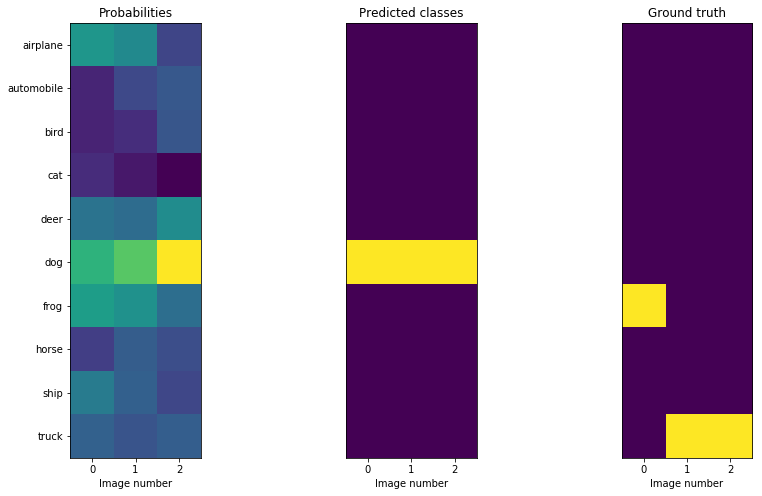

In [9]:
n = Network(cifar.input_size, cifar.output_size)
N = 3
input_data = training['images'][0:N].transpose()
ground_truth = training['one_hot_labels'][0:N].transpose()
probabilities, predictions = n.evaluate(input_data)

plt.subplot(1,3,1)
plt.imshow(probabilities)
plt.yticks(range(10), cifar.labels)
plt.xlabel('Image number')
plt.title('Probabilities')

plt.subplot(1,3,2)
plt.imshow(cifar.label_encoder.transform(predictions).T)
plt.yticks([])
plt.xlabel('Image number')
plt.title('Predicted classes')

plt.subplot(1,3,3)
plt.imshow(ground_truth)
plt.yticks([])
plt.xlabel('Image number')
plt.title('Ground truth')

cost = n.cost(probabilities, ground_truth)
print('Cost:', cost)

accuracy = n.accuracy(predictions, ground_truth)
print('Accuracy: {:.2%}'.format(accuracy))

## Gradient checking

We want to check that the gradients computed in the ```gradients``` function correspond to the correct gradients. To do this, we compare the gradient obtained by the network with the gradient computed with the finite difference method.

In [10]:
def compute_grads_num(input_data, ground_truth, net):
    h = 1e-6  # np.finfo(float).eps

    grad_w = np.zeros_like(net.W)
    grad_b = np.zeros_like(net.b)

    probabilities, _ = net.evaluate(input_data)
    cost = net.cost(probabilities, ground_truth)

    for i in tqdm(range(net.b.shape[0])):
        net.b[i] += h
        probabilities, _ = net.evaluate(input_data)
        c2 = net.cost(probabilities, ground_truth)
        grad_b[i] = (c2 - cost) / h
        net.b[i] -= h

    for i in tqdm(range(net.W.shape[0])):
        for j in range(net.W.shape[1]):
            net.W[i, j] += h
            probabilities, _ = net.evaluate(input_data)
            c2 = net.cost(probabilities, ground_truth)
            grad_w[i, j] = (c2 - cost) / h
            net.W[i, j] -= h

    return grad_w, grad_b

def print_grad_diff(grad_w, grad_w_num, grad_b, grad_b_num):
    print('Grad W:')
    print('- sum of abs differences: {:.3e}'.format(np.abs(grad_w - grad_w_num).sum()))
    print('- mean of abs values   W: {:.3e}   W_num: {:.3e}'
          .format(np.abs(grad_w).mean(), np.abs(grad_w_num).mean()))
    print('- min  of abs values   W: {:.3e}   W_num: {:.3e}'
          .format(np.abs(grad_w).min(),  np.abs(grad_w_num).min()))
    print('- max  of abs values   W: {:.3e}   W_num: {:.3e}'
          .format(np.abs(grad_w).max(),  np.abs(grad_w_num).max()))
    print('Grad b:')
    print('- sum of abs differences: {:.3e}'.format(np.abs(grad_b - grad_b_num).sum()))
    print('- mean of abs values   b: {:.3e}   b_num: {:.3e}'
          .format(np.abs(grad_b).mean(), np.abs(grad_b_num).mean()))
    print('- min  of abs values   b: {:.3e}   b_num: {:.3e}'
          .format(np.abs(grad_b).min(),  np.abs(grad_b_num).min()))
    print('- max  of abs values   b: {:.3e}   b_num: {:.3e}'
          .format(np.abs(grad_b).max(),  np.abs(grad_b_num).max()))

### Without regularization

Computing the gradients with the finite difference method

In [11]:
n = Network(cifar.input_size, cifar.output_size)
N = 100
input_data = training['images'][0:N].transpose()
ground_truth = training['one_hot_labels'][0:N].transpose()

probabilities, _ = n.evaluate(input_data)
grad_w_num, grad_b_num = compute_grads_num(input_data, ground_truth, n)

100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


With the formula on the slides

In [12]:
grad_w, grad_b = n.gradients_slides(input_data, probabilities, ground_truth)
print_grad_diff(grad_w, grad_w_num, grad_b, grad_b_num)

Grad W:
- sum of abs differences: 3.673e-04
- mean of abs values   W: 1.243e-02   W_num: 1.243e-02
- min  of abs values   W: 1.404e-06   W_num: 1.384e-06
- max  of abs values   W: 4.350e-02   W_num: 4.350e-02
Grad b:
- sum of abs differences: 4.499e-07
- mean of abs values   b: 2.766e-02   b_num: 2.766e-02
- min  of abs values   b: 7.897e-03   b_num: 7.897e-03
- max  of abs values   b: 6.306e-02   b_num: 6.306e-02


With a simpler formula

In [13]:
grad_w, grad_b = n.gradients_simple(input_data, probabilities, ground_truth)
print_grad_diff(grad_w, grad_w_num, grad_b, grad_b_num)

Grad W:
- sum of abs differences: 3.673e-04
- mean of abs values   W: 1.243e-02   W_num: 1.243e-02
- min  of abs values   W: 1.404e-06   W_num: 1.384e-06
- max  of abs values   W: 4.350e-02   W_num: 4.350e-02
Grad b:
- sum of abs differences: 4.499e-07
- mean of abs values   b: 2.766e-02   b_num: 2.766e-02
- min  of abs values   b: 7.897e-03   b_num: 7.897e-03
- max  of abs values   b: 6.306e-02   b_num: 6.306e-02


### With regularization

Computing the gradients with the finite difference method

In [14]:
n = Network(cifar.input_size, cifar.output_size, l=2.0)
N = 100
input_data = training['images'][0:N].transpose()
ground_truth = training['one_hot_labels'][0:N].transpose()

probabilities, _ = n.evaluate(input_data)
grad_w_num, grad_b_num = compute_grads_num(input_data, ground_truth, n)

100%|██████████| 10/10 [00:28<00:00,  2.84s/it]


With the formula on the slides

In [15]:
grad_w, grad_b = n.gradients_slides(input_data, probabilities, ground_truth)
print_grad_diff(grad_w, grad_w_num, grad_b, grad_b_num)

Grad W:
- sum of abs differences: 6.178e-02
- mean of abs values   W: 3.701e-02   W_num: 3.701e-02
- min  of abs values   W: 2.192e-06   W_num: 4.199e-06
- max  of abs values   W: 2.028e-01   W_num: 2.028e-01
Grad b:
- sum of abs differences: 4.370e-07
- mean of abs values   b: 4.328e-02   b_num: 4.328e-02
- min  of abs values   b: 7.400e-03   b_num: 7.400e-03
- max  of abs values   b: 9.094e-02   b_num: 9.094e-02


With simpler formula

In [16]:
grad_w, grad_b = n.gradients_simple(input_data, probabilities, ground_truth)
print_grad_diff(grad_w, grad_w_num, grad_b, grad_b_num)

Grad W:
- sum of abs differences: 6.178e-02
- mean of abs values   W: 3.701e-02   W_num: 3.701e-02
- min  of abs values   W: 2.192e-06   W_num: 4.199e-06
- max  of abs values   W: 2.028e-01   W_num: 2.028e-01
Grad b:
- sum of abs differences: 4.370e-07
- mean of abs values   b: 4.328e-02   b_num: 4.328e-02
- min  of abs values   b: 7.400e-03   b_num: 7.400e-03
- max  of abs values   b: 9.094e-02   b_num: 9.094e-02


The difference is not extremely low (6e-2), but the learning process works. The differences could be coming from the choice of the step length in the numerical computation of the gradient, where 1e-6 has been chosen.

## Training function

In [17]:
def train(training_set, validation_set, n, 
          initial_eta=0.01, epochs=1, 
          batch_size=None, shuffle=False, final_eta=None):
    
    acc_train, acc_val, cost_train, cost_val = [], [], [], []
    total_samples = training_set['images'].shape[0]
    batch_size = batch_size or total_samples // 100
    indexes = np.arange(total_samples)
    
    for epoch_num in tqdm(range(epochs)):
        if shuffle:
            np.random.shuffle(indexes)
        
        if final_eta:
            eta = initial_eta - epoch_num * (initial_eta - final_eta) / epochs
        else:
            eta = initial_eta
        
        for start in range(0, total_samples, batch_size):
            # Prepare batch
            batch_indexes = indexes[start: start + batch_size]
            input_data = training_set['images'][batch_indexes].transpose()
            ground_truth = training_set['one_hot_labels'][batch_indexes].transpose()

            # Update weights
            probabilities, predictions = n.evaluate(input_data)
            grad_w, grad_b = n.gradients_slides(input_data, probabilities, ground_truth)
            # grad_w, grad_b = n.gradients_simple(input_data, probabilities, ground_truth)
            n.W -= eta * grad_w
            n.b -= eta * grad_b
        
        # Metrics on training
        probabilities, predictions = n.evaluate(training_set['images'].transpose())
        cost = n.cost(probabilities, training_set['one_hot_labels'].transpose())
        accuracy = n.accuracy(predictions, training_set['one_hot_labels'].transpose())
        cost_train.append(cost)
        acc_train.append(accuracy)
        
        # Metrics on validation
        probabilities, predictions = n.evaluate(validation_set['images'].transpose())
        cost = n.cost(probabilities, validation_set['one_hot_labels'].transpose())
        accuracy = n.accuracy(predictions, validation_set['one_hot_labels'].transpose())
        cost_val.append(cost)
        acc_val.append(accuracy)
    return acc_train, acc_val, cost_train, cost_val

### Experimenting on training

Now we can start training the network. Here follows the two best network I came up with, first without regularization and then with.

To compare the performances of the two networks we are going to evaluate:
* Final accuracy and final cost on training and validation sets
* Accuracy and cost on training and validation sets as they evolve during training

To understand the outcome of training we can visualize:
* Confusion matrix, to see which classes are better identified and which classes are most likely confused
* Histogram of the magnitudes of the weights of the networks, to see how the regularization term penalizes large weights.

In [18]:
def cost_accuracy_string(n, training, validation):
    probabilities, predictions = n.evaluate(training['images'].transpose())
    accuracy = n.accuracy(predictions, training['one_hot_labels'].transpose())
    cost = n.cost(probabilities, training['one_hot_labels'].transpose())
    res = 'Training:\n' + \
          '- accuracy: {:.3%}\n'.format(accuracy) + \
          '- cost:     {:.3f}\n'.format(cost)

    probabilities, predictions = n.evaluate(validation['images'].transpose())
    accuracy = n.accuracy(predictions, validation['one_hot_labels'].transpose())
    cost = n.cost(probabilities, validation['one_hot_labels'].transpose())
    res += 'Validation:\n' + \
           '- accuracy: {:.3%}%\n'.format(accuracy) + \
           '- cost:      {:.3f}'.format(cost)
    
    return res
    
def costs_accuracies_plot(acc_train, acc_val, cost_train, cost_val, destfile):
    plt.subplot(1,2,1)
    plt.plot(cost_train, 'r-', label='Train')
    plt.plot(cost_val, 'b-', label='Validation')
    plt.title('Cost function')
    plt.xlabel('Epoch')
    plt.ylabel('Cost')
    plt.legend()
    plt.grid('on')

    plt.subplot(1,2,2)
    plt.plot(acc_train, label='Train')
    plt.plot(acc_val, label='Validation')
    plt.title('Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid('on')
    
    plt.savefig(destfile)
    plt.clf()
    plt.close()
    return destfile

def confusion_matrix_plot(n, dataset, labels, destfile):
    _, predictions = n.evaluate(dataset['images'].transpose())
    cm = confusion_matrix(y_true=dataset['labels'], y_pred=predictions)
    #print(cm)

    plt.matshow(cm)
    plt.colorbar()
    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation='vertical')
    plt.yticks(tick_marks, labels)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.savefig(destfile)
    plt.clf()
    plt.close()
    return destfile
    
def plot_weights_hist(W):
    t = W.flatten()
    plt.hist(t, bins=50, normed=1, facecolor='green', alpha=0.75)
    plt.title('Weights distribution, mean {:.2e}, std {:.2e}'.format(np.mean(t), np.std(t)))
    plt.grid('on')
    plt.show()
    
def weights_plot(W, destfile, labels):
    for i, row in enumerate(W):
        img = (row - row.min()) / (row.max() - row.min())
        plt.subplot(2, 5, i+1)
        show_image(img, label=labels[i])
    plt.savefig(destfile)
    plt.clf()
    plt.close()
    return destfile
    
def create_and_train(cifar, training, validation, l, epochs, batch_size, initial_eta, 
                     final_eta=None, shuffle=False, train_id='no_id'):
    n = Network(cifar.input_size, cifar.output_size, l=l)
    acc_train, acc_val, cost_train, cost_val = train(training, validation, n, 
                                                     initial_eta, epochs, batch_size, 
                                                     shuffle, final_eta)
    summary = 'Model trained with:\n' + \
              '- initial eta\t{:.3f}\n'.format(initial_eta) + \
              '- final eta\t{:.3f}\n'.format(final_eta or initial_eta) + \
              '- epochs\t{}\n'.format(epochs) + \
              '- batch_size\t{}\n'.format(batch_size) + \
              '- lambda\t{:.3f}\n'.format(l) + \
              '- shuffle\t{}'.format(shuffle)
    
    return {
        'model': n, 
        'validation_accuracy': acc_val[-1],
        'summary': summary,
        'cost_accuracy_string': cost_accuracy_string(n, training, validation),
        'weight_viz': weights_plot(n.W, 'images/weight_viz_{}.png'.format(train_id), cifar.labels),
        'cost_accuracy_plot': costs_accuracies_plot(acc_train, acc_val, cost_train, cost_val, 
                                                    'images/cost_accuracy_{}.png'.format(train_id)),
        'confusion': confusion_matrix_plot(n, validation, cifar.labels, 
                                           'images/confusion_{}.png'.format(train_id))
    }

def report(res):
    print(res['summary'])
    print(res['cost_accuracy_string'])
    display(Image(res['cost_accuracy_plot']))
    display(Image(res['weight_viz']))
    display(Image(res['confusion']))
    return res

### Training on a subset of the dataset
For this first part we are only going to use a smaller part of the dataset.

In [19]:
training = cifar.get_batches('data_batch_1')
validation = cifar.get_batches('data_batch_2')
test = cifar.get_batches('test_batch')
    
describe_dataset(training, 'Training:', cifar.labels)
describe_dataset(validation, 'Validation:', cifar.labels)
describe_dataset(test, 'Test:', cifar.labels)

Training:
- total images 10000
- 10.05%  airplane
- 9.74%  automobile
- 10.32%  bird
- 10.16%  cat
- 9.99%  deer
- 9.37%  dog
- 10.30%  frog
- 10.01%  horse
- 10.25%  ship
- 9.81%  truck

Validation:
- total images 10000
- 9.84%  airplane
- 10.07%  automobile
- 10.10%  bird
- 9.95%  cat
- 10.10%  deer
- 9.88%  dog
- 10.08%  frog
- 10.26%  horse
- 9.87%  ship
- 9.85%  truck

Test:
- total images 10000
- 10.00%  airplane
- 10.00%  automobile
- 10.00%  bird
- 10.00%  cat
- 10.00%  deer
- 10.00%  dog
- 10.00%  frog
- 10.00%  horse
- 10.00%  ship
- 10.00%  truck



### The effect of regularization
Without regularization the weights have ~0 mean and standard deviation around 1e-2, while with regularization the std is around 1e-3, so the weights are overall much smaller.

Also, without regularization the gap between training and validation accuracy is wider, symptom of overfitting over the training set. On the contrary, with regularization the gap is narrower, even if the overall accuracy is lower.

#### Without regularization

100%|██████████| 100/100 [02:00<00:00,  1.18s/it]


Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	100
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 40.280%
- cost:     1.764
Validation:
- accuracy: 36.610%%
- cost:      1.839


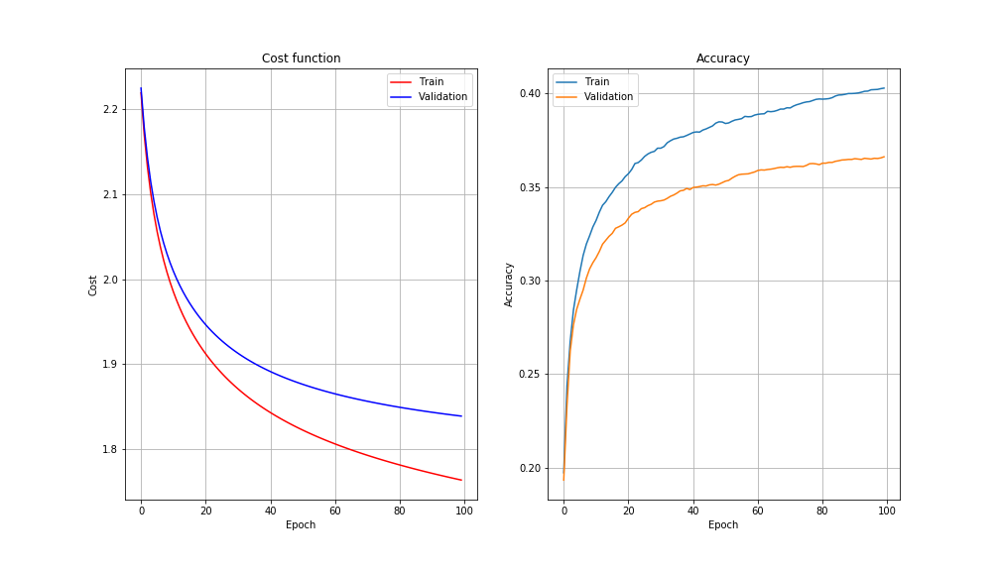

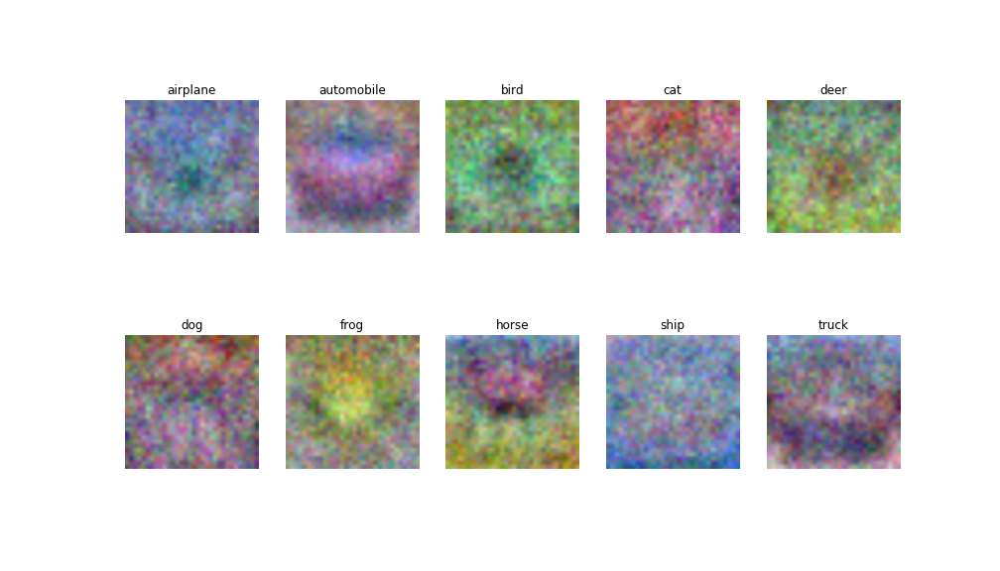

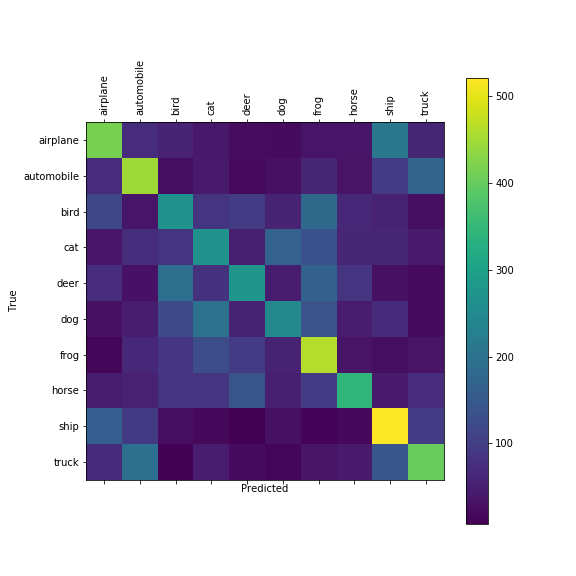

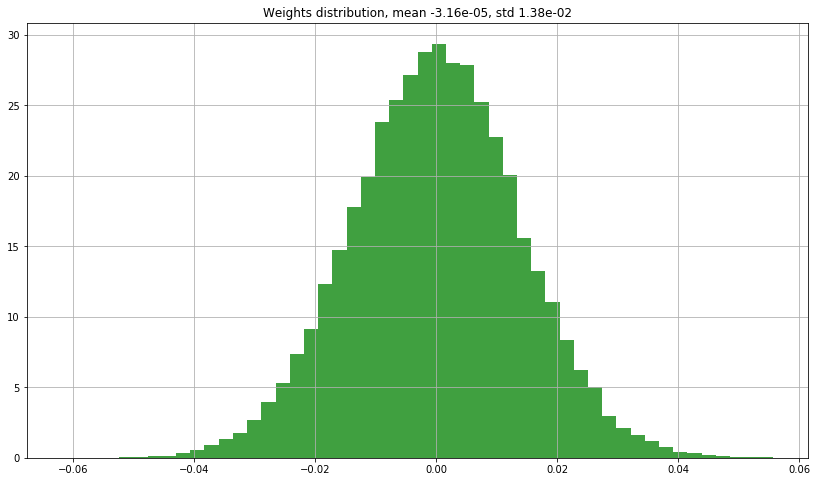

In [20]:
res = report(create_and_train(cifar, training, validation, l=0, epochs=100, 
                              batch_size=500, initial_eta=0.005, train_id='no_reg'))
plot_weights_hist(res['model'].W)

#### With regularization

100%|██████████| 100/100 [01:58<00:00,  1.17s/it]


Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	100
- batch_size	500
- lambda	0.300
- shuffle	False
Training:
- accuracy: 36.160%
- cost:     2.069
Validation:
- accuracy: 34.110%%
- cost:      2.094


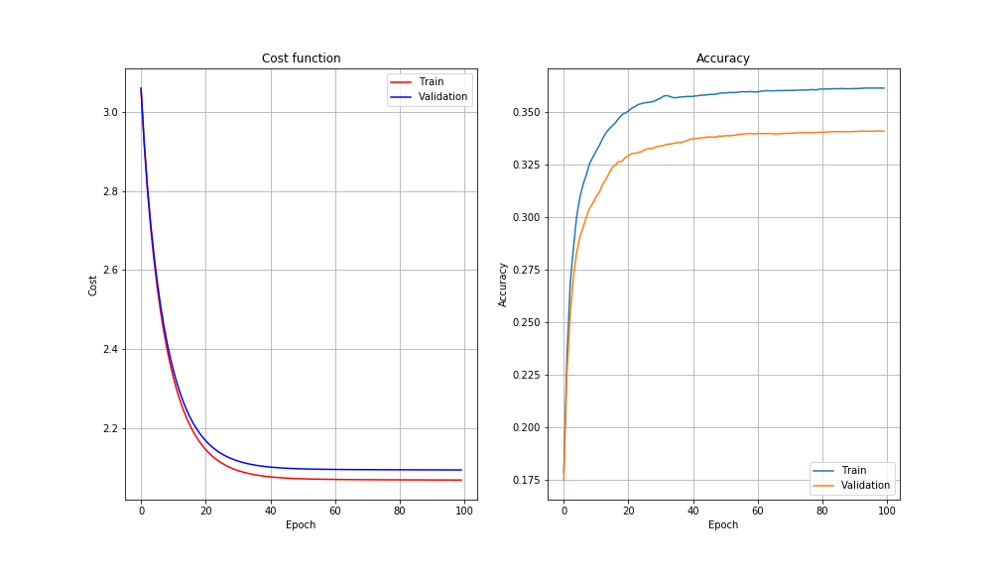

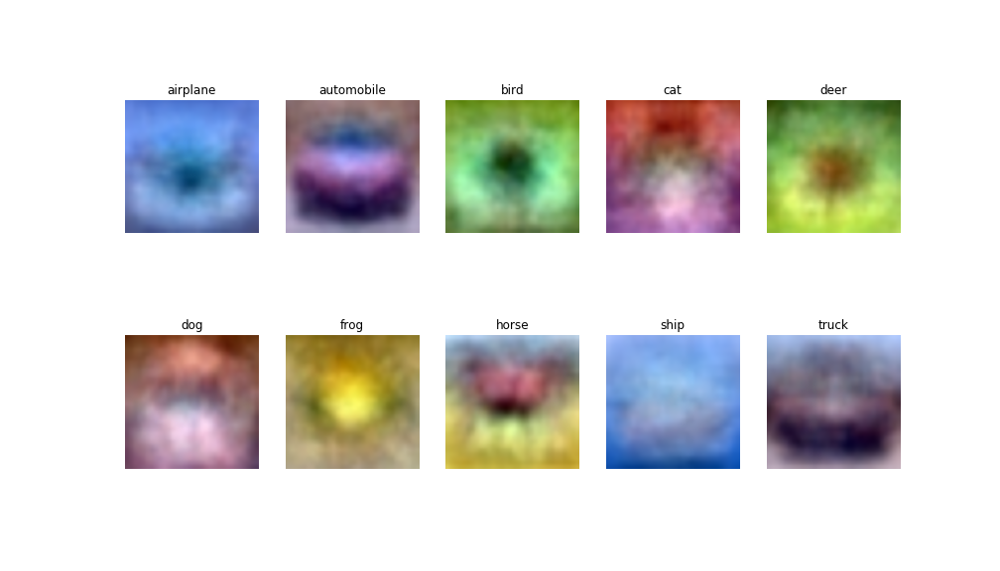

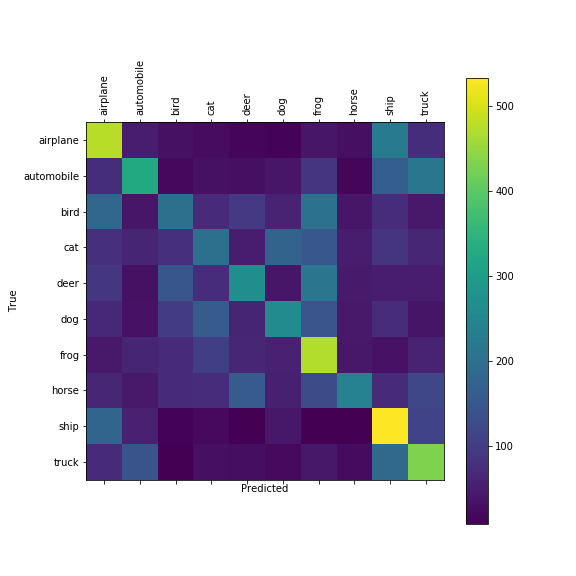

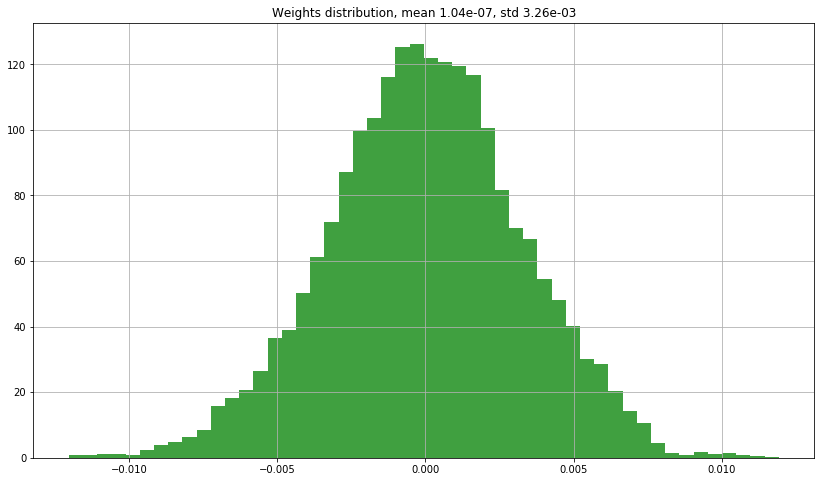

In [21]:
res = report(create_and_train(cifar, training, validation, l=.3, epochs=100, 
                         batch_size=500, initial_eta=0.005, train_id='reg'))
plot_weights_hist(res['model'].W)

## Training with given parameters

As requested, here follow the results obtained with the following settings:

| Lambda | Epochs | Batch size | Eta  |
|--------|--------|------------|------|
| 0      | 40     | 100        | 0.1  |
| 0      | 40     | 100        | 0.01 |
| 0.1    | 40     | 100        | 0.01 |
| 1      | 40     | 100        | 0.01 |

From the first setting, we can observe how a learning rate of 0.1 is too high for the network to learn something.

In the other three we can see the effect of increasing the regularization: initially the gap between training accuracy and validation accuracy is quite large, with a slight regularization the gap reduces (at the expense of an overall lower accuracy), with a heavier regularization said gap is even narrower, but we should let the network train on some more epochs to actually see if it good enough.

In [22]:
%%time
test_params = [
    {'l': 0,   'epochs':  40, 'batch_size': 100, 'initial_eta': .1,  'final_eta': None, 'shuffle': False},
    {'l': 0,   'epochs':  40, 'batch_size': 100, 'initial_eta': .01, 'final_eta': None, 'shuffle': False},
    {'l': 0.1, 'epochs':  40, 'batch_size': 100, 'initial_eta': .01, 'final_eta': None, 'shuffle': False},
    {'l': 1,   'epochs':  40, 'batch_size': 100, 'initial_eta': .01, 'final_eta': None, 'shuffle': False},
]

test_results = [{
        **p, 
        **create_and_train(cifar, training, validation, **p, train_id=i)
    }
    for i, p in enumerate(test_params)]

100%|██████████| 40/40 [00:47<00:00,  1.19s/it]


CPU times: user 3min 19s, sys: 3.89 s, total: 3min 22s
Wall time: 3min 18s


Model trained with:
- initial eta	0.100
- final eta	0.100
- epochs	40
- batch_size	100
- lambda	0.000
- shuffle	False
Training:
- accuracy: 18.320%
- cost:     10.608
Validation:
- accuracy: 16.420%%
- cost:      11.326


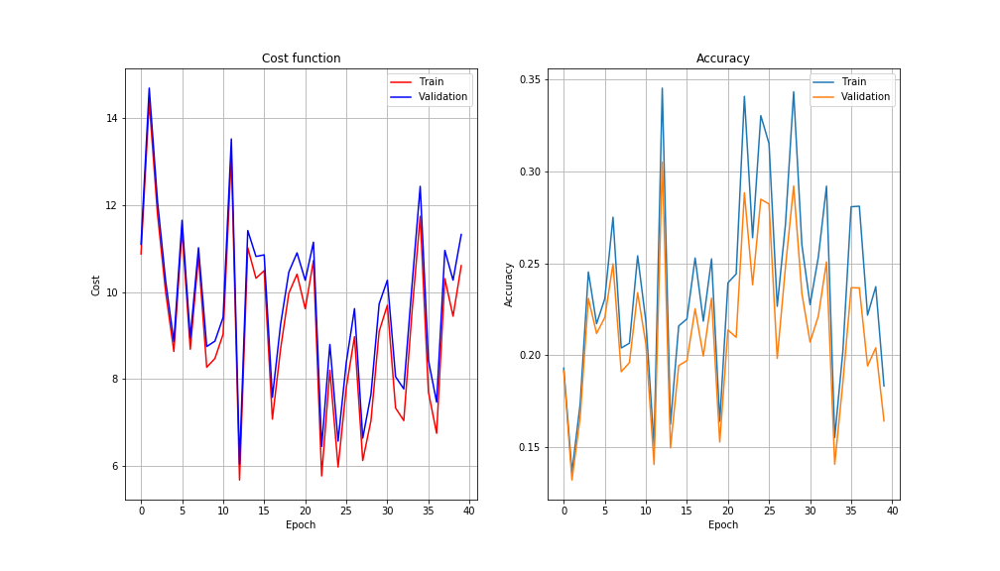

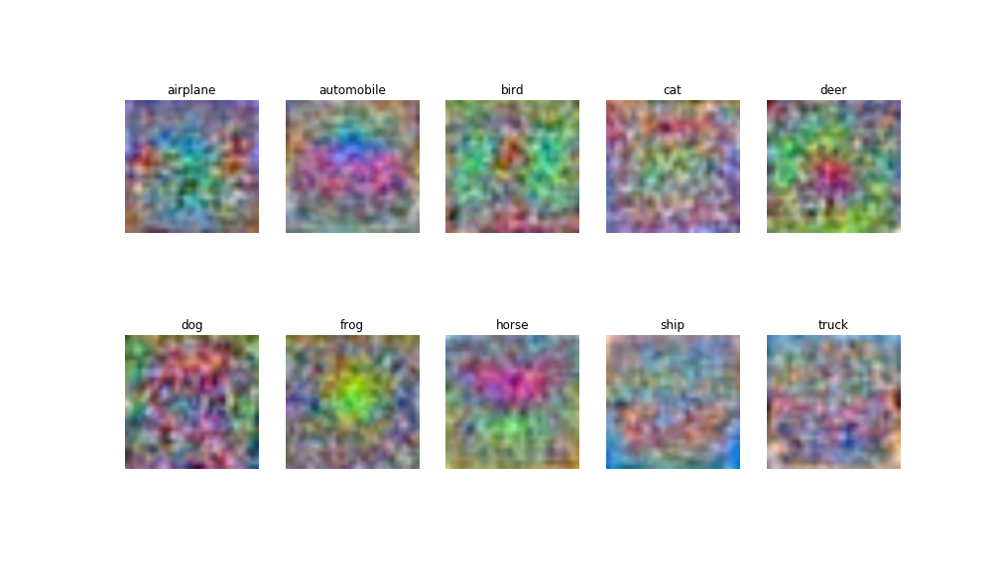

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	40
- batch_size	100
- lambda	0.000
- shuffle	False
Training:
- accuracy: 41.660%
- cost:     1.679
Validation:
- accuracy: 36.520%%
- cost:      1.821


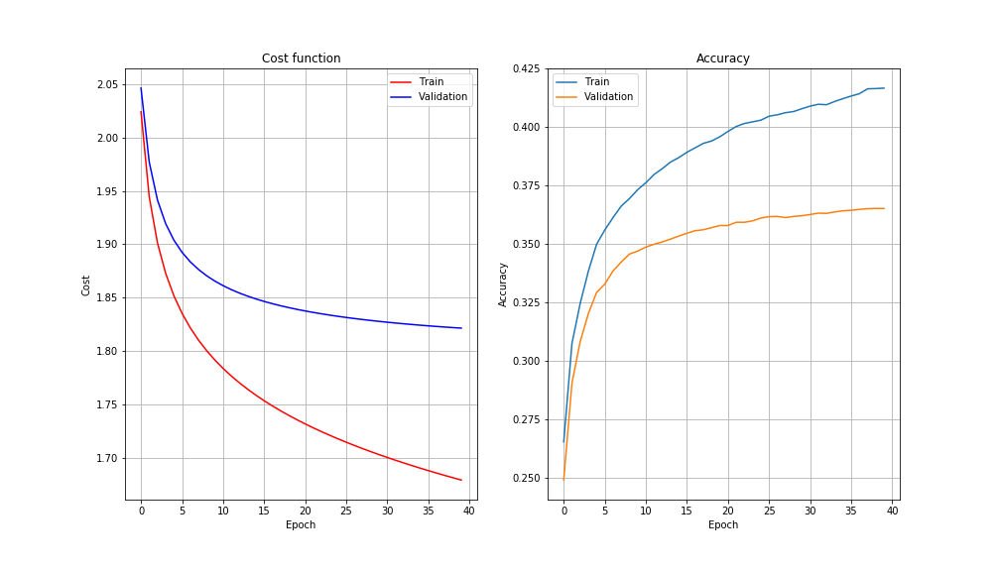

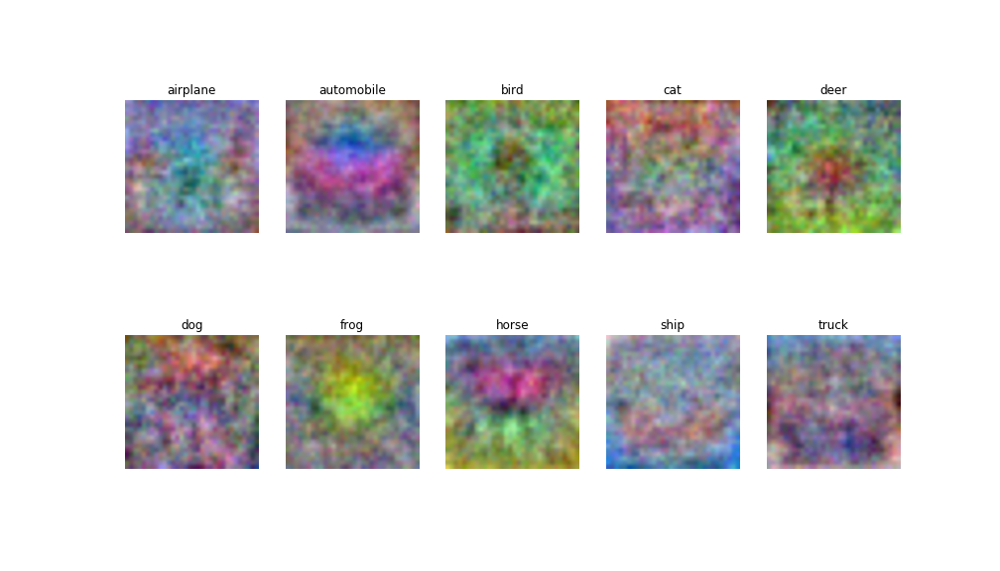

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	40
- batch_size	100
- lambda	0.100
- shuffle	False
Training:
- accuracy: 34.180%
- cost:     1.982
Validation:
- accuracy: 31.980%%
- cost:      2.026


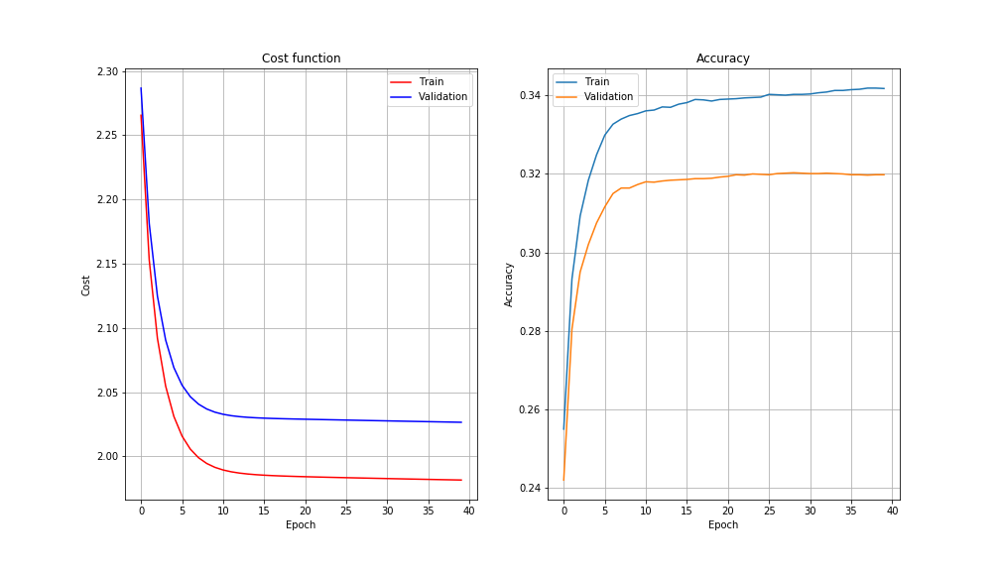

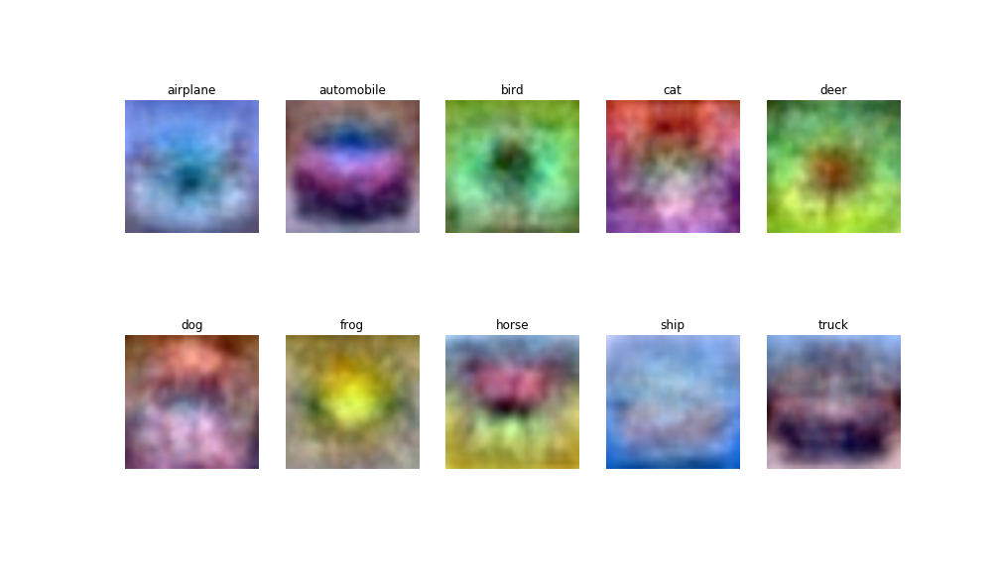

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	40
- batch_size	100
- lambda	1.000
- shuffle	False
Training:
- accuracy: 22.250%
- cost:     2.195
Validation:
- accuracy: 21.280%%
- cost:      2.209


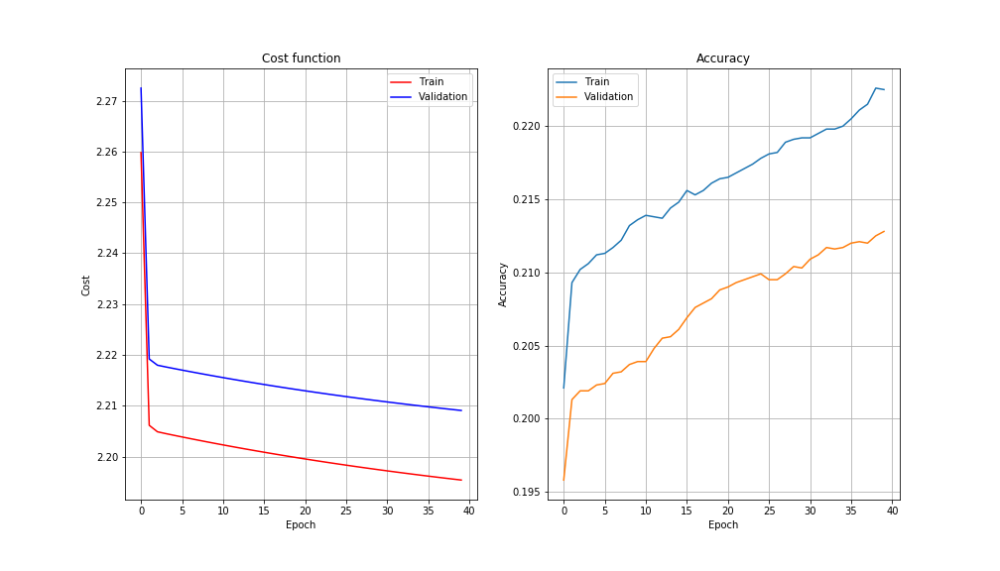

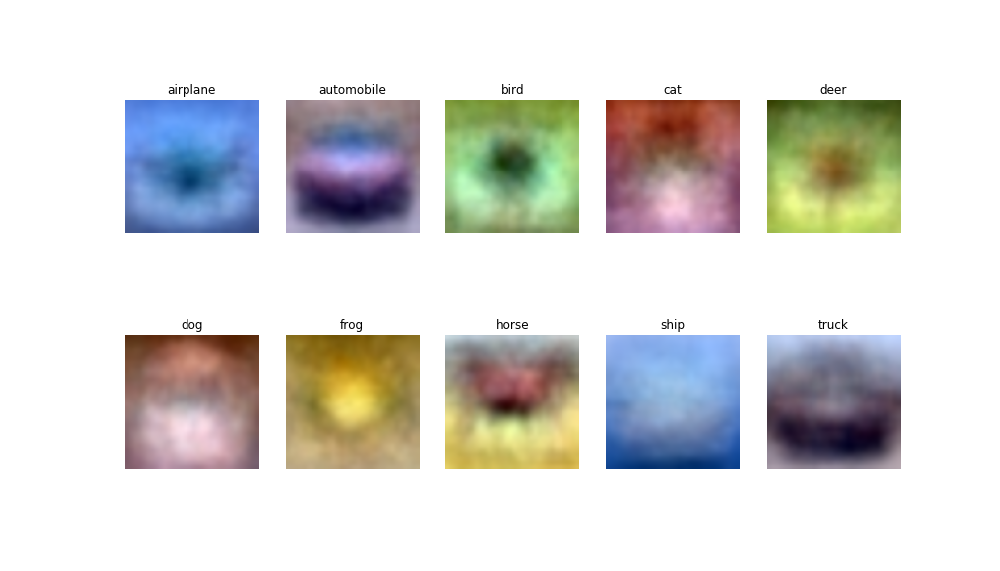

In [23]:
for t in test_results:
    print(t['summary'])
    print(t['cost_accuracy_string'])
    display(Image(t['cost_accuracy_plot']))
    display(Image(t['weight_viz']))

The individual scores on the validation set are summarized here:

In [24]:
df_test = pd.DataFrame(test_results)
df_test.sort_values(by='validation_accuracy', ascending=False, inplace=True)
df_test[['batch_size', 'epochs', 'initial_eta', 'l', 'validation_accuracy']]

,batch_size,epochs,initial_eta,l,validation_accuracy
1,100,40,0.01,0.0,0.3652
2,100,40,0.01,0.1,0.3198
3,100,40,0.01,1.0,0.2128
0,100,40,0.10,0.0,0.1642


## Additional training

We are now going to perform an extensive training procedure using 40000 images for training, 10000 for validation and 10000 for testing. 

We are also introducing some randomness in the order in which every sample is presented to the network at every epoch.

In [25]:
training = cifar.get_batches('data_batch_1', 'data_batch_2', 'data_batch_3', 'data_batch_4')
validation = cifar.get_batches('data_batch_5')
test = cifar.get_batches('test_batch')
    
describe_dataset(training, 'Training:', cifar.labels)
describe_dataset(validation, 'Validation:', cifar.labels)
describe_dataset(test, 'Test:', cifar.labels)

Training:
- total images 40000
- 9.96%  airplane
- 9.96%  automobile
- 10.12%  bird
- 9.96%  cat
- 10.01%  deer
- 9.94%  dog
- 10.05%  frog
- 10.06%  horse
- 9.99%  ship
- 9.95%  truck

Validation:
- total images 10000
- 10.14%  airplane
- 10.14%  automobile
- 9.52%  bird
- 10.16%  cat
- 9.97%  deer
- 10.25%  dog
- 9.80%  frog
- 9.77%  horse
- 10.03%  ship
- 10.22%  truck

Test:
- total images 10000
- 10.00%  airplane
- 10.00%  automobile
- 10.00%  bird
- 10.00%  cat
- 10.00%  deer
- 10.00%  dog
- 10.00%  frog
- 10.00%  horse
- 10.00%  ship
- 10.00%  truck



The values of learning rate, number of epochs, batch size and regularization used above have been manually tuned with the following considerations in mind:

#### Learning rate
Start with a reasonably small value and increment it gradually, checking every time that the accuracy does not get too noisy. In fact, this would be a symptom that we're taking a step too big when updating the gradients, hence missing the minima.

#### Number of epochs
Keep increasing it as long as we see a positive increase in the plots of cost and accuracy.

#### Batch size
Lagom: not too big if the computer can't hold as many samples in memory when computing the gradient of the mini batch, not too small that the network does not see a representative sample of every class in every batch.

#### Regularization
Start small and increase it to improve the generalization performances, i.e. accuracy on validation set goes up. Stop increasing when the general performances of the network degradate.

In [26]:
%%time
test_params = [
    # With fixed learning rate
    {'l': 0,   'epochs': 50, 'batch_size': 200, 'initial_eta': .01 , 'final_eta': None, 'shuffle': False},
    {'l': 0.1, 'epochs': 50, 'batch_size': 200, 'initial_eta': .01 , 'final_eta': None, 'shuffle': False},
    {'l': 0,   'epochs': 50, 'batch_size': 200, 'initial_eta': .005, 'final_eta': None, 'shuffle': False},
    
    {'l': 0,   'epochs': 50, 'batch_size': 250, 'initial_eta': .008, 'final_eta': None, 'shuffle': False},
    {'l': 0.1, 'epochs': 50, 'batch_size': 250, 'initial_eta': .008, 'final_eta': None, 'shuffle': False},
    {'l': 0.3, 'epochs': 50, 'batch_size': 200, 'initial_eta': .005, 'final_eta': None, 'shuffle': False},
    
    {'l': 0,   'epochs': 30, 'batch_size': 500, 'initial_eta': .01 , 'final_eta': None, 'shuffle': False},
    {'l': 0.1, 'epochs': 30, 'batch_size': 500, 'initial_eta': .01 , 'final_eta': None, 'shuffle': False},
    {'l': 0,   'epochs': 50, 'batch_size': 500, 'initial_eta': .005, 'final_eta': None, 'shuffle': False},
    
    {'l': 0,   'epochs': 50, 'batch_size': 500, 'initial_eta': .008, 'final_eta': None, 'shuffle': False},
    {'l': 0.1, 'epochs': 50, 'batch_size': 500, 'initial_eta': .008, 'final_eta': None, 'shuffle': False},
    {'l': 0.3, 'epochs': 50, 'batch_size': 500, 'initial_eta': .005, 'final_eta': None, 'shuffle': False},
    
    # With fixed learning rate and shuffling
    {'l': 0,   'epochs': 50, 'batch_size': 200, 'initial_eta': .01 , 'final_eta': None, 'shuffle': True},
    {'l': 0.1, 'epochs': 50, 'batch_size': 200, 'initial_eta': .01 , 'final_eta': None, 'shuffle': True},
    {'l': 0,   'epochs': 50, 'batch_size': 200, 'initial_eta': .005, 'final_eta': None, 'shuffle': True},
    
    {'l': 0,   'epochs': 50, 'batch_size': 250, 'initial_eta': .008, 'final_eta': None, 'shuffle': True},
    {'l': 0.1, 'epochs': 50, 'batch_size': 250, 'initial_eta': .008, 'final_eta': None, 'shuffle': True},
    {'l': 0.3, 'epochs': 50, 'batch_size': 200, 'initial_eta': .005, 'final_eta': None, 'shuffle': True},
    
    {'l': 0,   'epochs': 30, 'batch_size': 500, 'initial_eta': .01 , 'final_eta': None, 'shuffle': True},
    {'l': 0.1, 'epochs': 30, 'batch_size': 500, 'initial_eta': .01 , 'final_eta': None, 'shuffle': True},
    {'l': 0,   'epochs': 50, 'batch_size': 500, 'initial_eta': .005, 'final_eta': None, 'shuffle': True},
    
    {'l': 0,   'epochs': 50, 'batch_size': 500, 'initial_eta': .008, 'final_eta': None, 'shuffle': True},
    {'l': 0.1, 'epochs': 50, 'batch_size': 500, 'initial_eta': .008, 'final_eta': None, 'shuffle': True},
    {'l': 0.3, 'epochs': 50, 'batch_size': 500, 'initial_eta': .005, 'final_eta': None, 'shuffle': True},

    # With linearly decaying learning rate
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': False},
    
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': False},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': False},
    
    # With linearly decaying learning rate and shuffling
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0,    'epochs': 50, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 500, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0005, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .05, 'final_eta': .0001, 'shuffle': True},
    
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0,    'epochs': 50, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.01, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.05, 'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0005, 'shuffle': True},
    {'l': 0.1,  'epochs': 70, 'batch_size': 1000, 'initial_eta': .1,  'final_eta': .0001, 'shuffle': True},  
]

df = pd.DataFrame([{
        **p, 
        **create_and_train(cifar, training, validation, **p, train_id=i)
    } 
    for i, p in enumerate(test_params)])

100%|██████████| 70/70 [05:20<00:00,  4.58s/it]


CPU times: user 6h 45min 26s, sys: 1min 32s, total: 6h 46min 59s
Wall time: 6h 45min 14s


Here is a summary of the models trained.

In [27]:
df.sort_values(by='validation_accuracy', ascending=False, inplace=True)
display(HTML(df[['batch_size', 'epochs', 'initial_eta', 'final_eta', 'l',
                 'shuffle', 'validation_accuracy']].to_html()))

,batch_size,epochs,initial_eta,final_eta,l,shuffle,validation_accuracy
65,500,50,0.100,0.0001,0.00,True,0.4077
32,500,50,0.100,0.0005,0.00,False,0.4069
64,500,50,0.100,0.0005,0.00,True,0.4066
33,500,50,0.100,0.0001,0.00,False,0.4063
25,500,50,0.050,0.0001,0.00,False,0.4033
57,500,50,0.050,0.0001,0.00,True,0.4033
49,1000,50,0.100,0.0001,0.00,False,0.4027
24,500,50,0.050,0.0005,0.00,False,0.4022
48,1000,50,0.100,0.0005,0.00,False,0.4014
56,500,50,0.050,0.0005,0.00,True,0.4009


Cost, accuracy and weight visualization of models, ordered in descending accuracy on the validations set.

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 44.390%
- cost:     1.643
Validation:
- accuracy: 40.770%%
- cost:      1.740


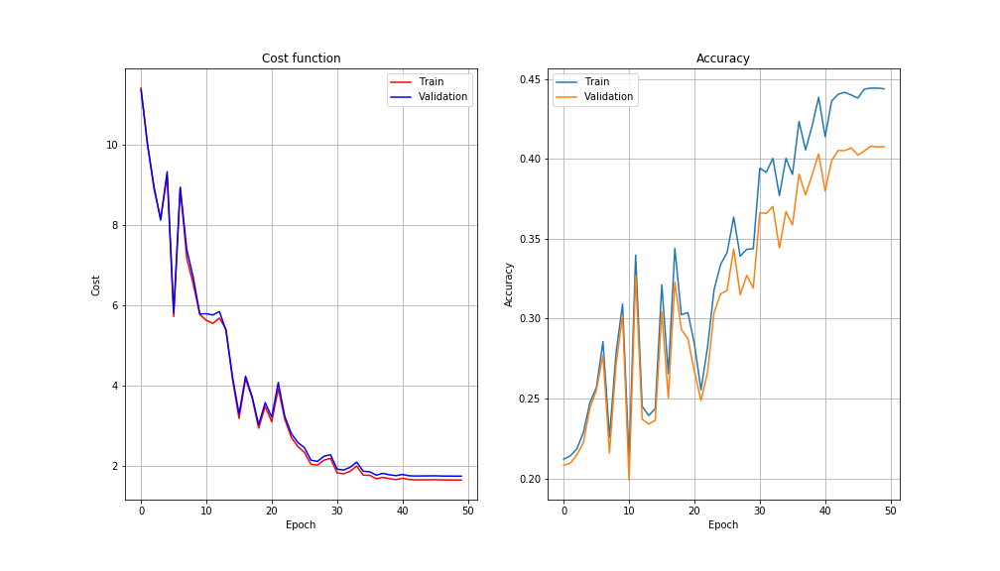

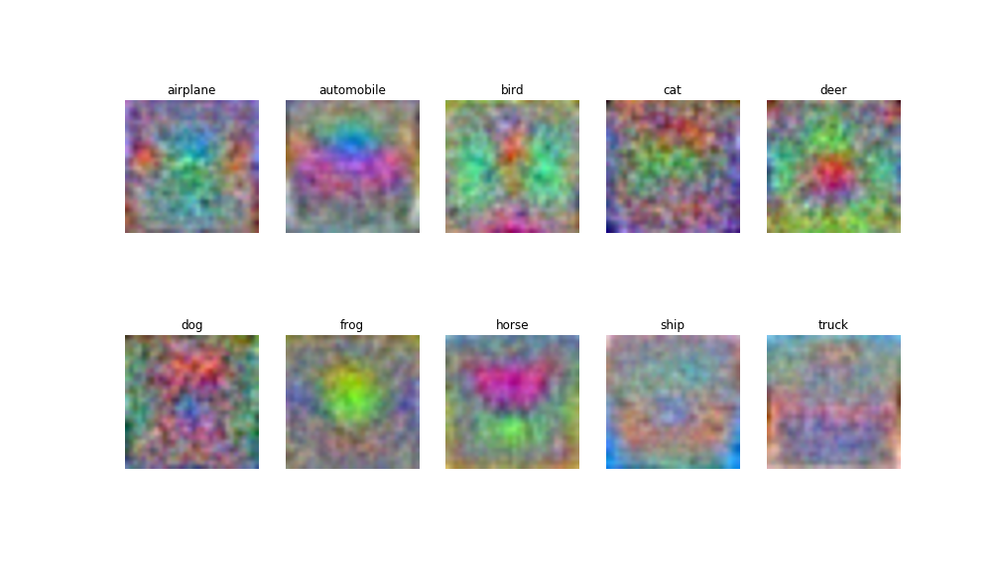

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 44.362%
- cost:     1.643
Validation:
- accuracy: 40.690%%
- cost:      1.741


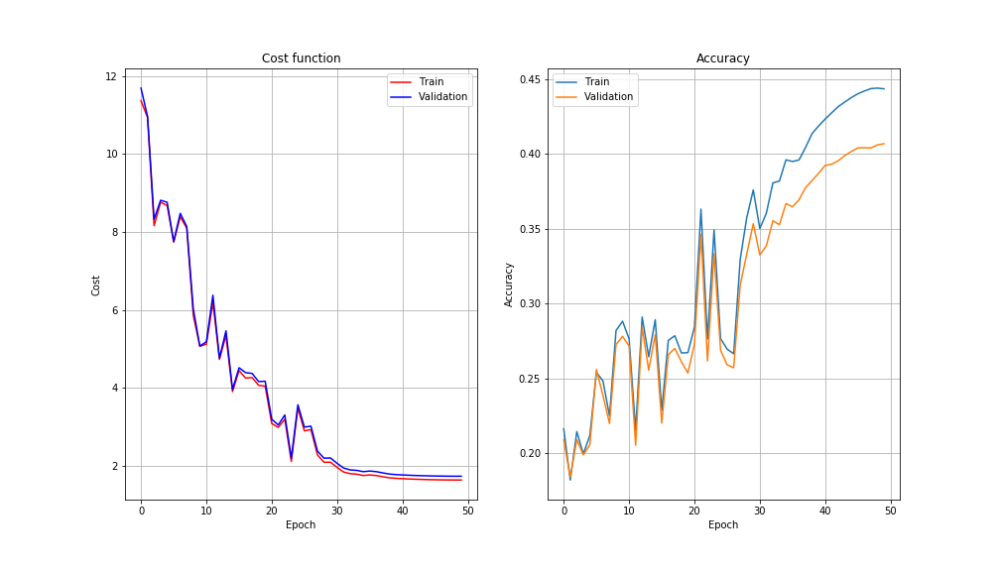

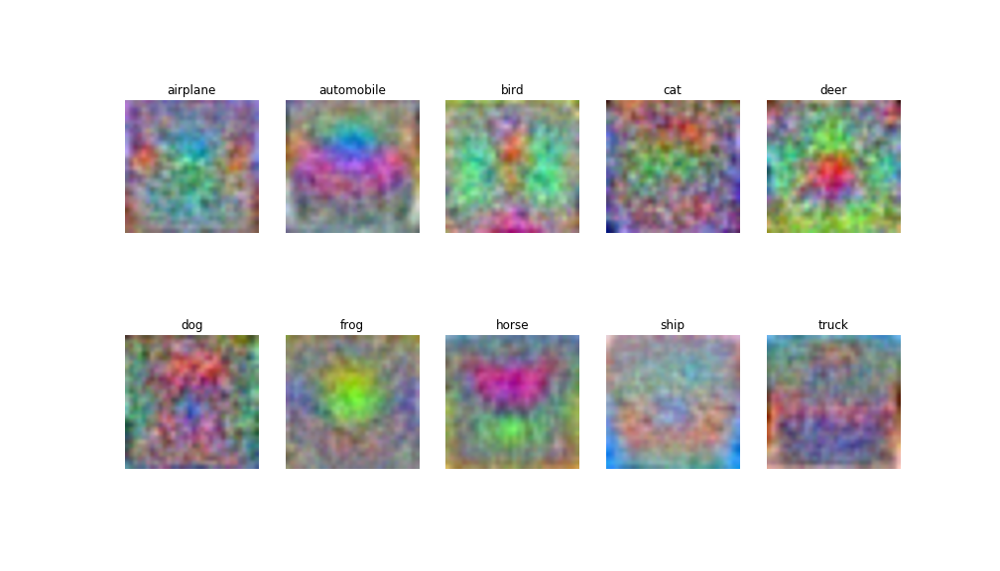

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 44.488%
- cost:     1.643
Validation:
- accuracy: 40.660%%
- cost:      1.740


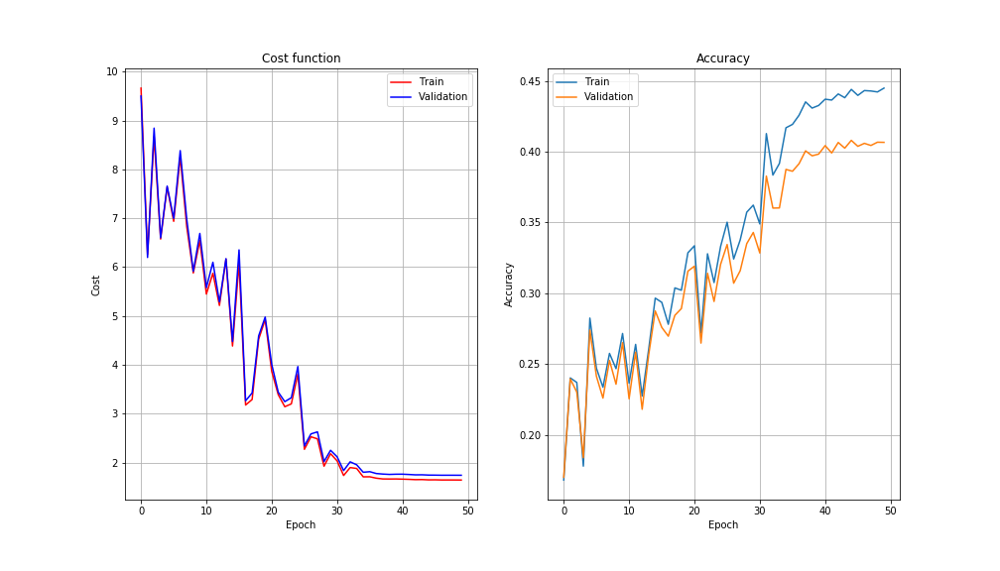

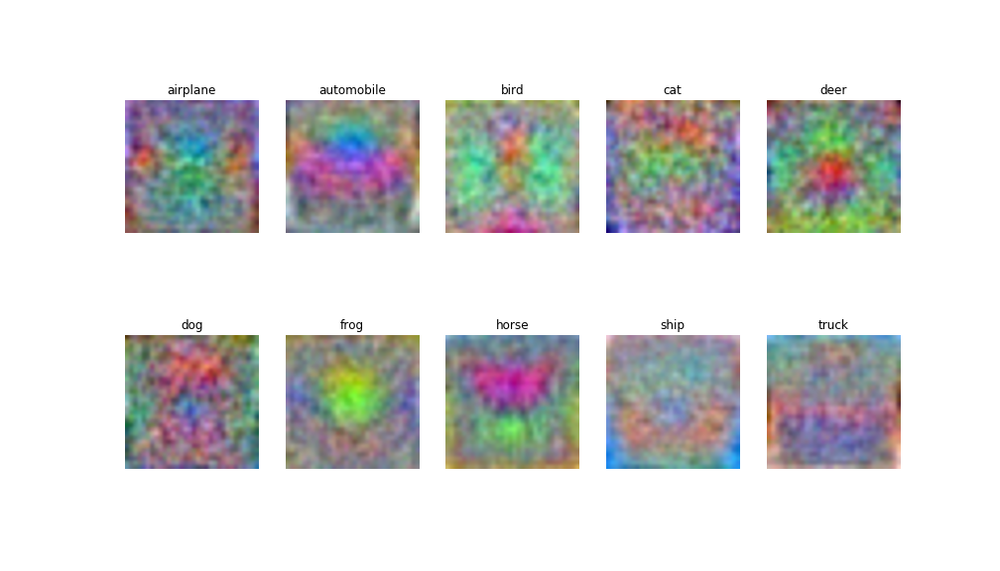

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 44.465%
- cost:     1.643
Validation:
- accuracy: 40.630%%
- cost:      1.741


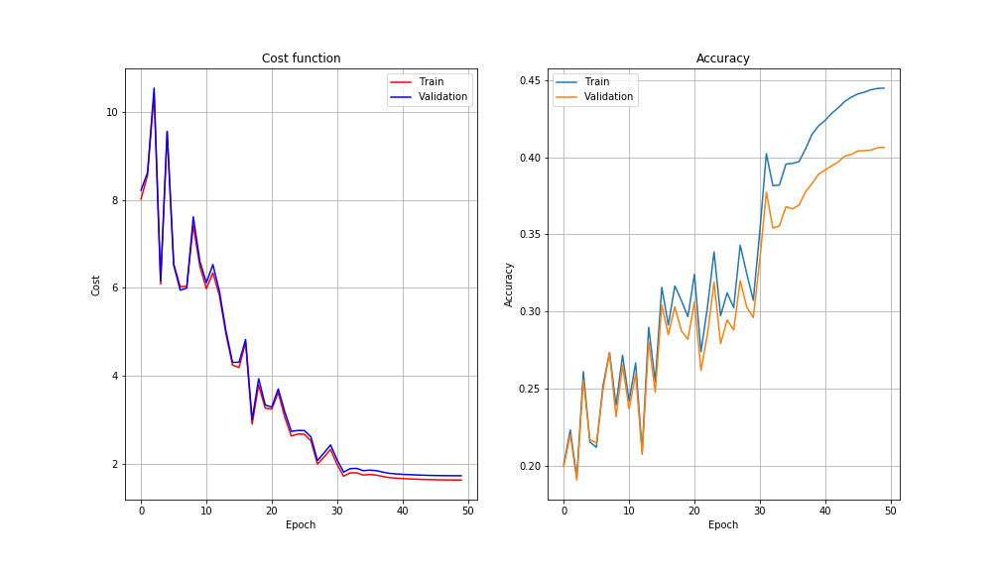

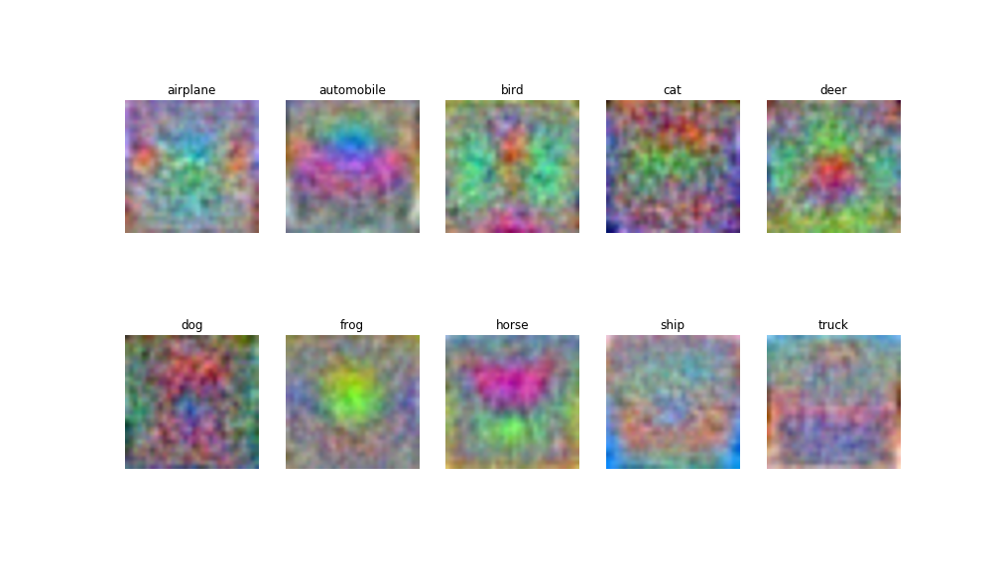

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 43.375%
- cost:     1.675
Validation:
- accuracy: 40.330%%
- cost:      1.744


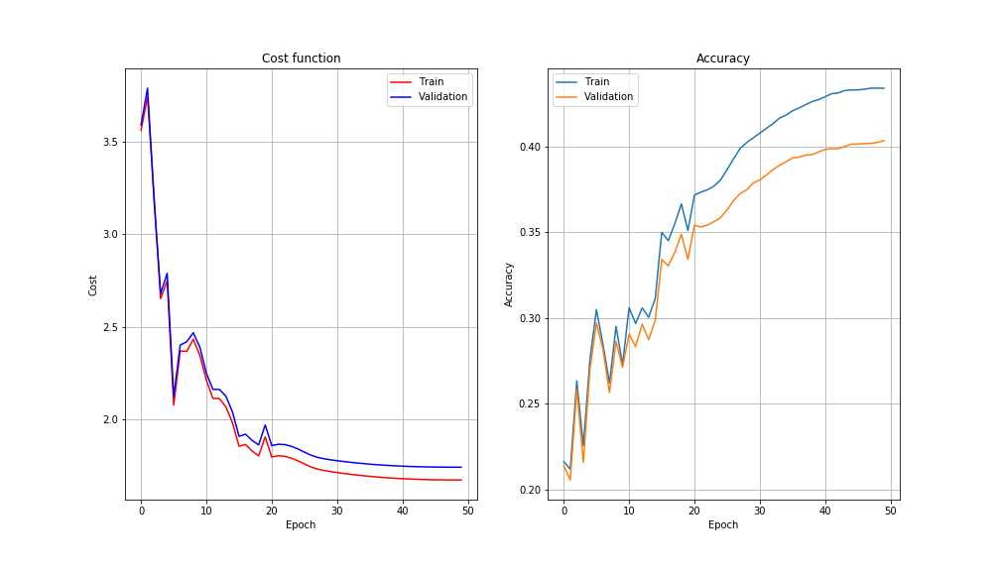

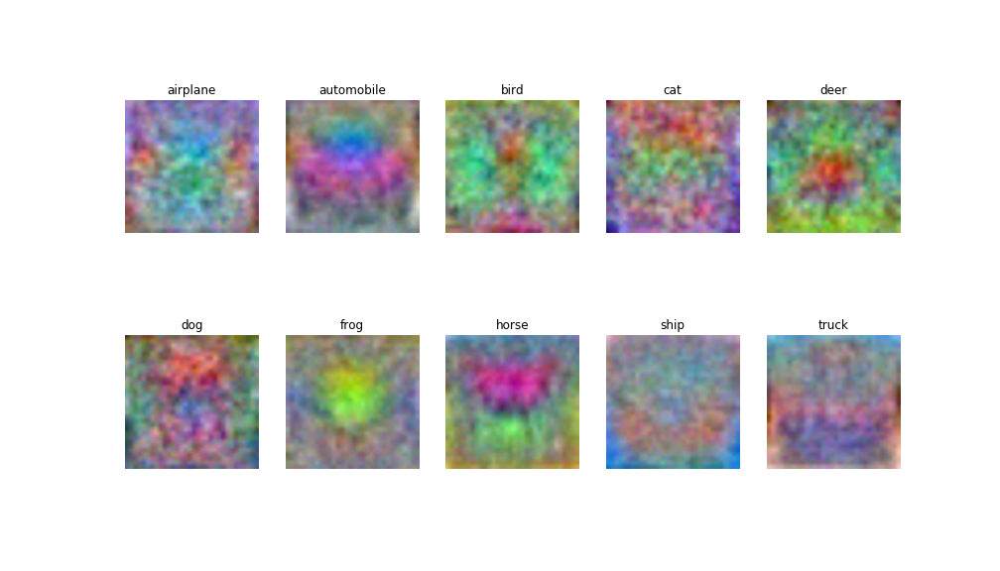

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 43.370%
- cost:     1.674
Validation:
- accuracy: 40.330%%
- cost:      1.743


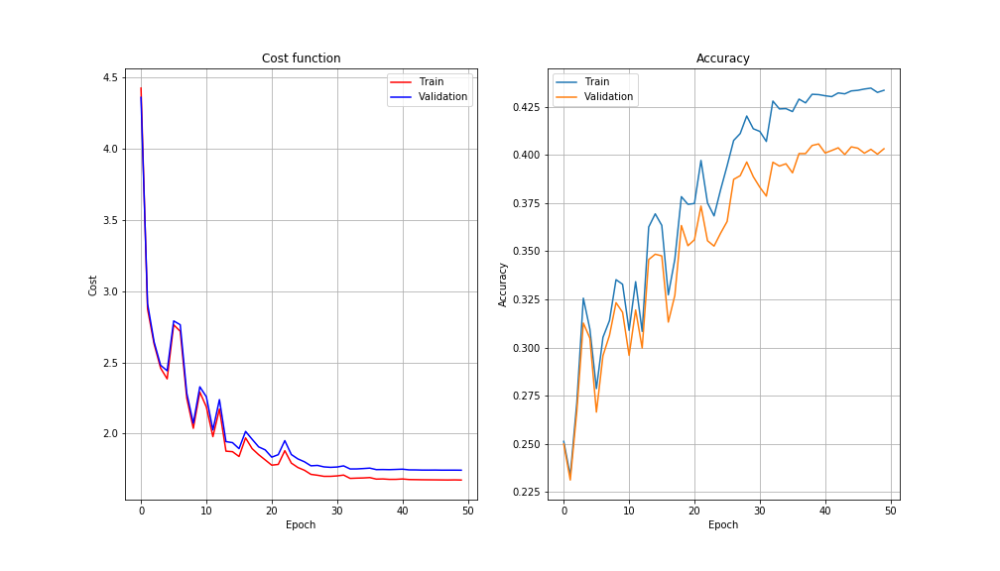

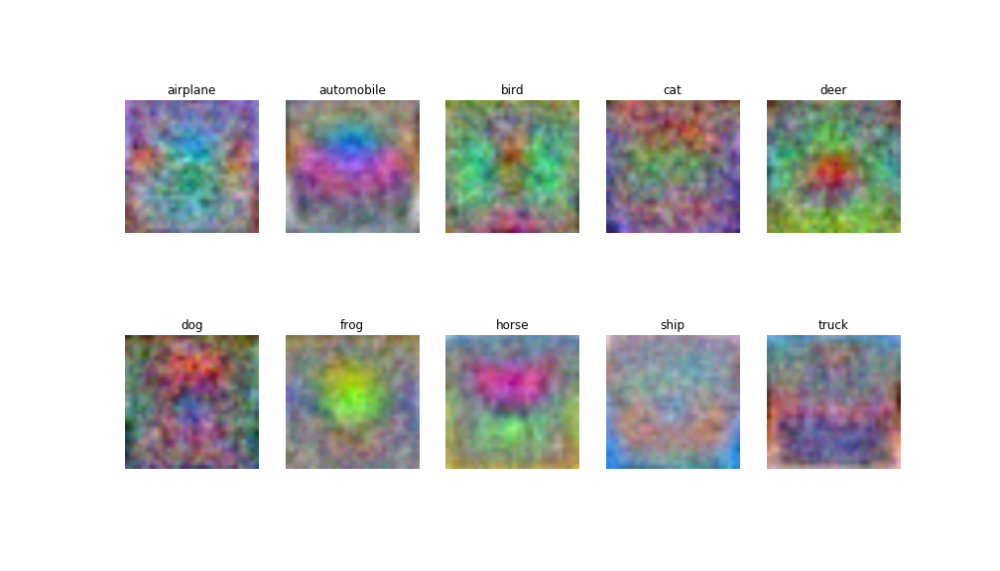

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	False
Training:
- accuracy: 43.352%
- cost:     1.674
Validation:
- accuracy: 40.270%%
- cost:      1.747


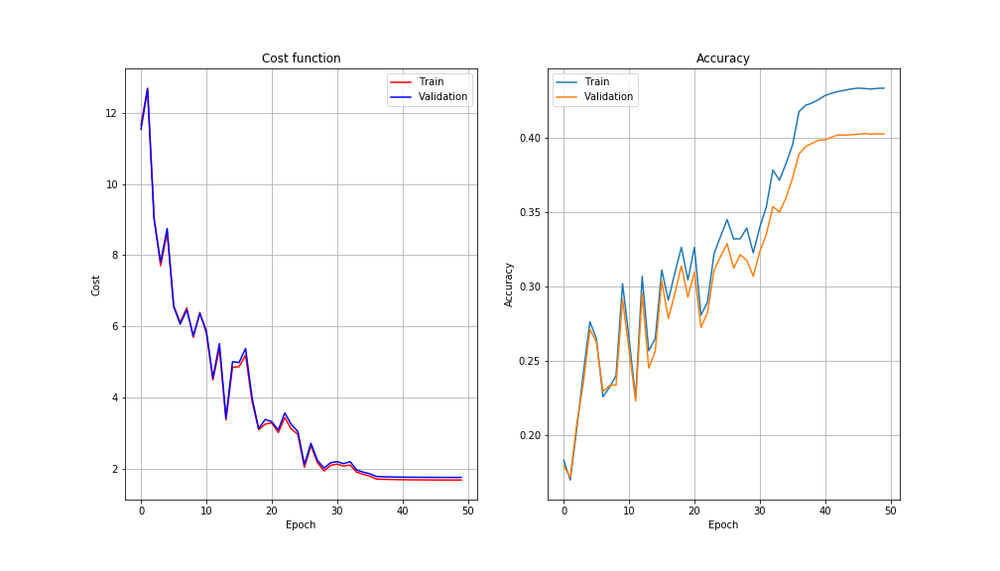

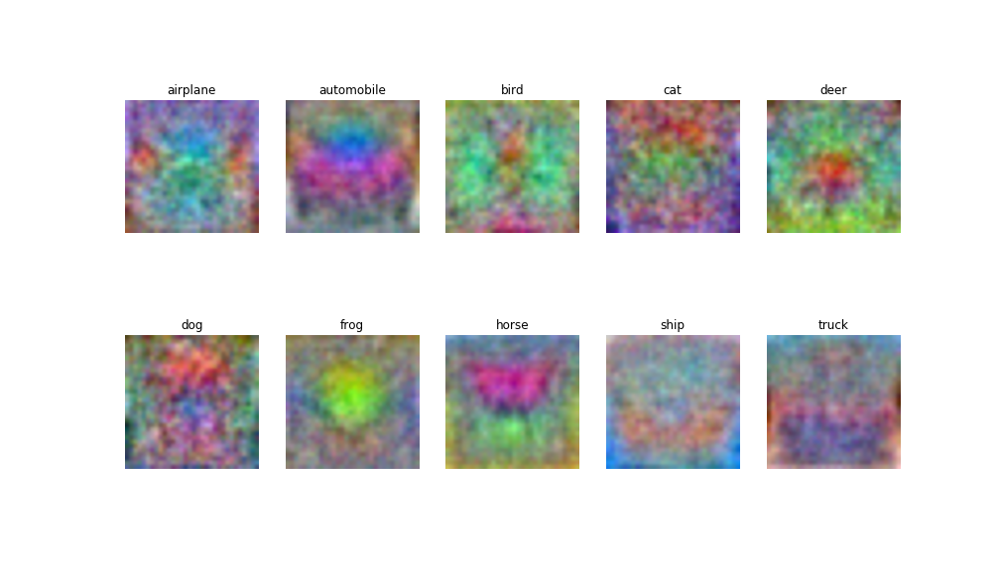

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 43.297%
- cost:     1.674
Validation:
- accuracy: 40.220%%
- cost:      1.743


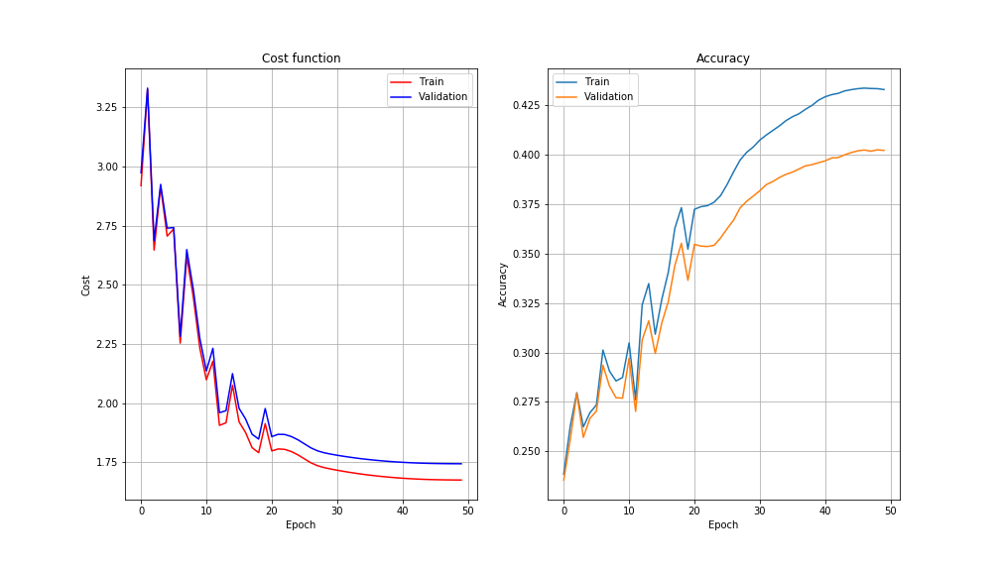

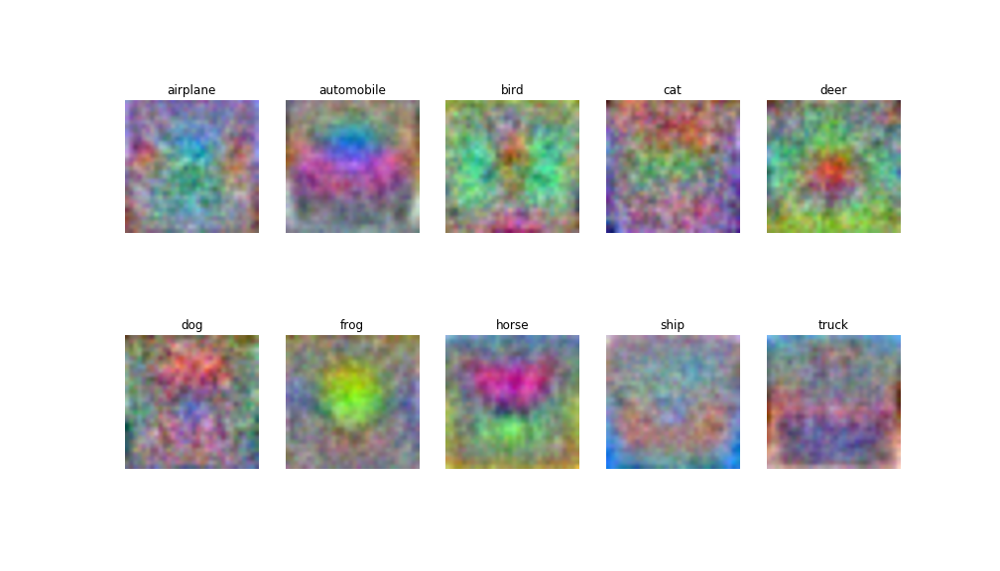

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	False
Training:
- accuracy: 43.297%
- cost:     1.674
Validation:
- accuracy: 40.140%%
- cost:      1.746


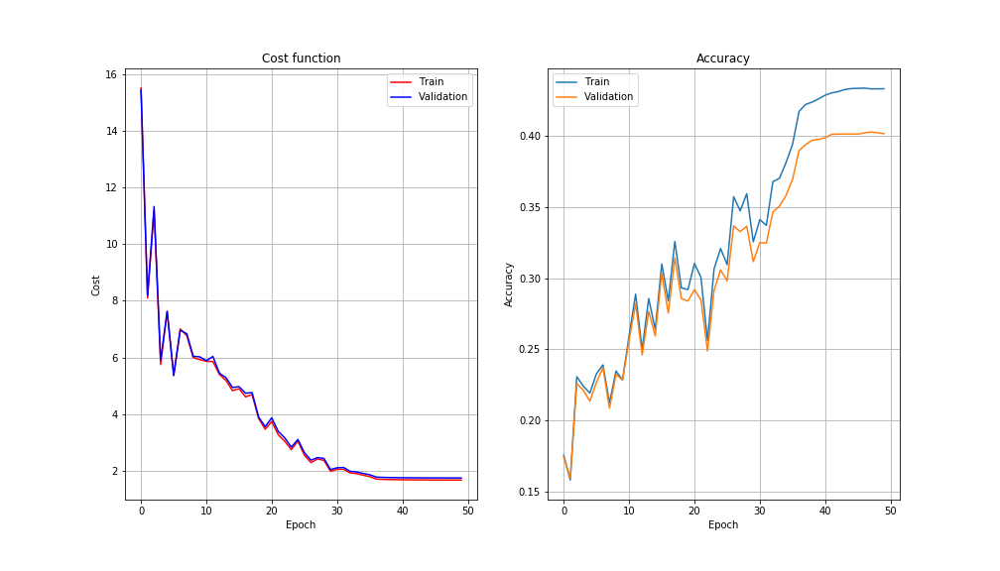

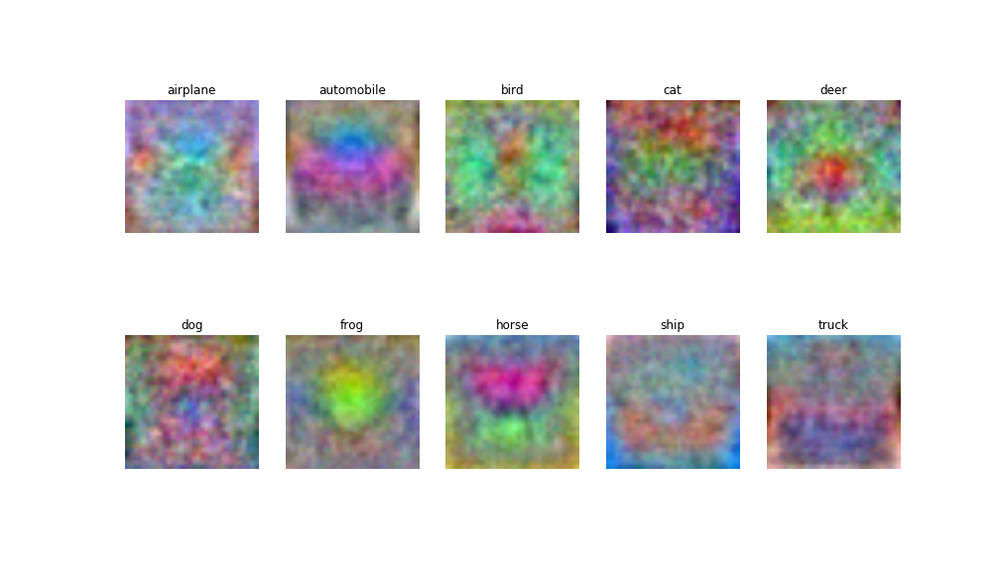

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 43.282%
- cost:     1.674
Validation:
- accuracy: 40.090%%
- cost:      1.743


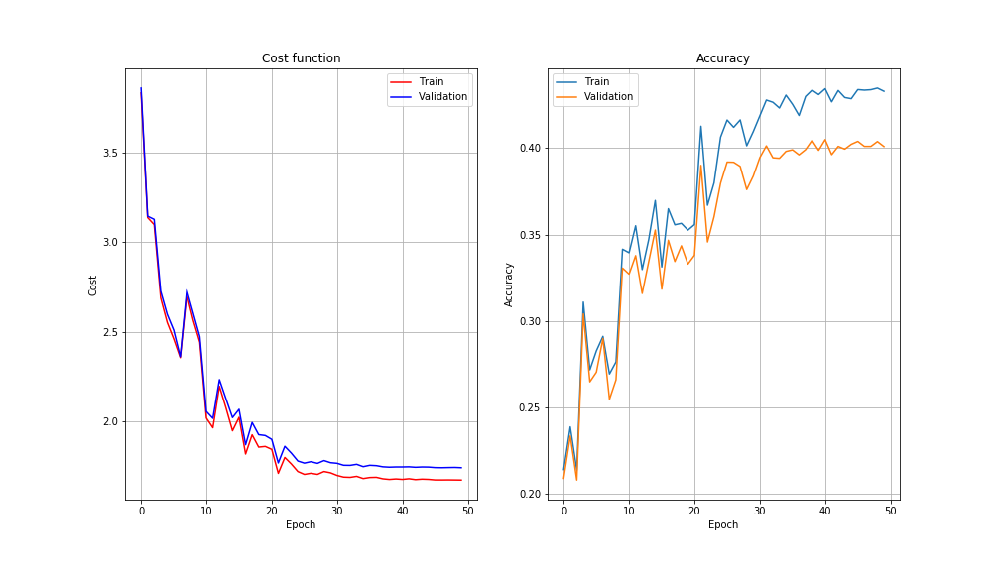

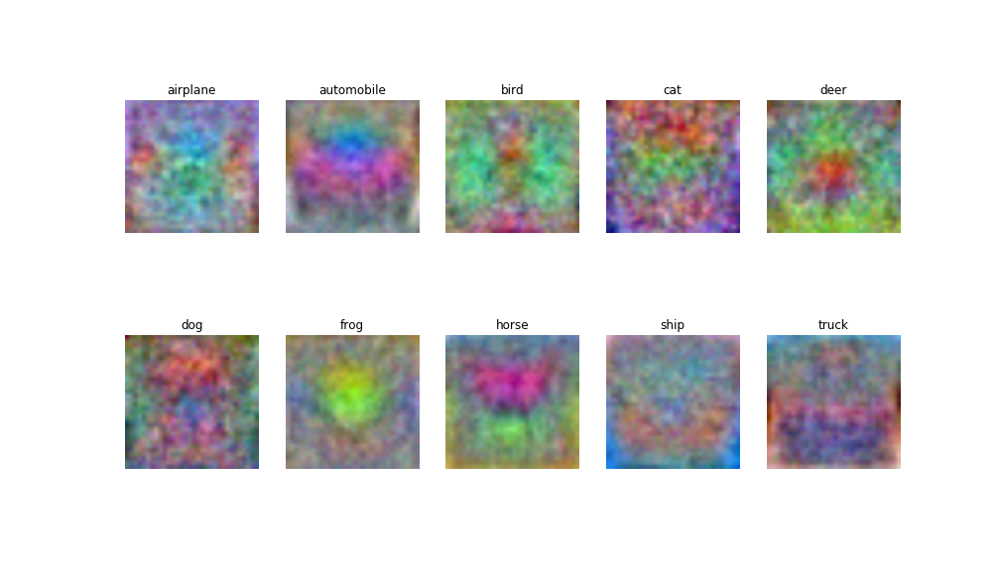

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	True
Training:
- accuracy: 43.282%
- cost:     1.673
Validation:
- accuracy: 40.080%%
- cost:      1.747


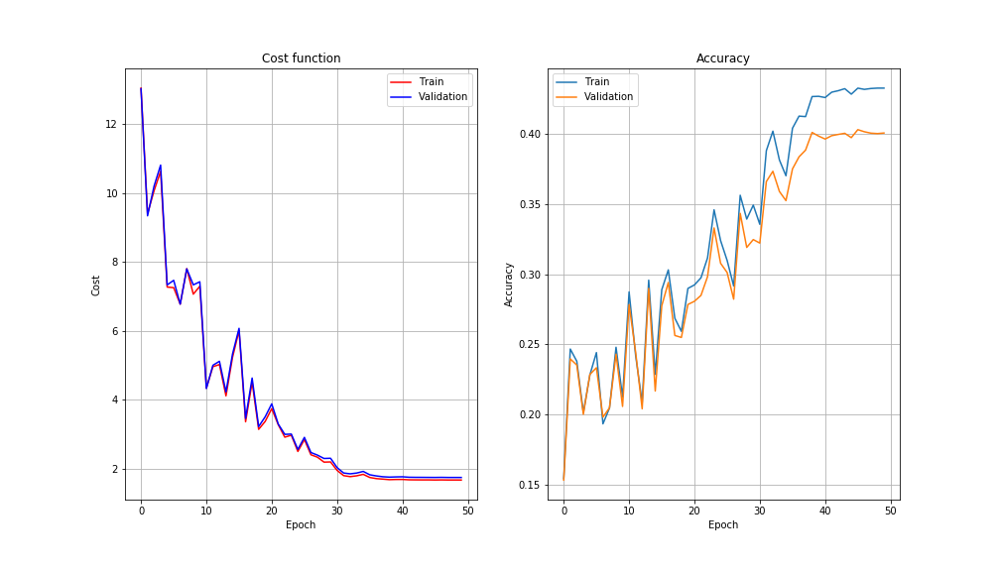

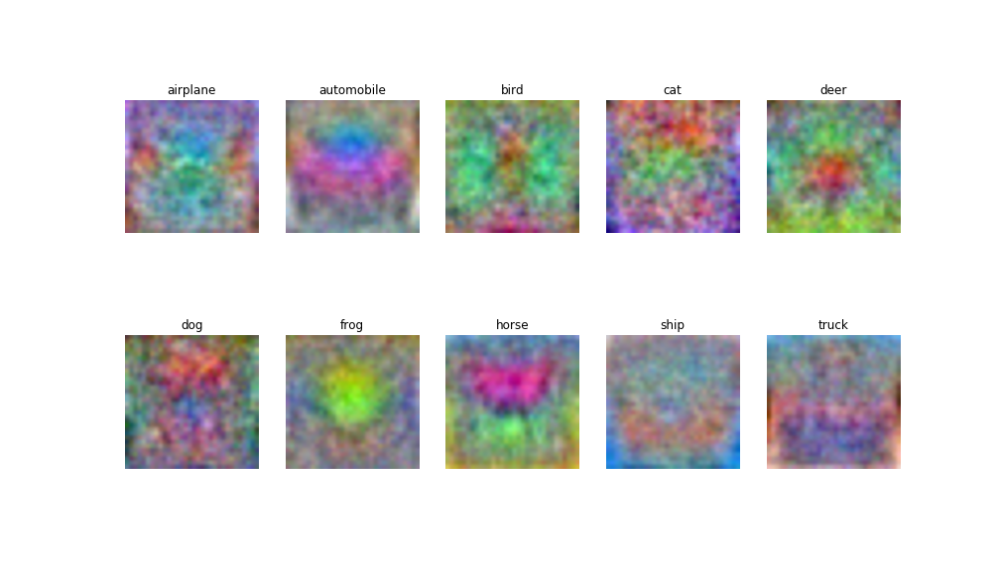

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	True
Training:
- accuracy: 42.210%
- cost:     1.782
Validation:
- accuracy: 40.070%%
- cost:      1.825


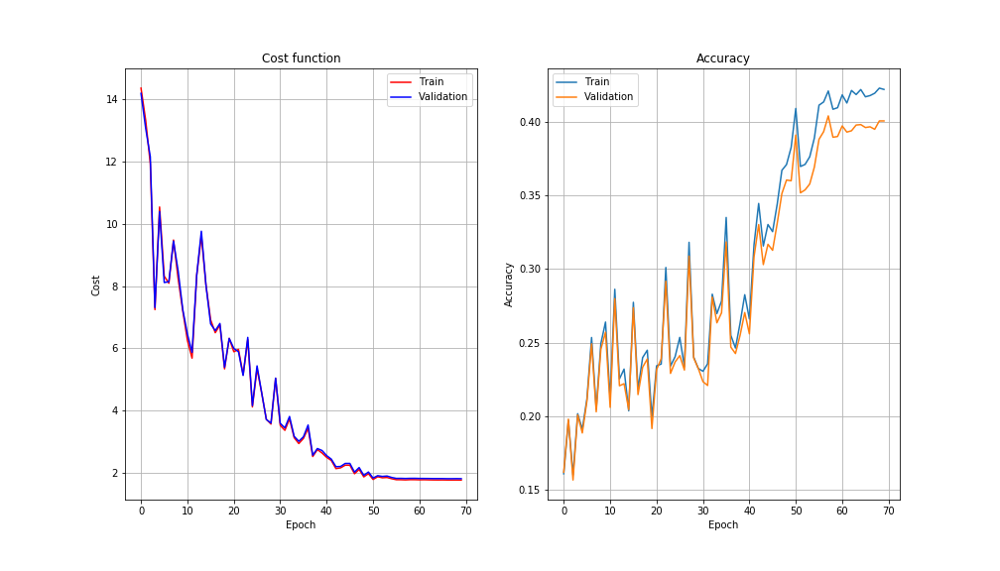

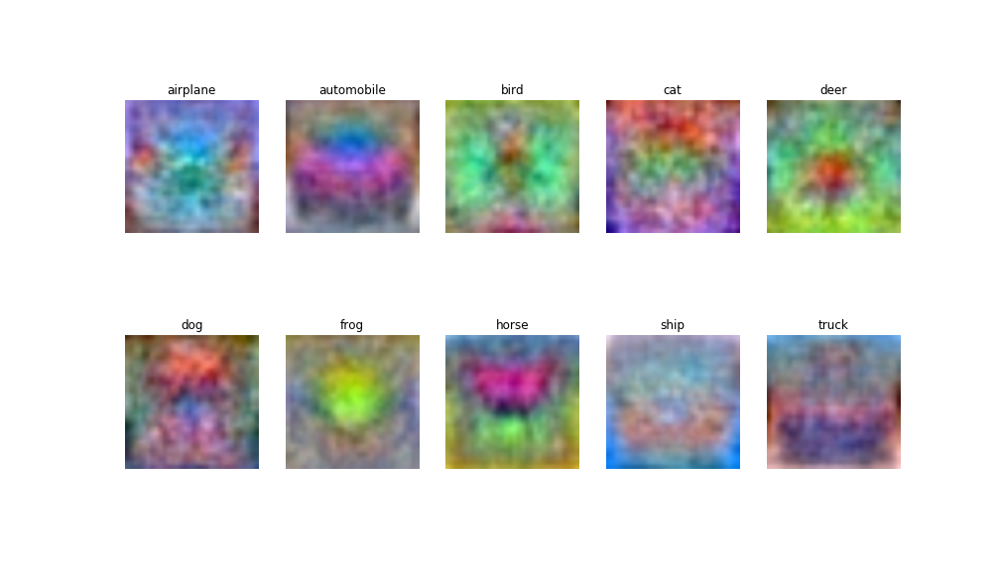

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	True
Training:
- accuracy: 43.255%
- cost:     1.673
Validation:
- accuracy: 40.070%%
- cost:      1.746


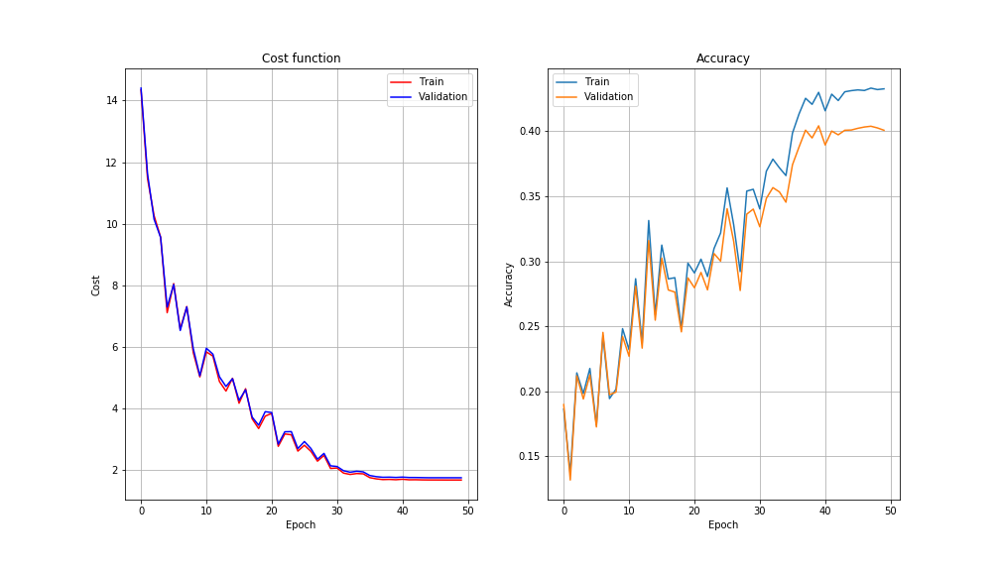

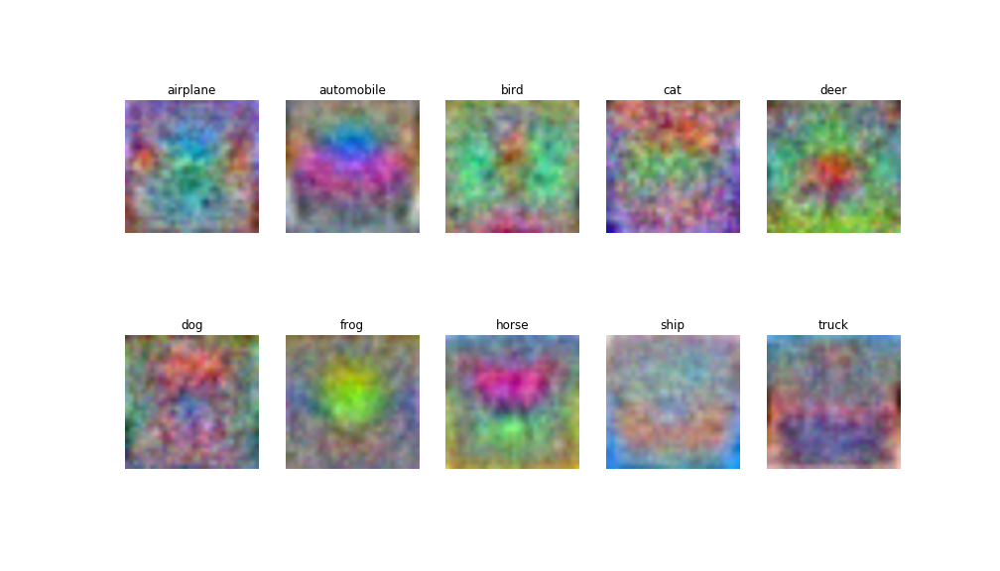

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	50
- batch_size	200
- lambda	0.000
- shuffle	True
Training:
- accuracy: 42.650%
- cost:     1.683
Validation:
- accuracy: 39.840%%
- cost:      1.751


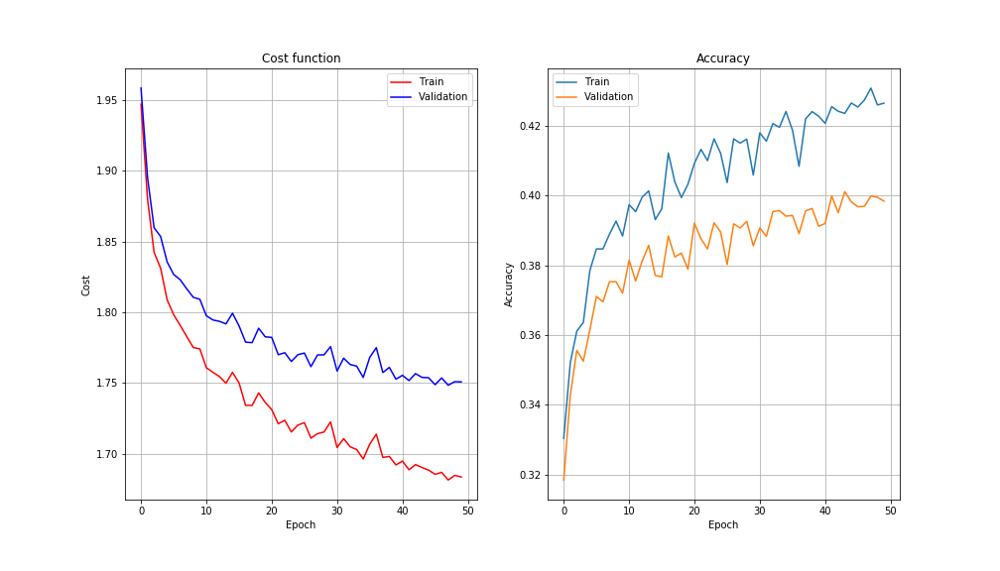

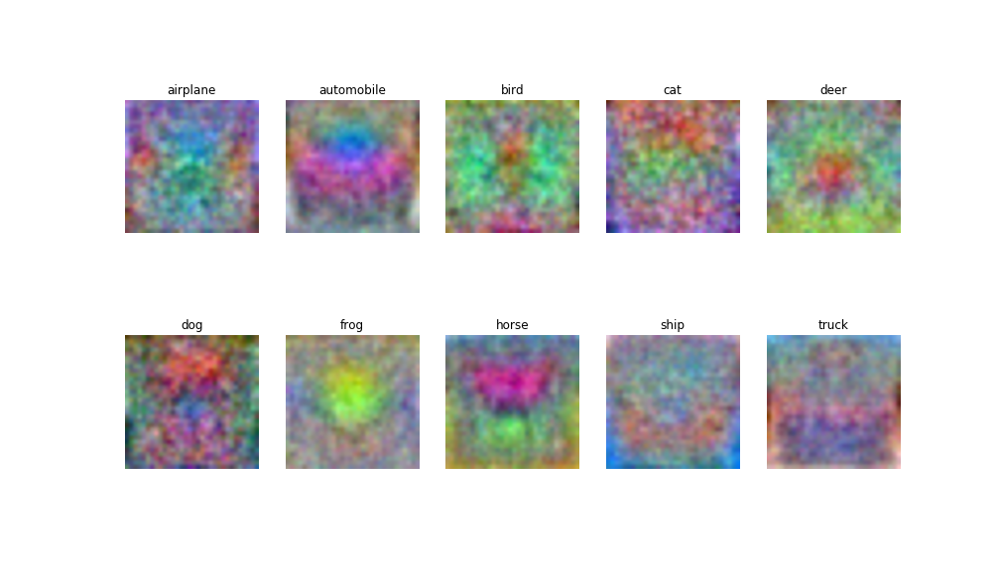

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.218%
- cost:     1.782
Validation:
- accuracy: 39.820%%
- cost:      1.824


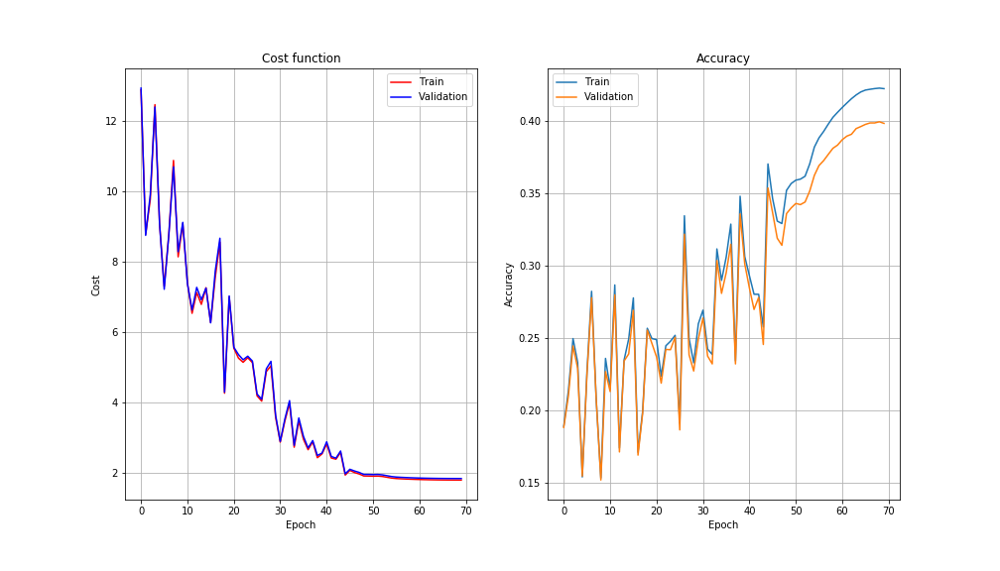

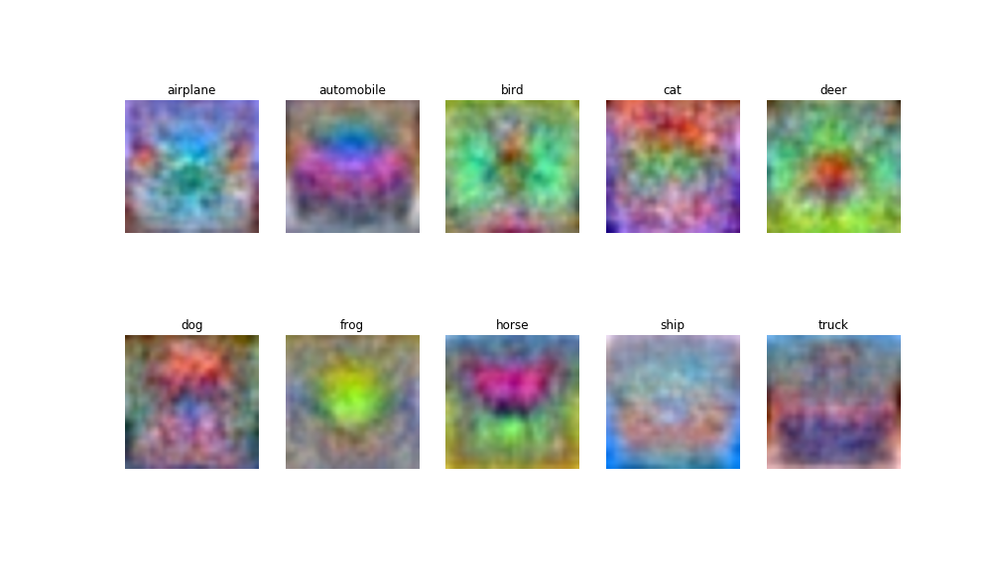

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.197%
- cost:     1.782
Validation:
- accuracy: 39.810%%
- cost:      1.825


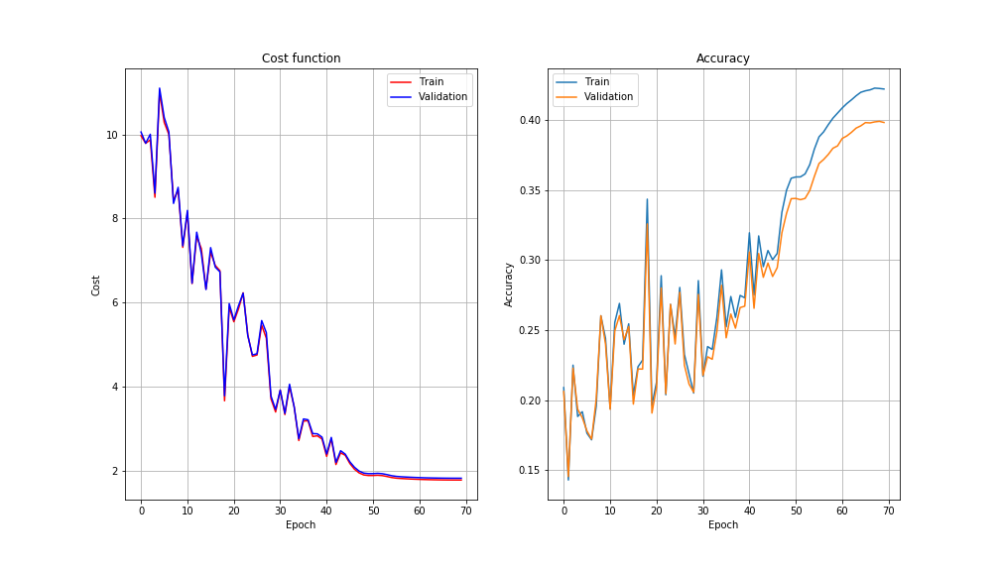

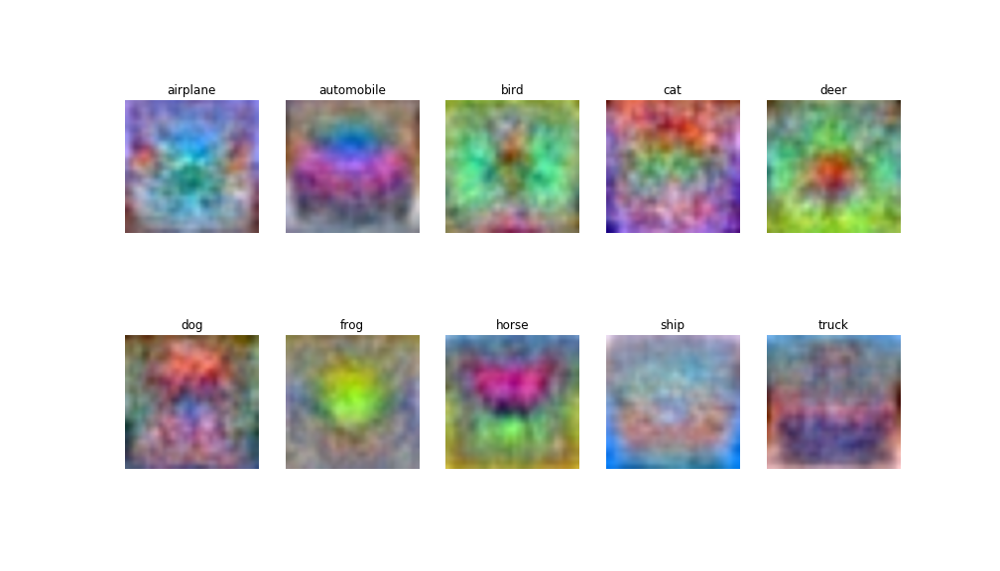

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	True
Training:
- accuracy: 42.150%
- cost:     1.786
Validation:
- accuracy: 39.770%%
- cost:      1.830


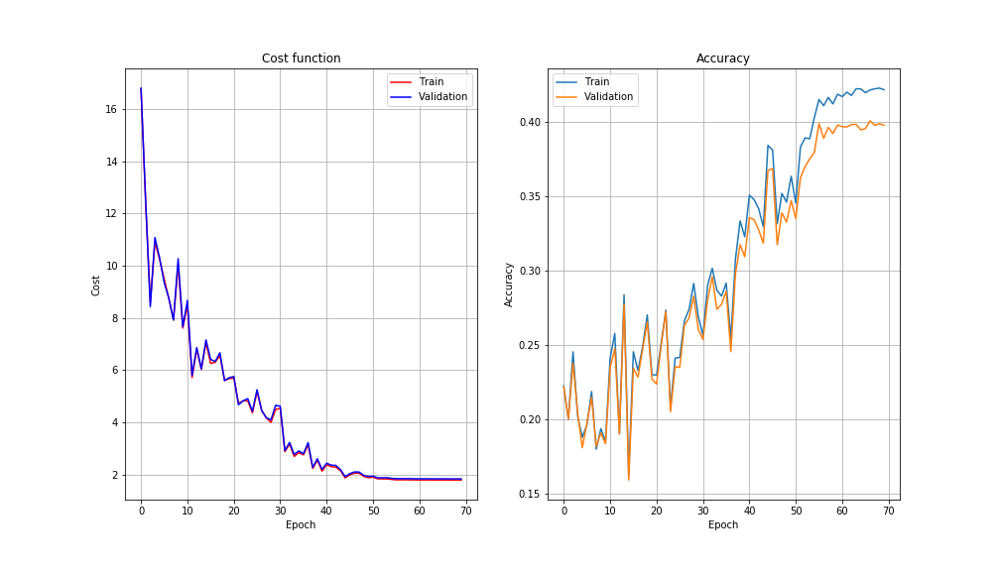

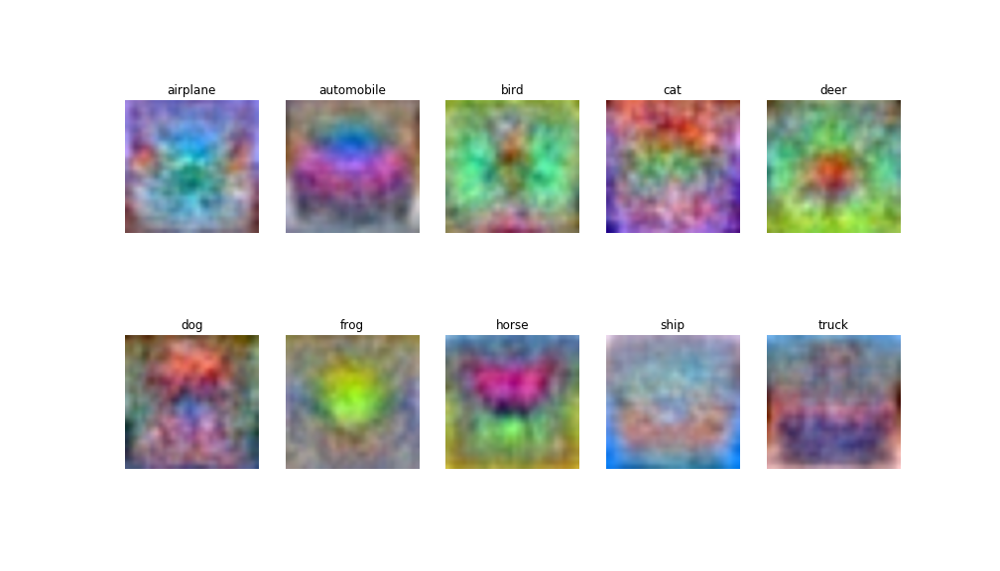

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.150%
- cost:     1.786
Validation:
- accuracy: 39.730%%
- cost:      1.830


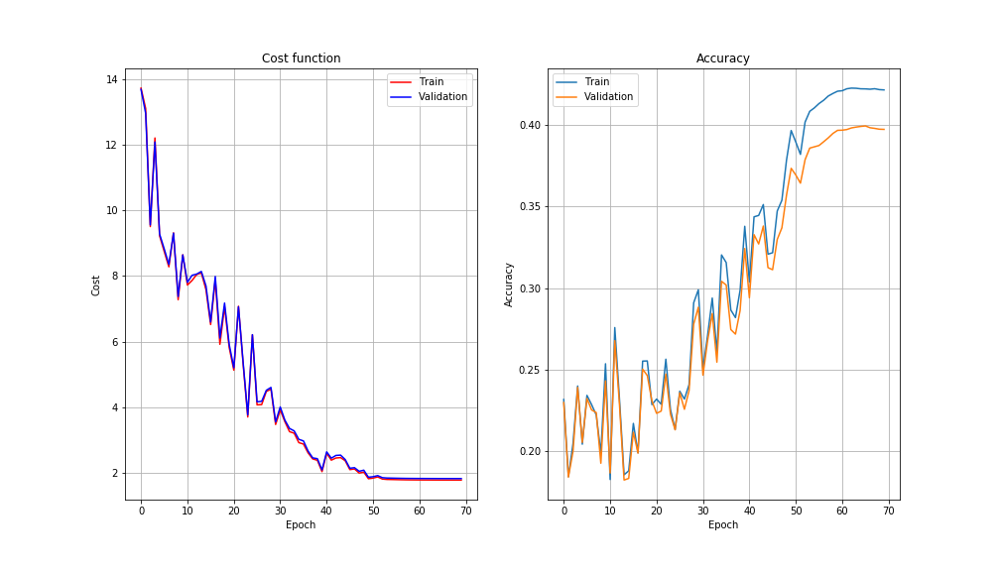

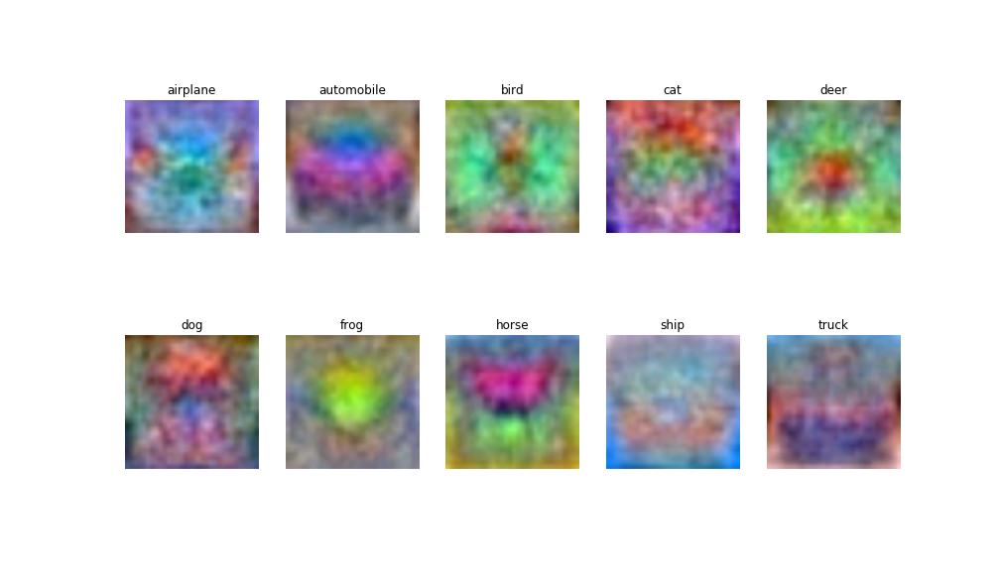

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	True
Training:
- accuracy: 42.123%
- cost:     1.786
Validation:
- accuracy: 39.730%%
- cost:      1.830


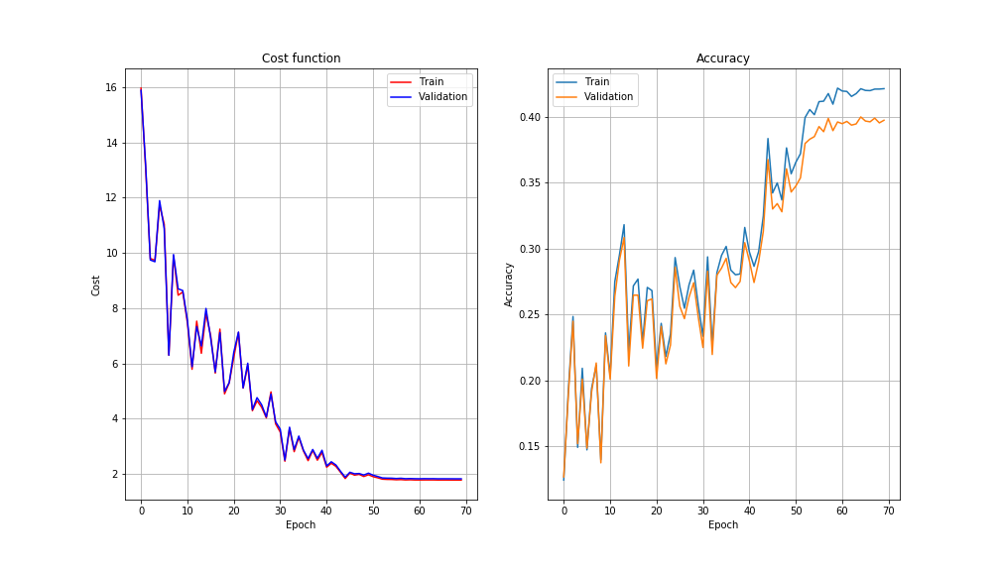

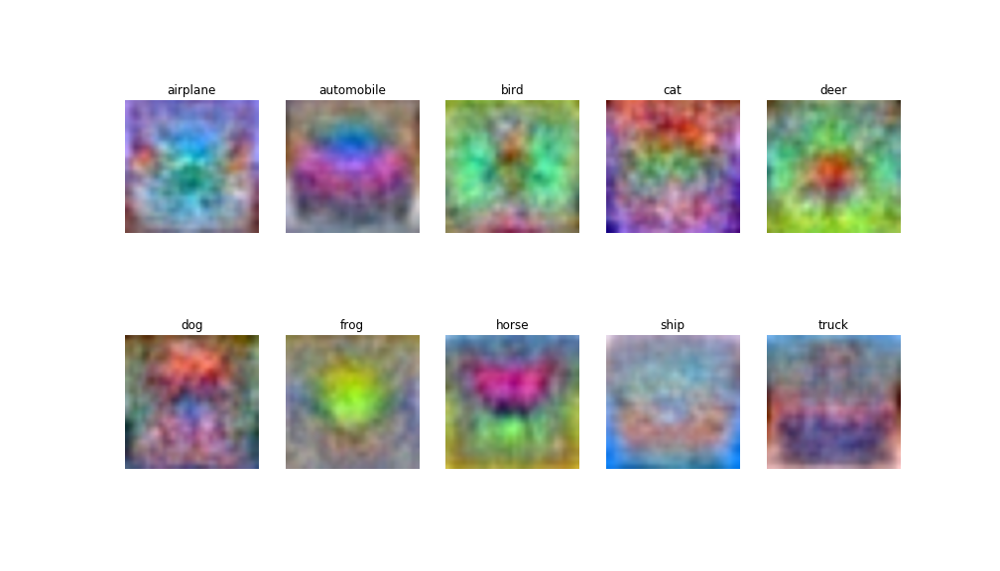

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	True
Training:
- accuracy: 42.203%
- cost:     1.782
Validation:
- accuracy: 39.690%%
- cost:      1.824


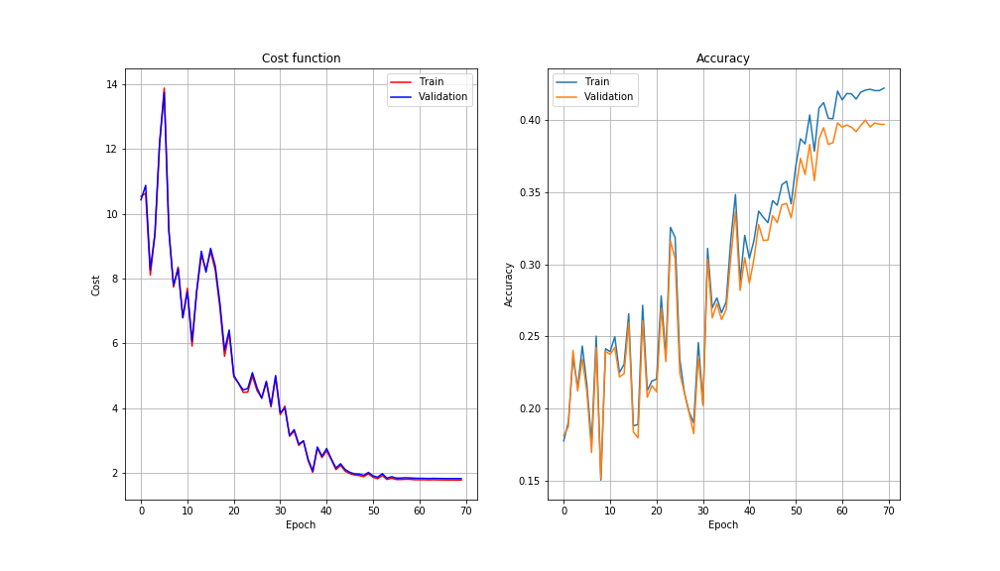

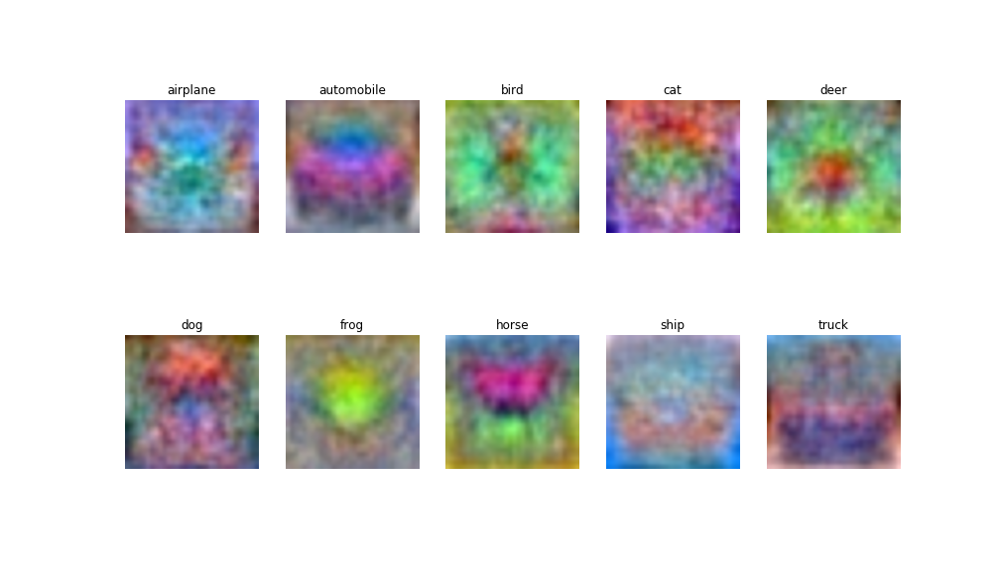

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.205%
- cost:     1.786
Validation:
- accuracy: 39.690%%
- cost:      1.830


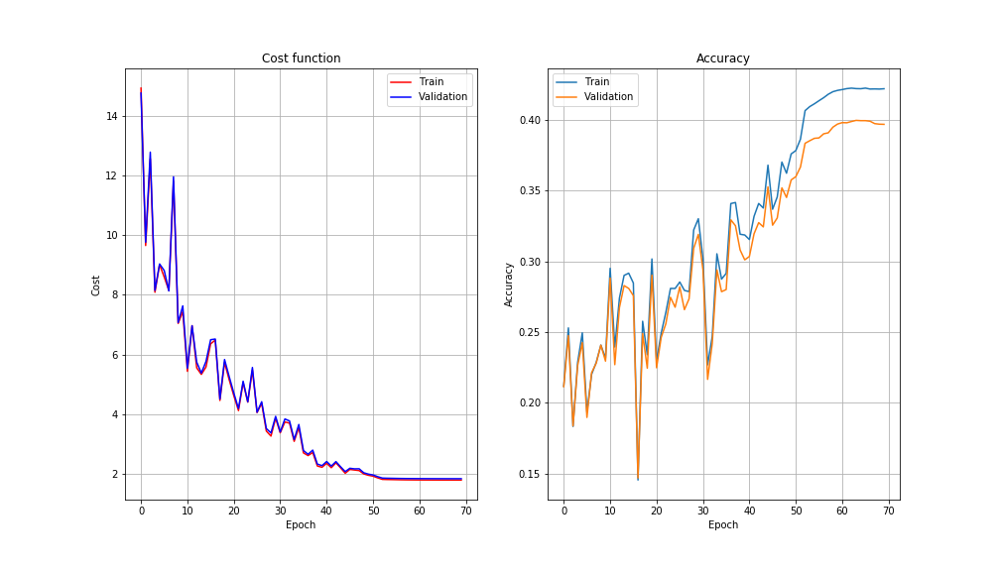

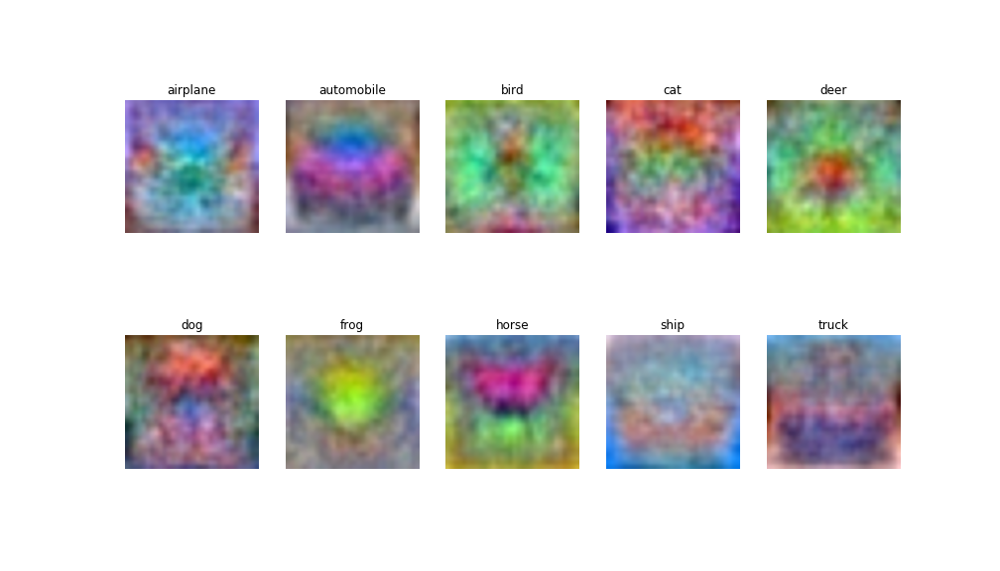

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.110%
- cost:     1.786
Validation:
- accuracy: 39.660%%
- cost:      1.829


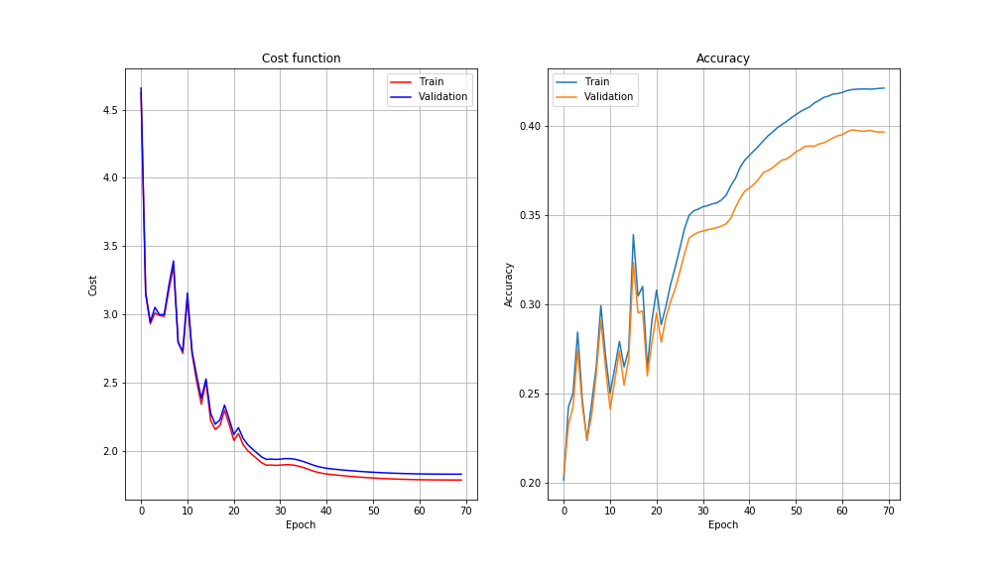

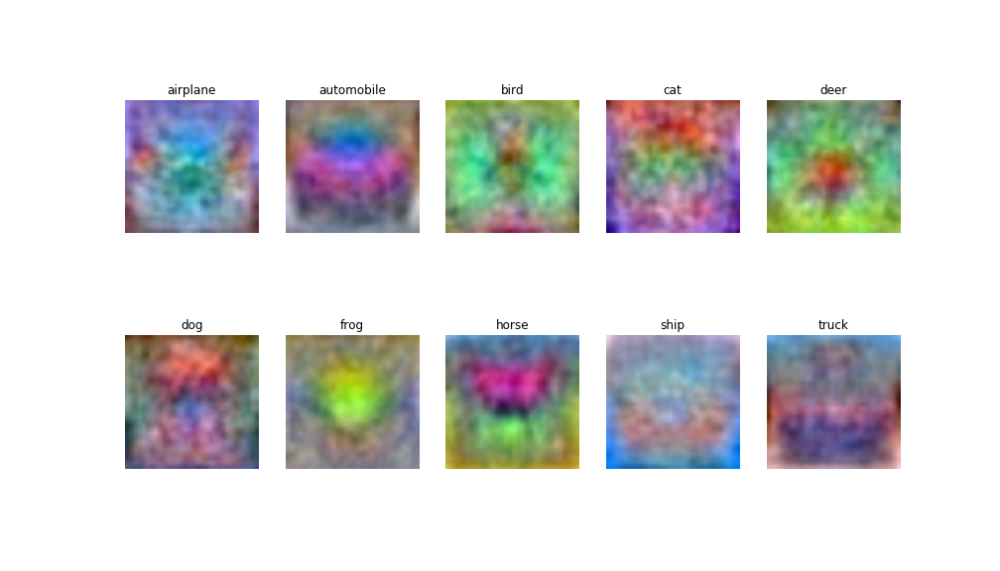

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	True
Training:
- accuracy: 41.960%
- cost:     1.786
Validation:
- accuracy: 39.630%%
- cost:      1.829


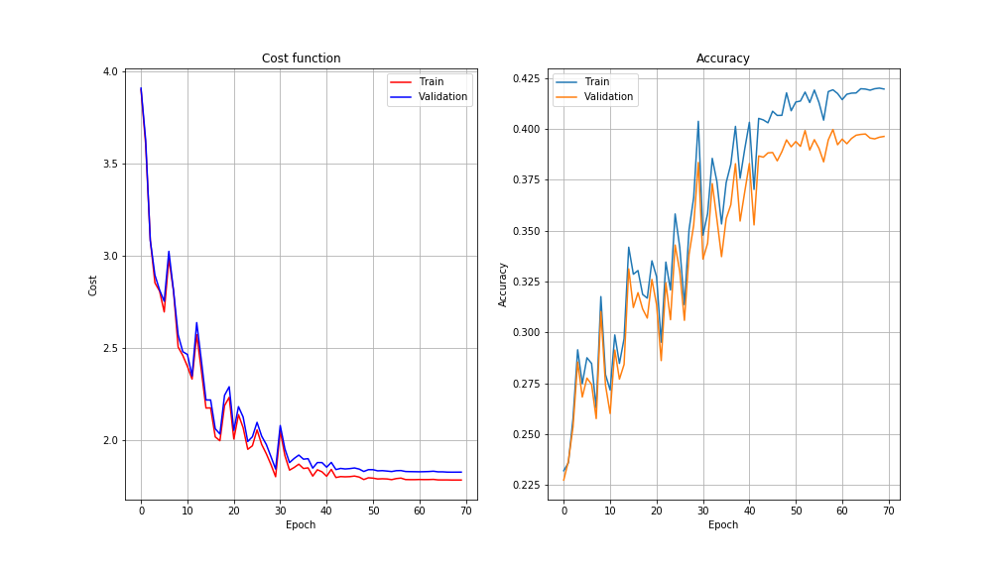

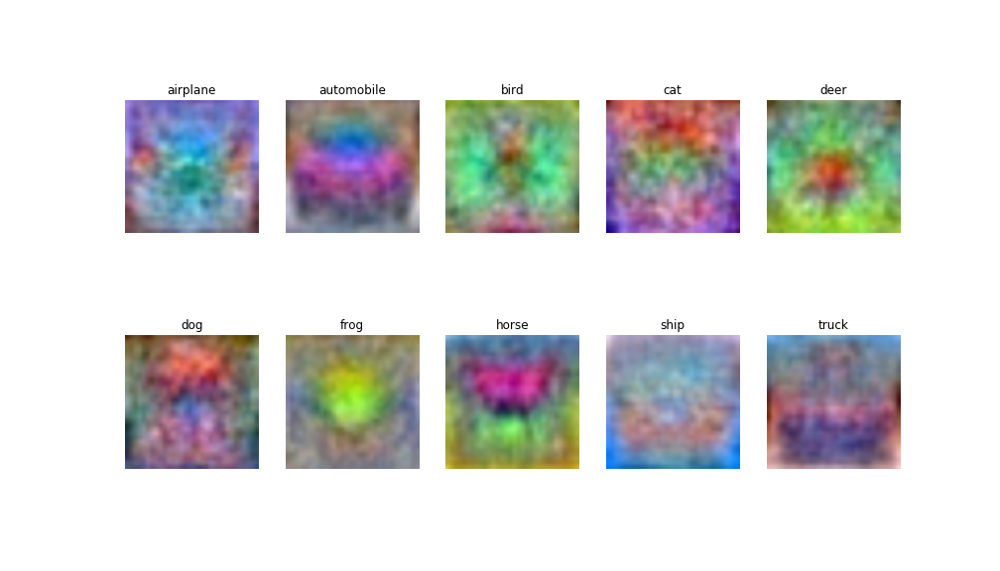

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	False
Training:
- accuracy: 42.110%
- cost:     1.786
Validation:
- accuracy: 39.620%%
- cost:      1.829


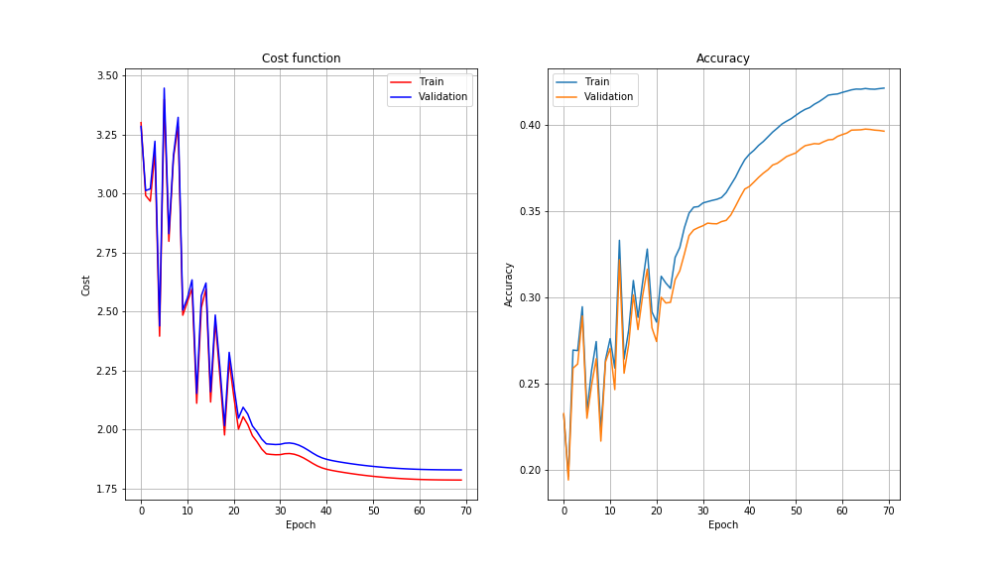

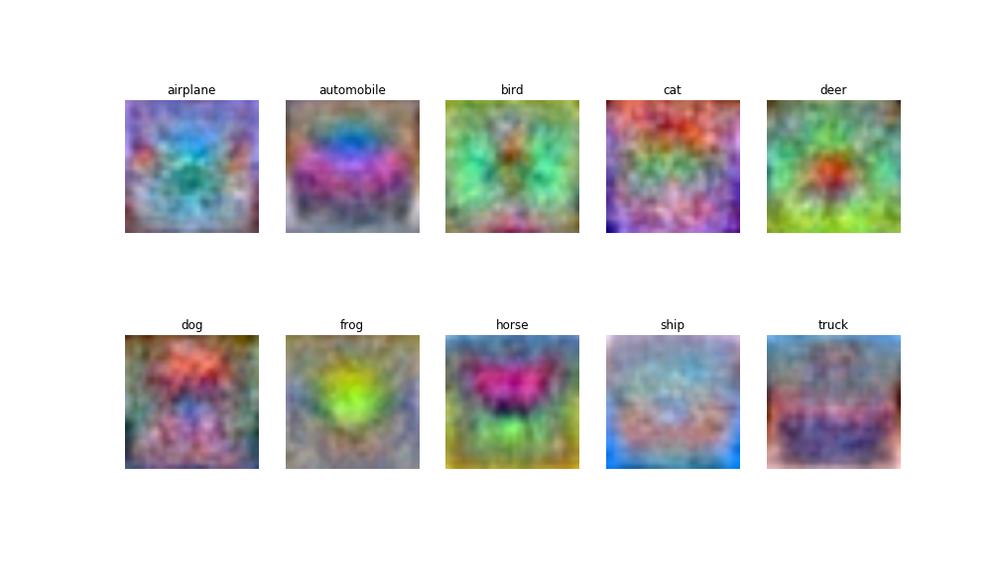

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.010
- shuffle	True
Training:
- accuracy: 42.050%
- cost:     1.786
Validation:
- accuracy: 39.550%%
- cost:      1.829


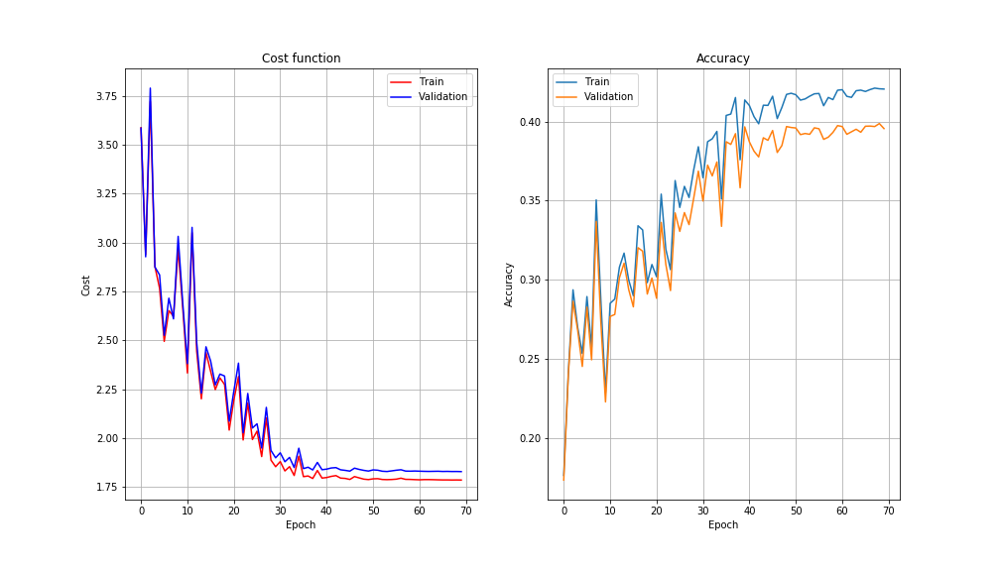

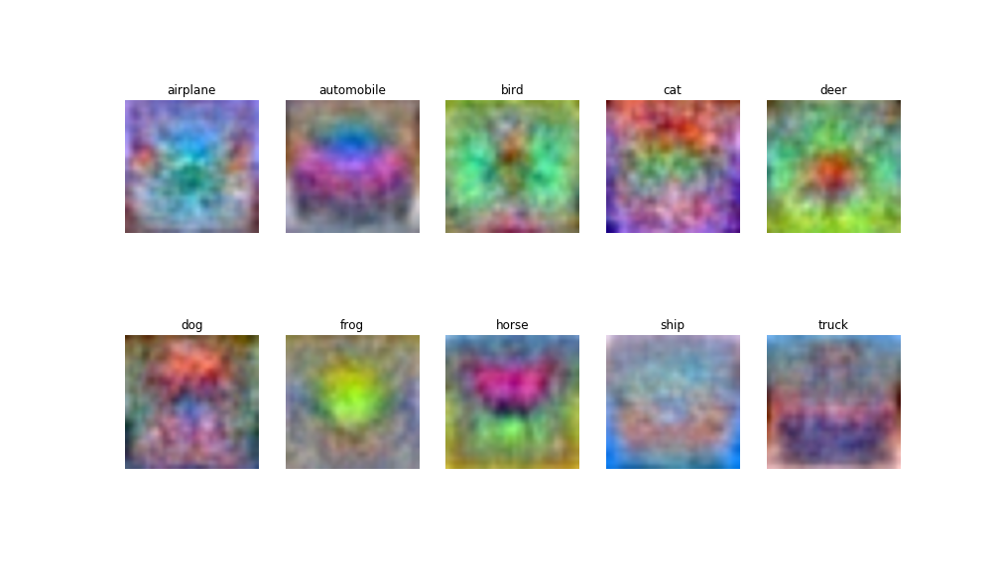

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	False
Training:
- accuracy: 42.200%
- cost:     1.708
Validation:
- accuracy: 39.490%%
- cost:      1.761


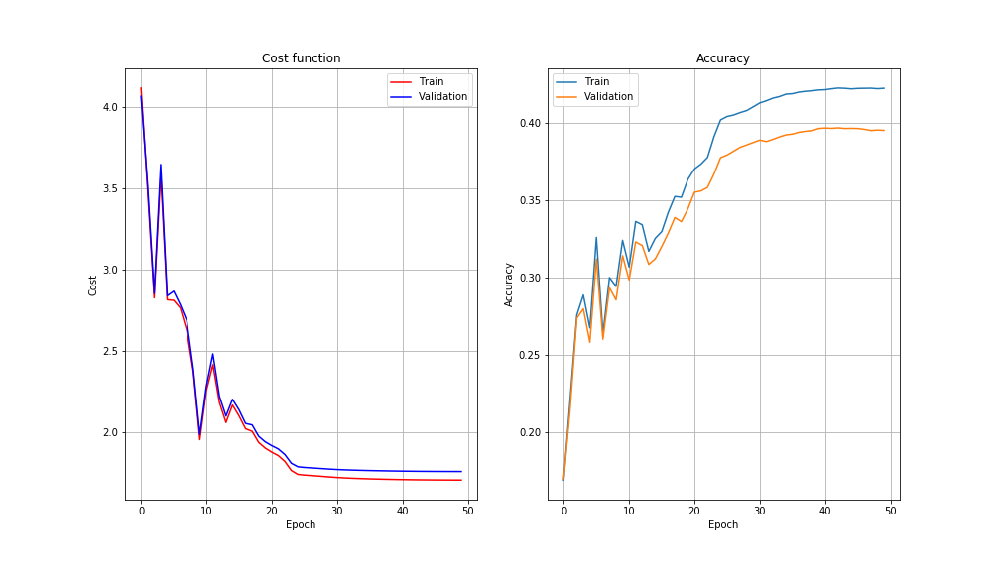

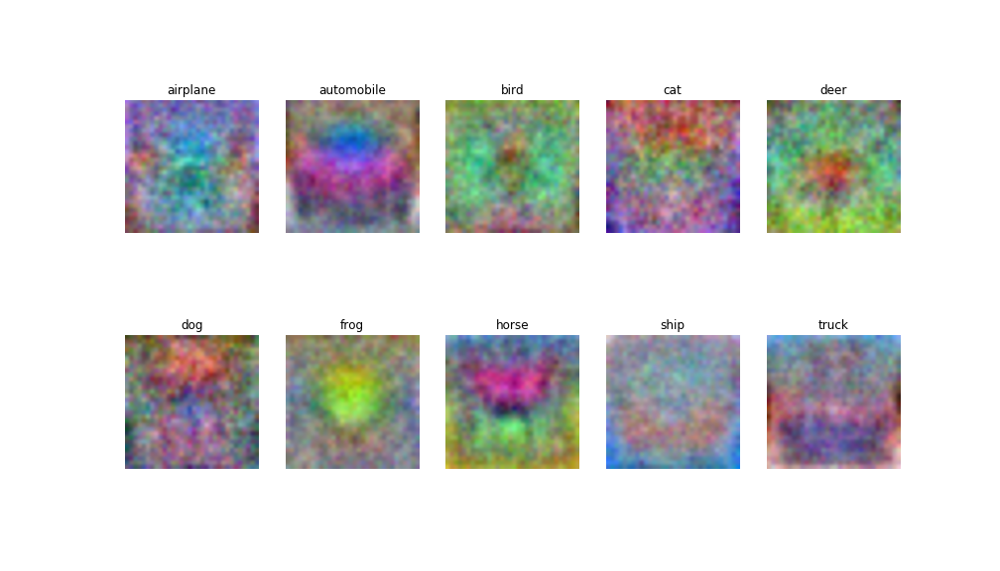

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	250
- lambda	0.000
- shuffle	True
Training:
- accuracy: 41.855%
- cost:     1.704
Validation:
- accuracy: 39.430%%
- cost:      1.760


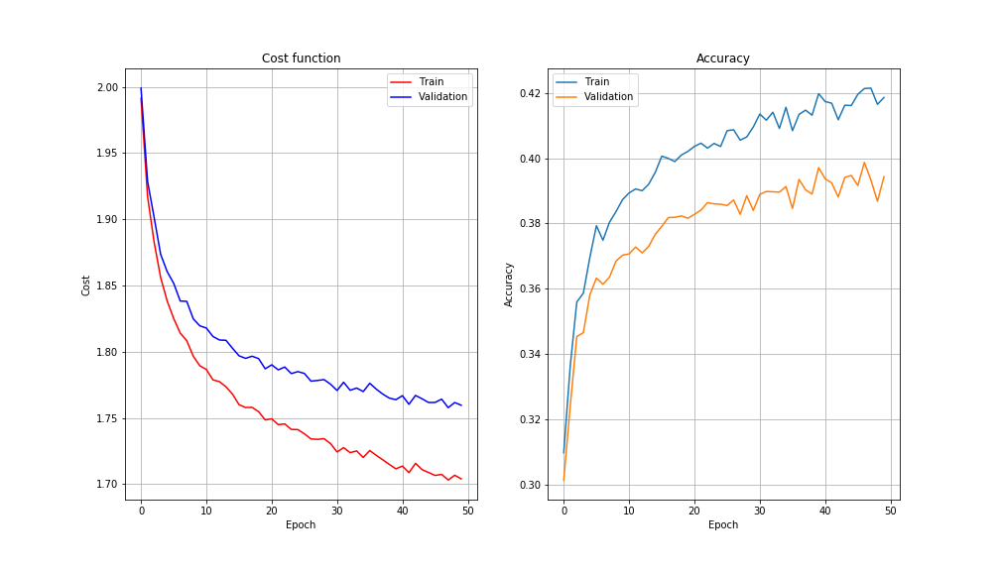

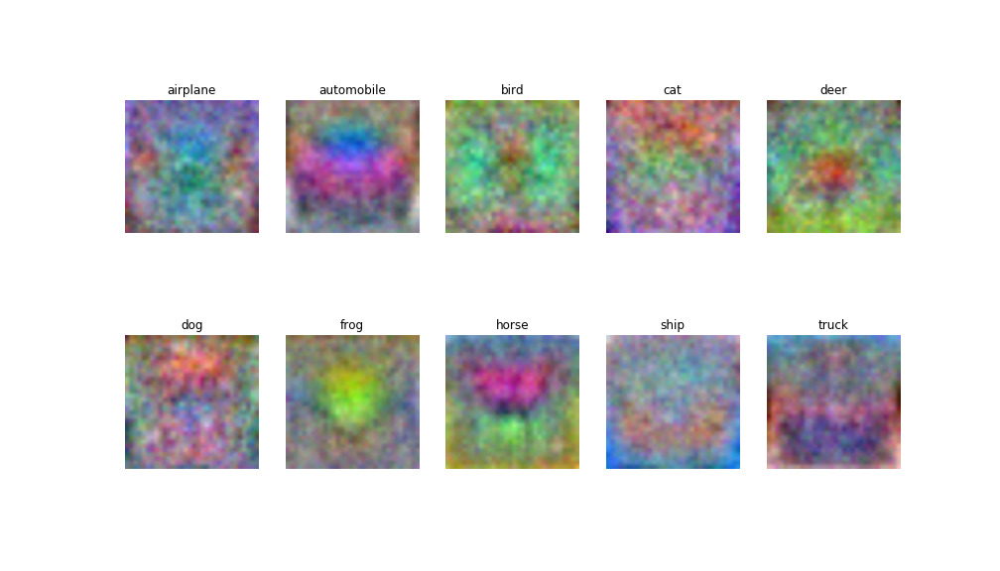

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	False
Training:
- accuracy: 42.080%
- cost:     1.708
Validation:
- accuracy: 39.390%%
- cost:      1.761


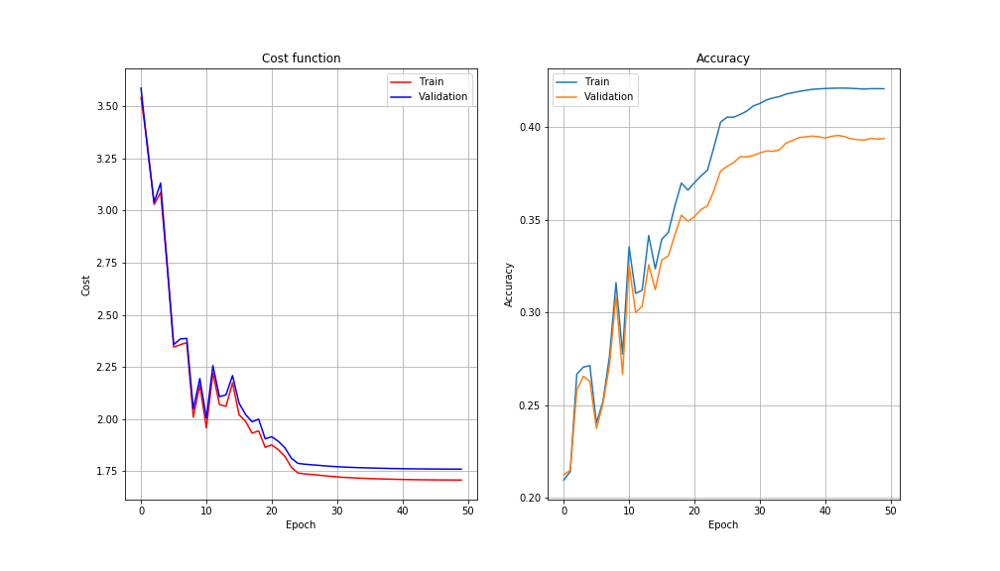

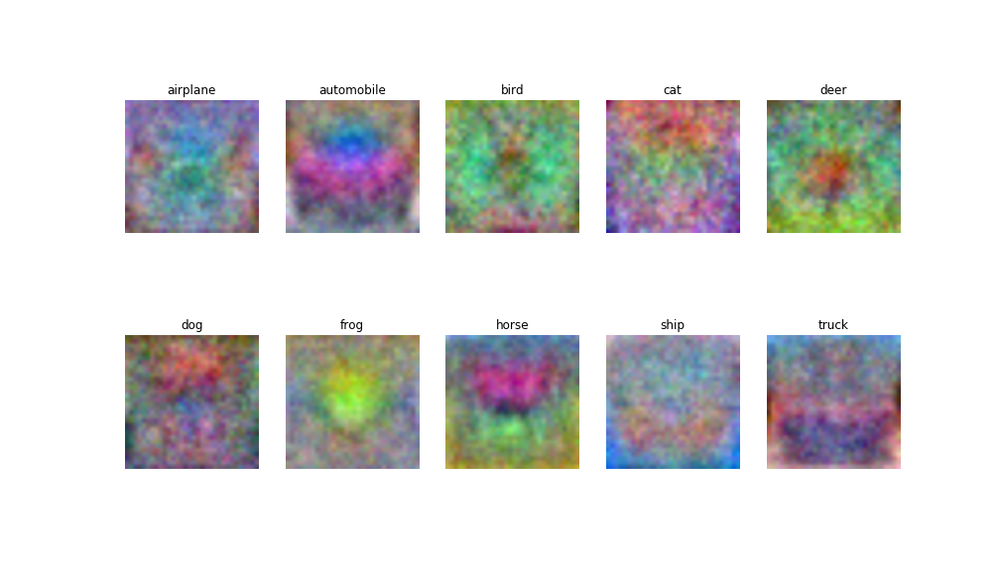

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	True
Training:
- accuracy: 42.115%
- cost:     1.709
Validation:
- accuracy: 39.330%%
- cost:      1.761


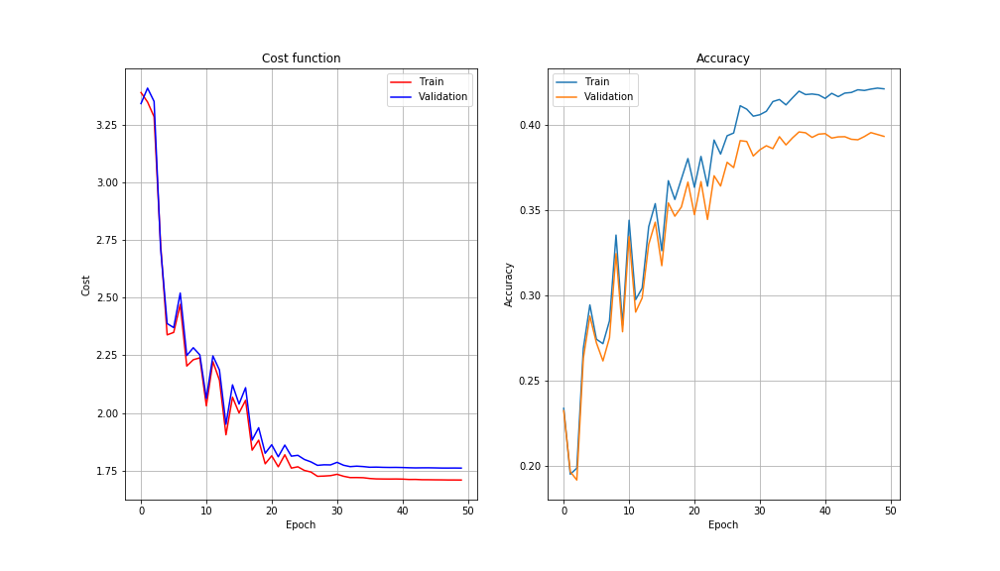

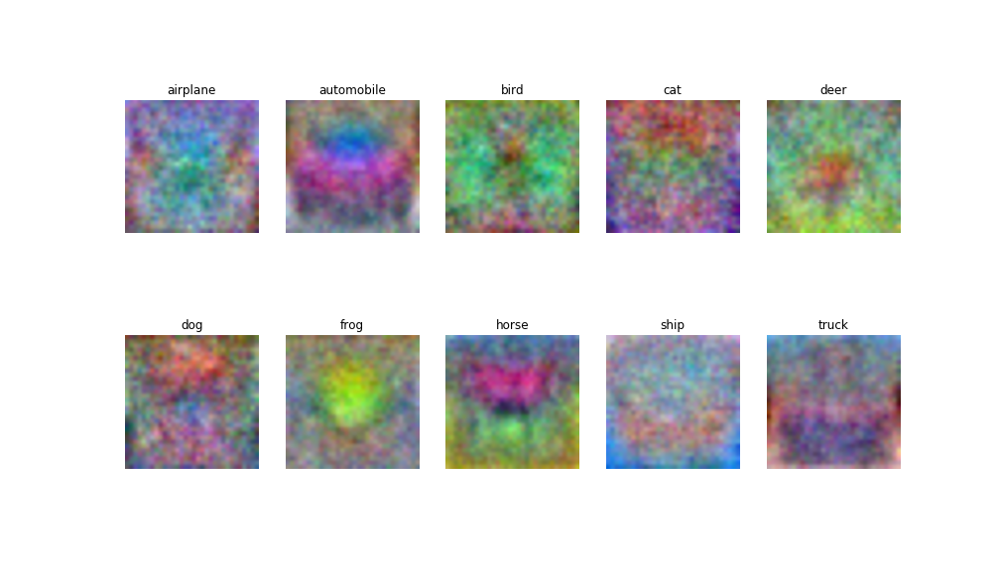

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	False
Training:
- accuracy: 41.593%
- cost:     1.791
Validation:
- accuracy: 39.330%%
- cost:      1.833


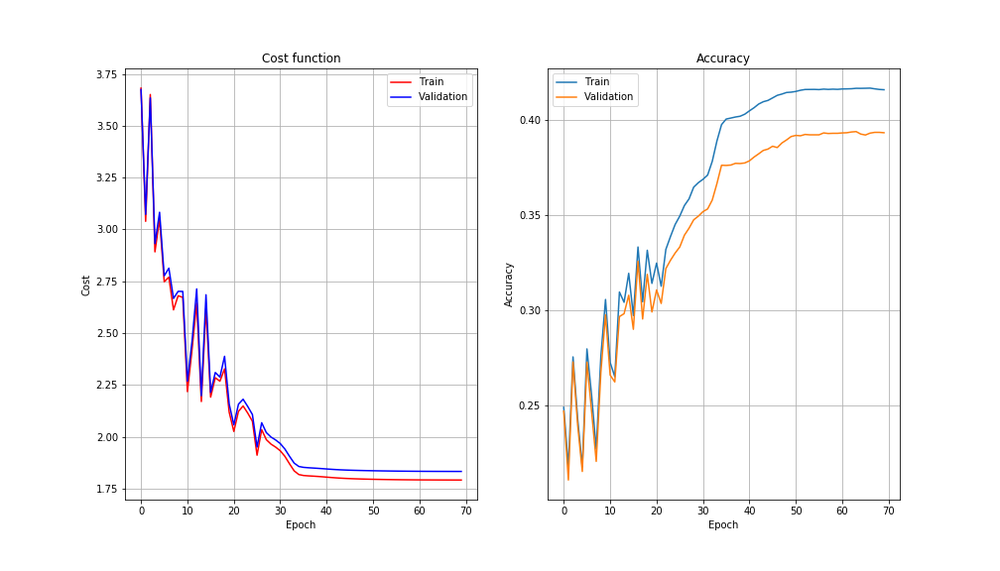

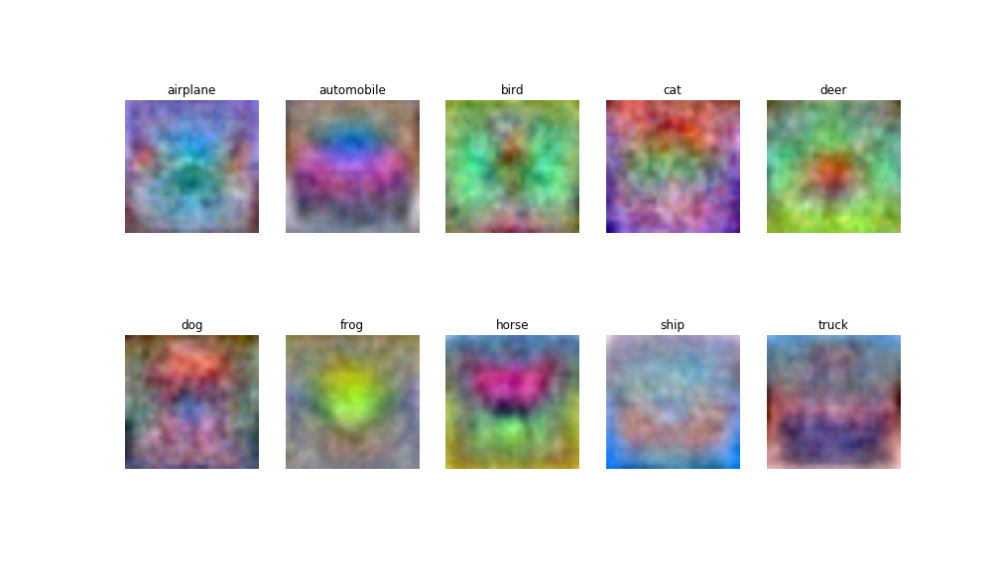

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	50
- batch_size	1000
- lambda	0.000
- shuffle	True
Training:
- accuracy: 42.193%
- cost:     1.708
Validation:
- accuracy: 39.300%%
- cost:      1.761


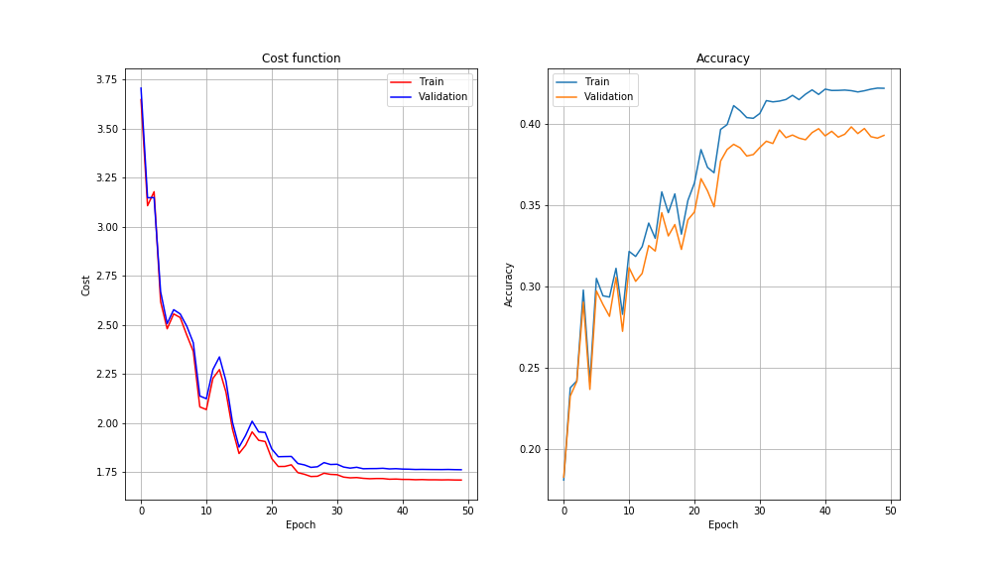

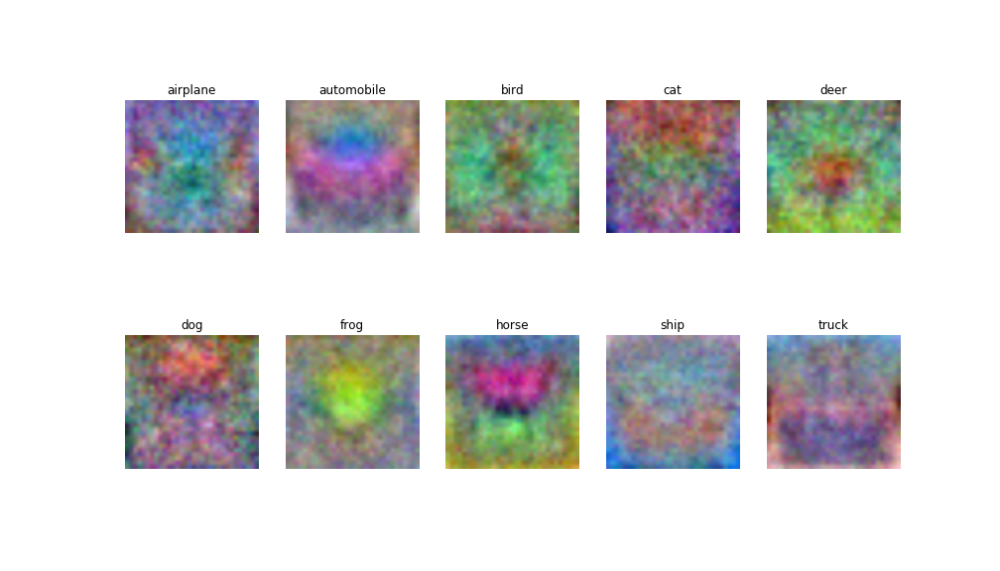

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	True
Training:
- accuracy: 41.572%
- cost:     1.792
Validation:
- accuracy: 39.280%%
- cost:      1.833


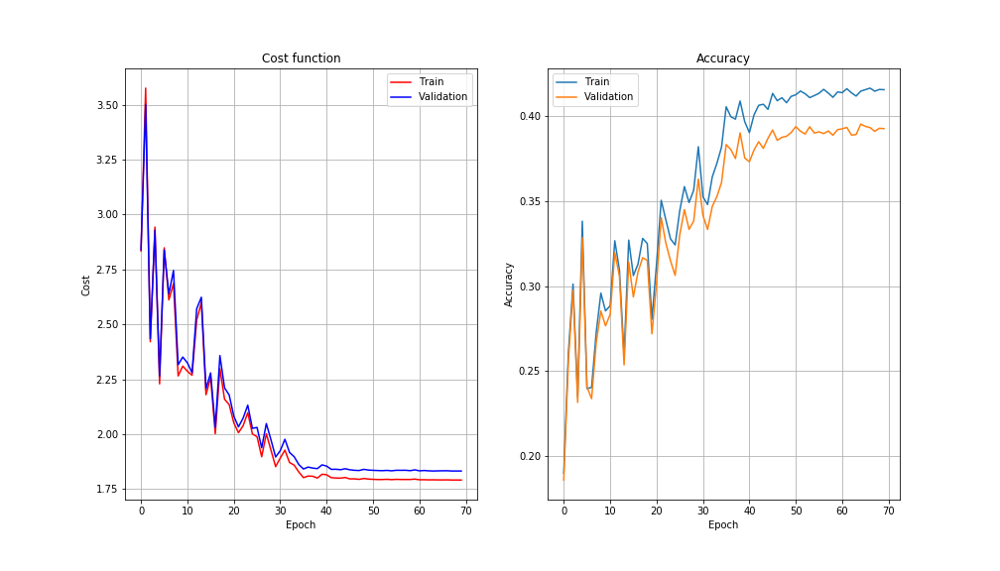

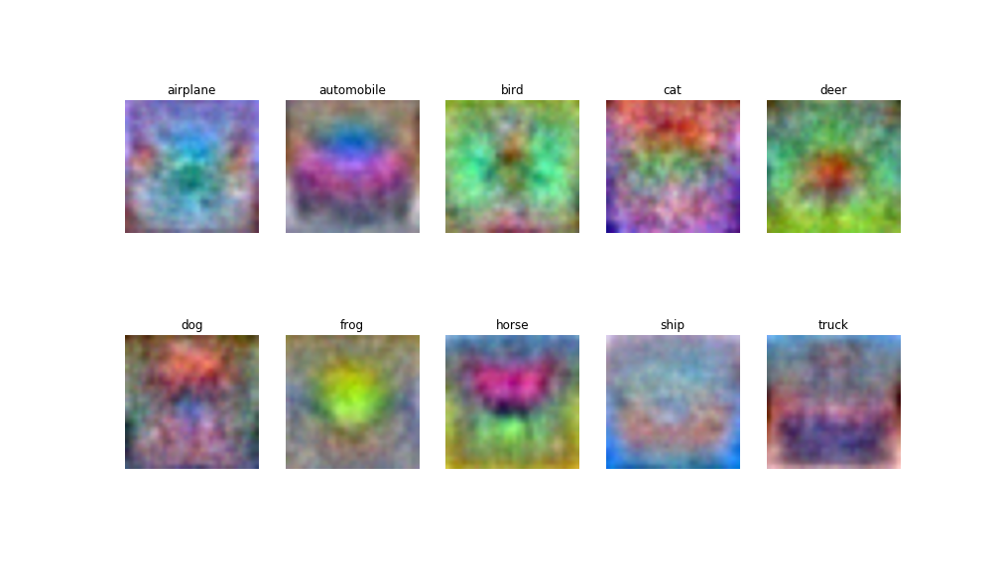

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	True
Training:
- accuracy: 41.638%
- cost:     1.791
Validation:
- accuracy: 39.270%%
- cost:      1.833


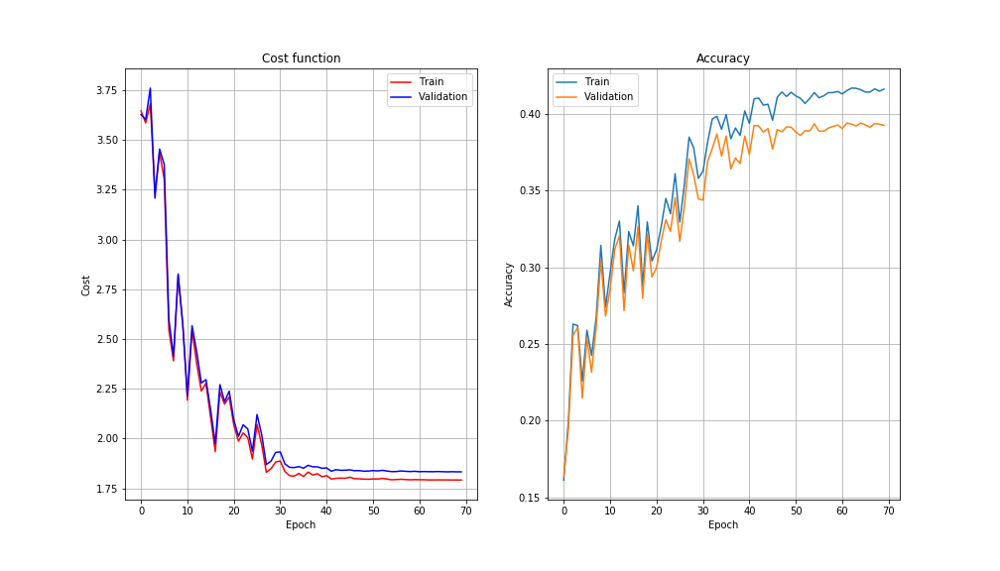

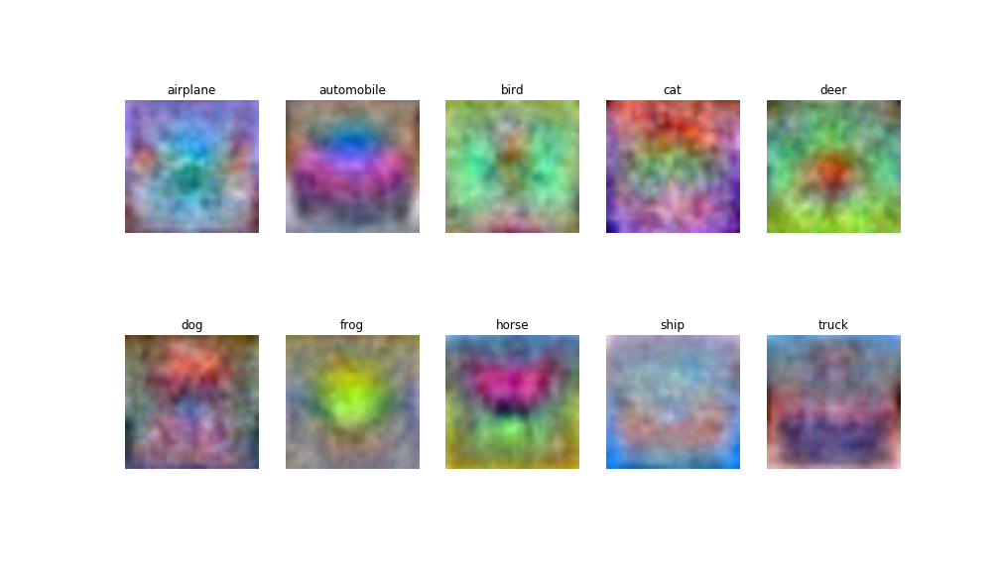

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.010
- shuffle	False
Training:
- accuracy: 41.515%
- cost:     1.792
Validation:
- accuracy: 39.230%%
- cost:      1.833


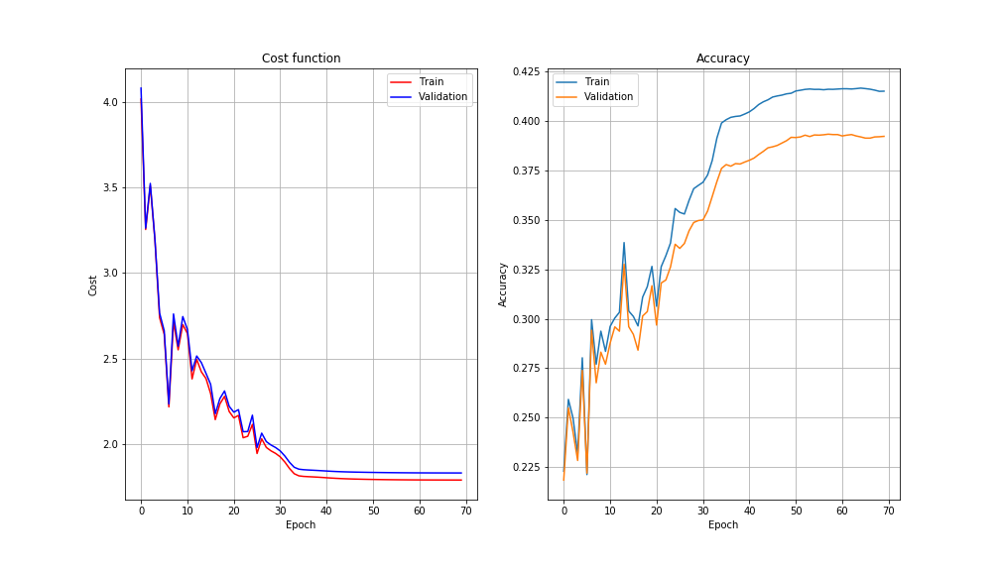

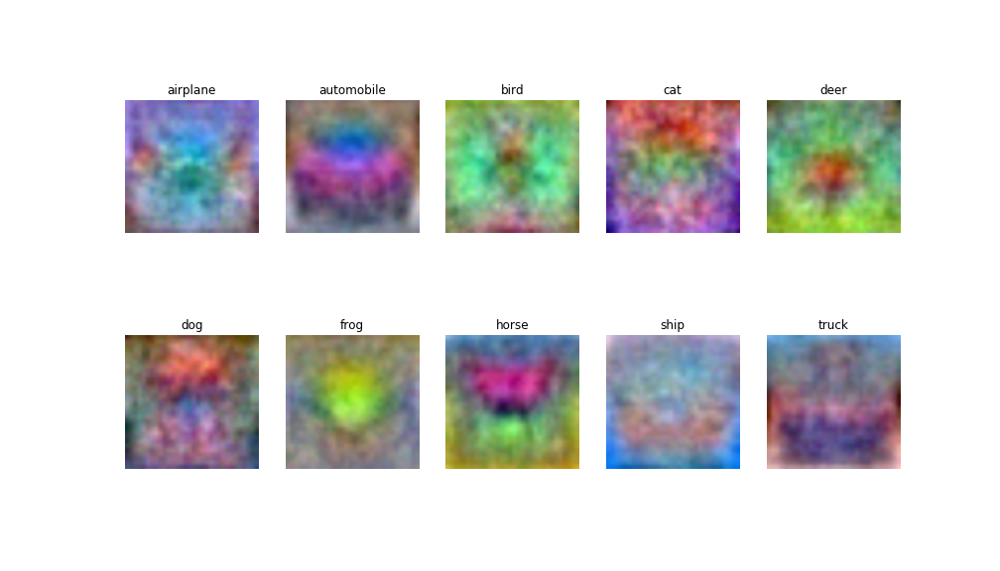

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	200
- lambda	0.000
- shuffle	True
Training:
- accuracy: 41.523%
- cost:     1.717
Validation:
- accuracy: 39.210%%
- cost:      1.769


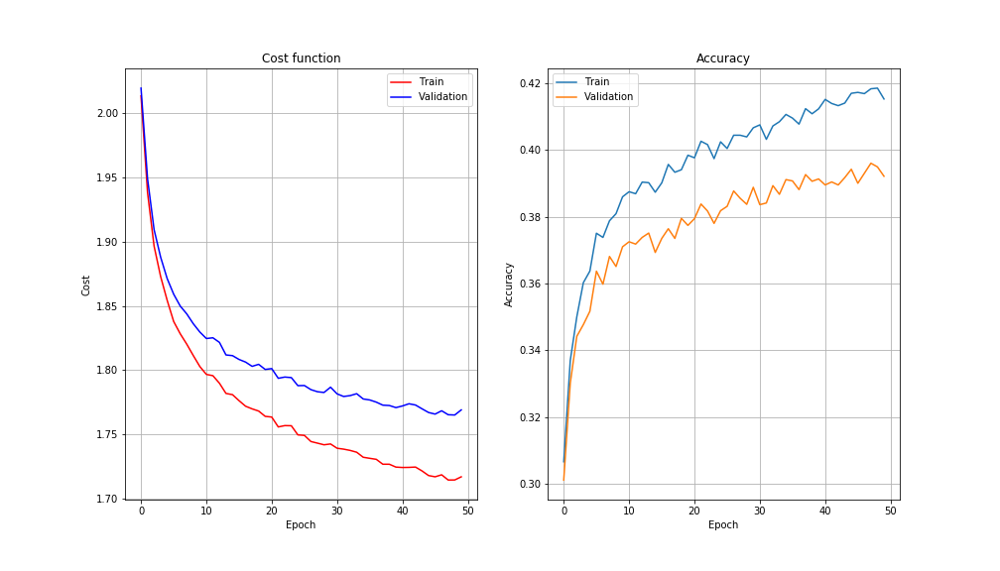

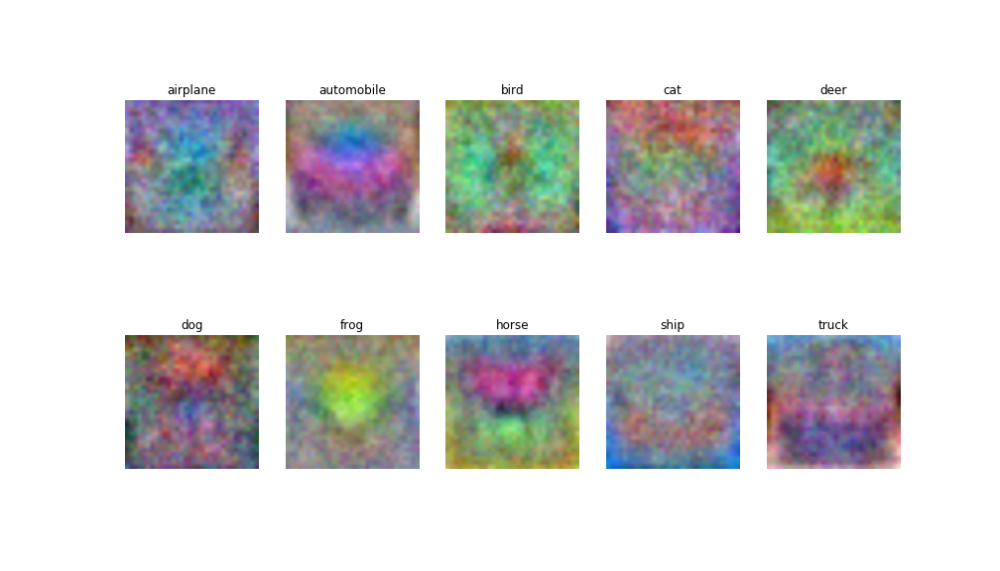

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	250
- lambda	0.000
- shuffle	False
Training:
- accuracy: 41.968%
- cost:     1.706
Validation:
- accuracy: 39.140%%
- cost:      1.762


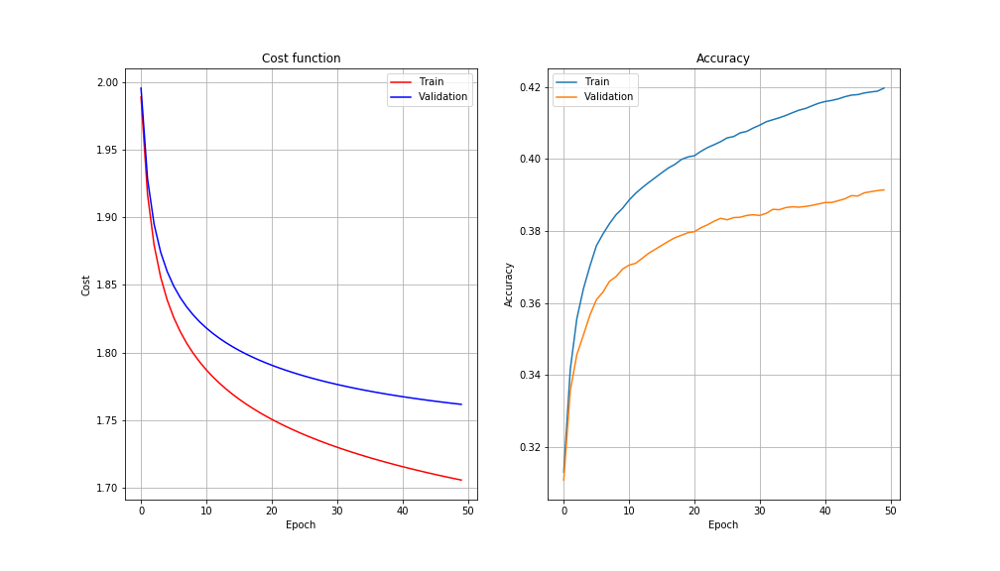

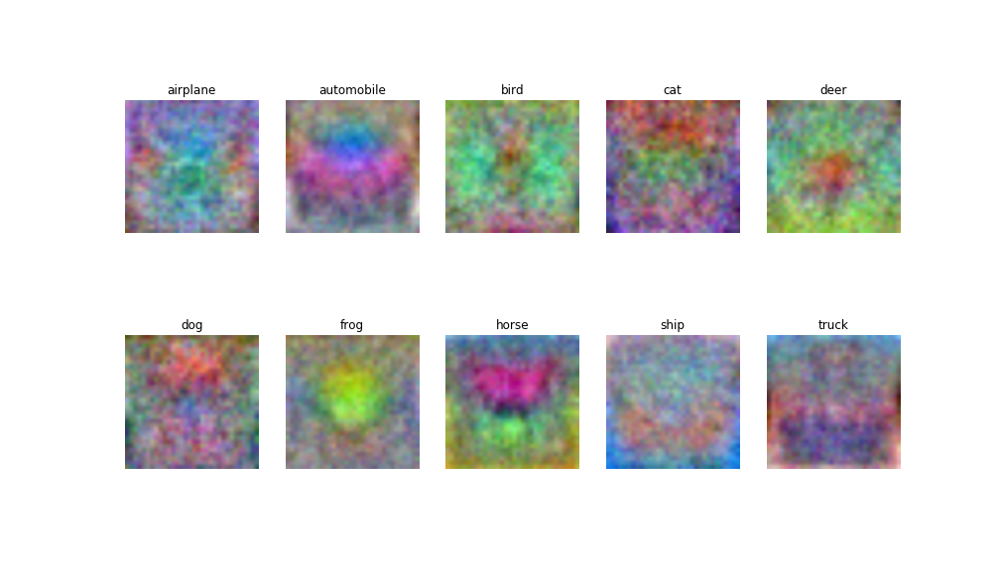

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	50
- batch_size	200
- lambda	0.000
- shuffle	False
Training:
- accuracy: 41.902%
- cost:     1.695
Validation:
- accuracy: 39.090%%
- cost:      1.763


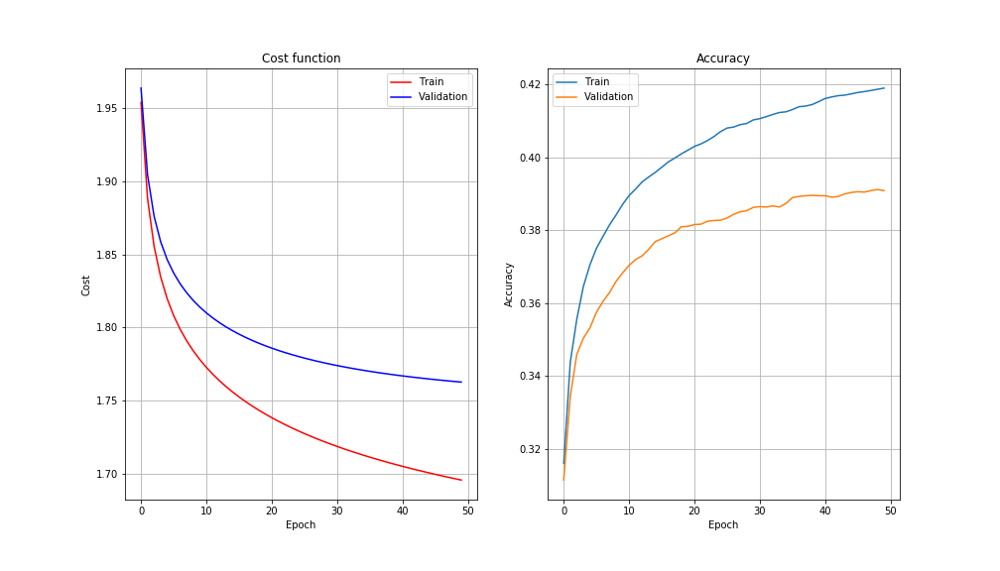

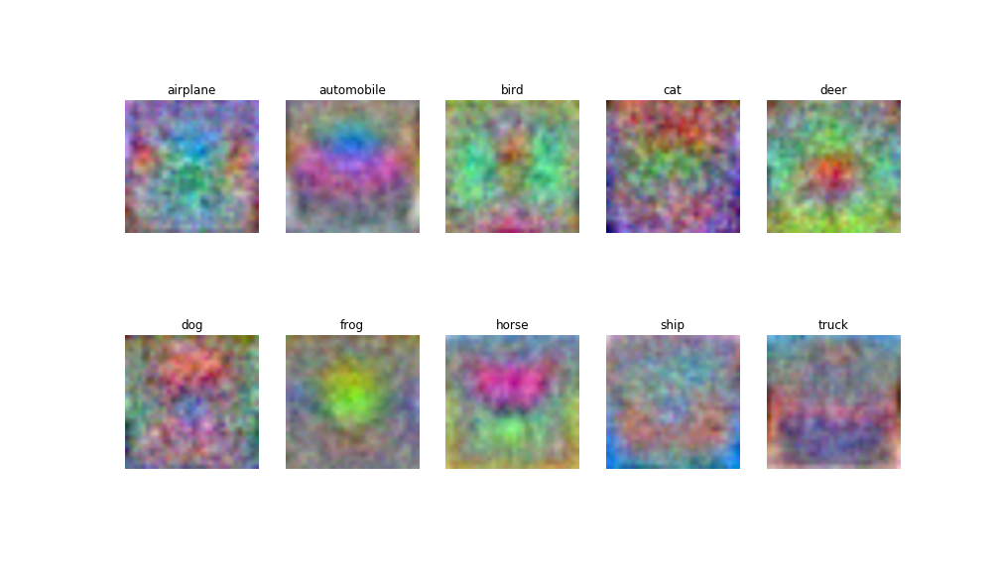

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	200
- lambda	0.000
- shuffle	False
Training:
- accuracy: 41.645%
- cost:     1.716
Validation:
- accuracy: 39.050%%
- cost:      1.766


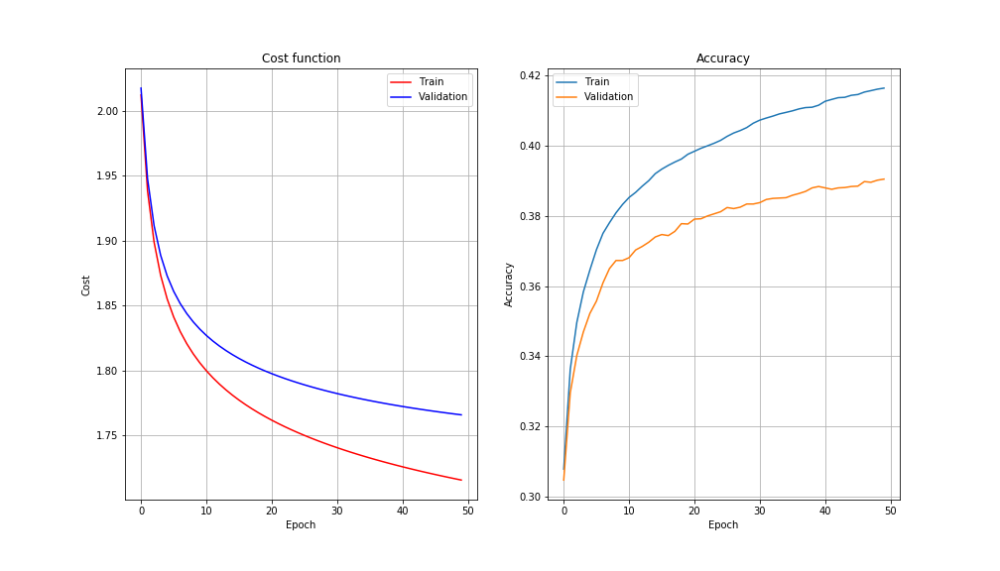

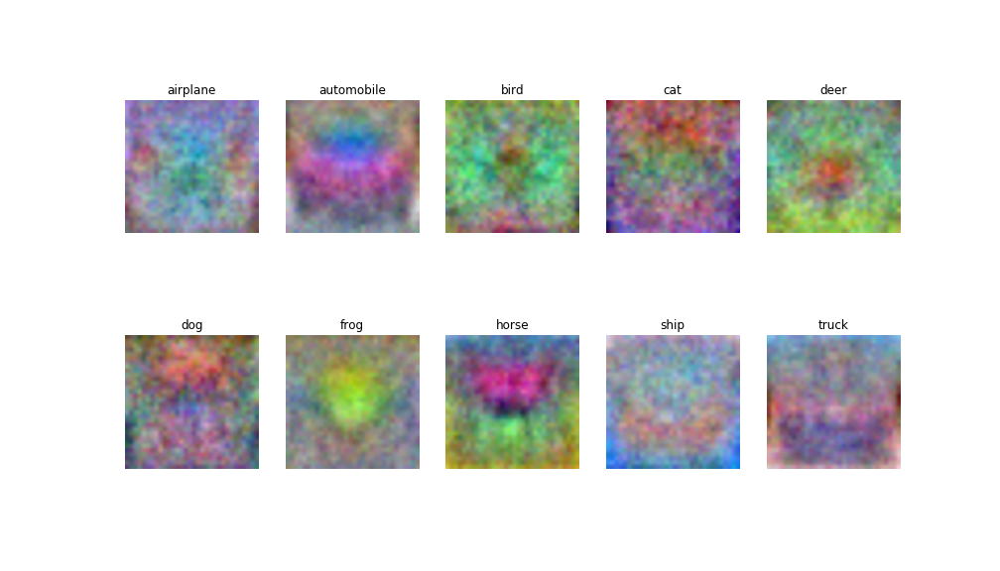

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 40.492%
- cost:     1.738
Validation:
- accuracy: 38.850%%
- cost:      1.780


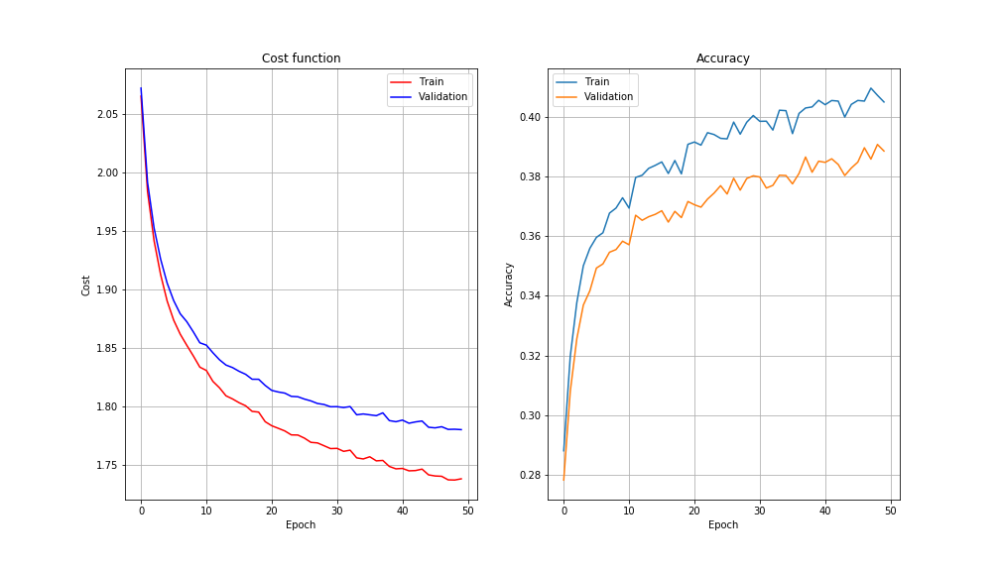

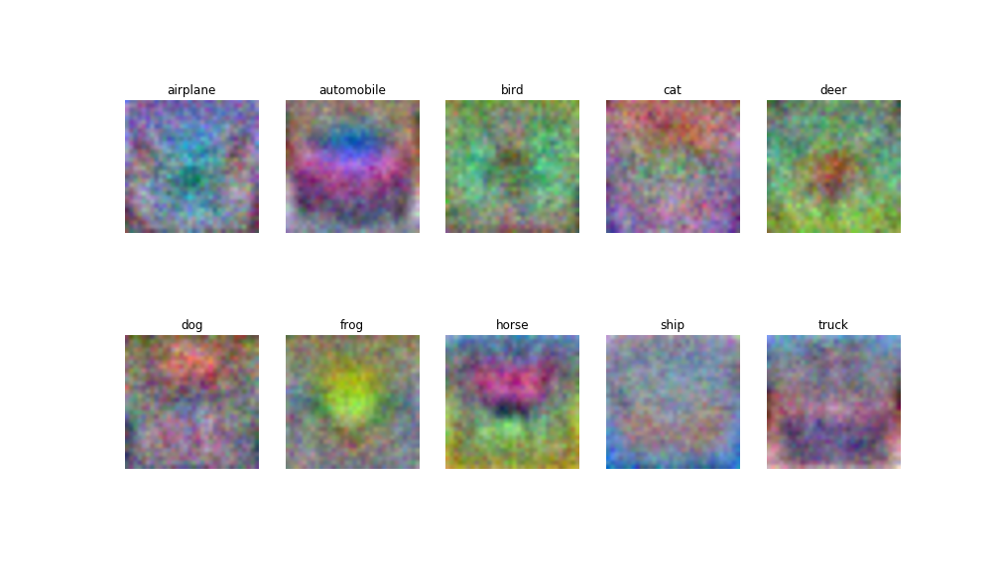

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 40.898%
- cost:     1.736
Validation:
- accuracy: 38.500%%
- cost:      1.779


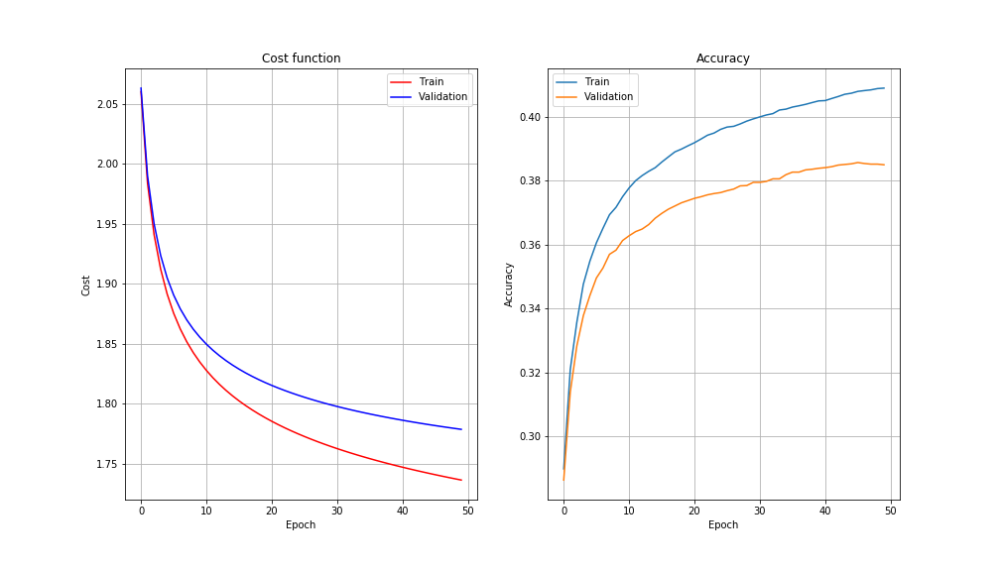

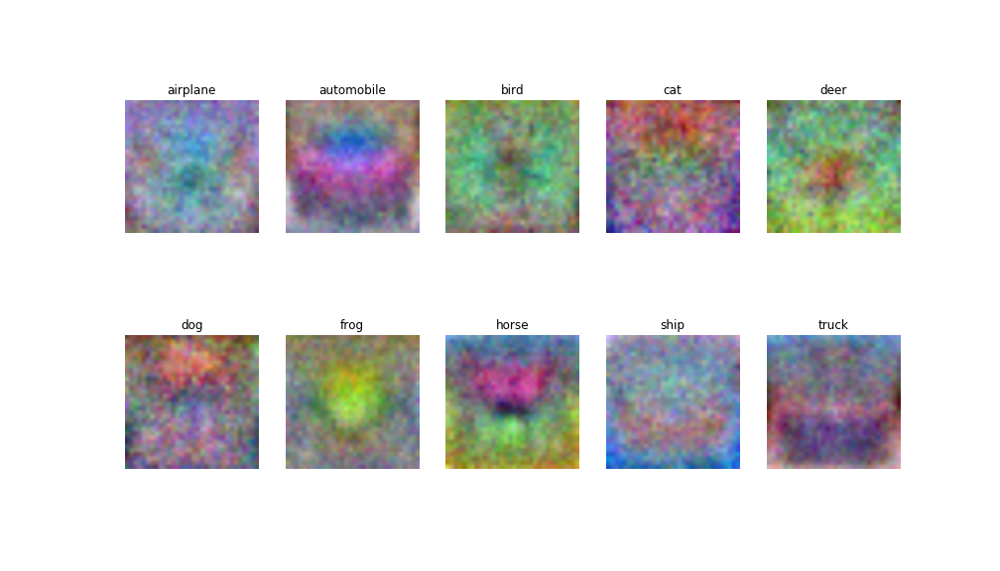

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	30
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 40.020%
- cost:     1.753
Validation:
- accuracy: 38.200%%
- cost:      1.791


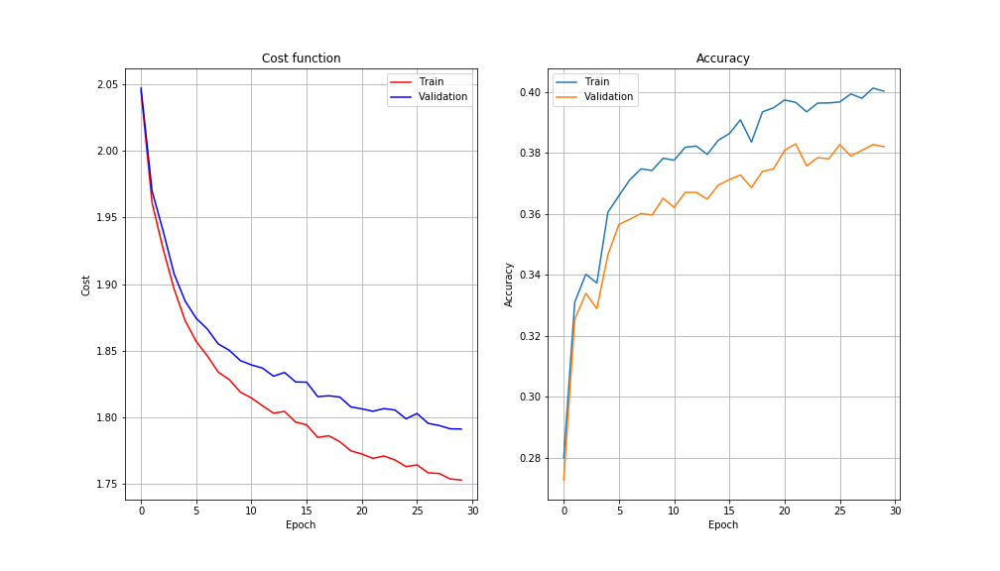

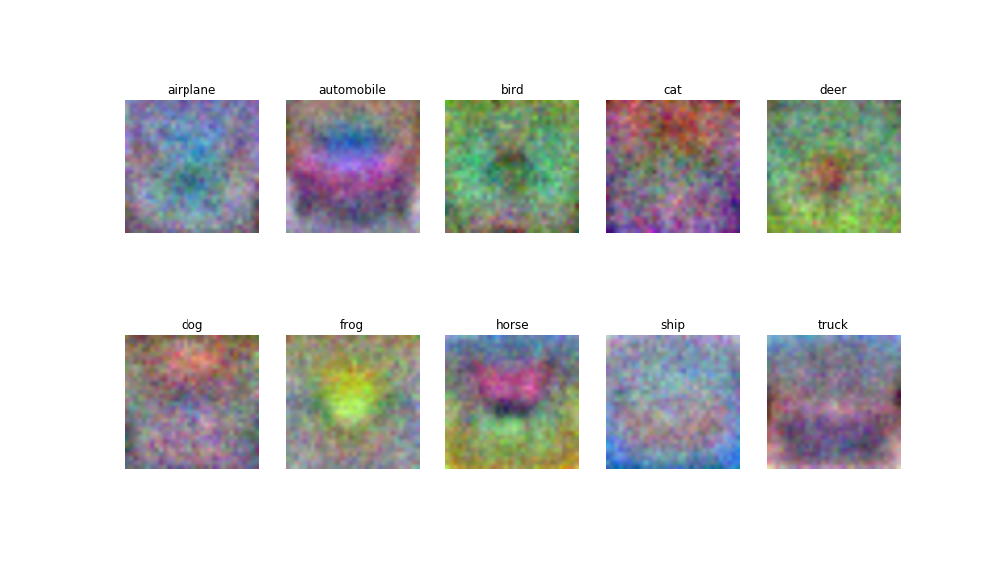

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 40.085%
- cost:     1.760
Validation:
- accuracy: 38.080%%
- cost:      1.797


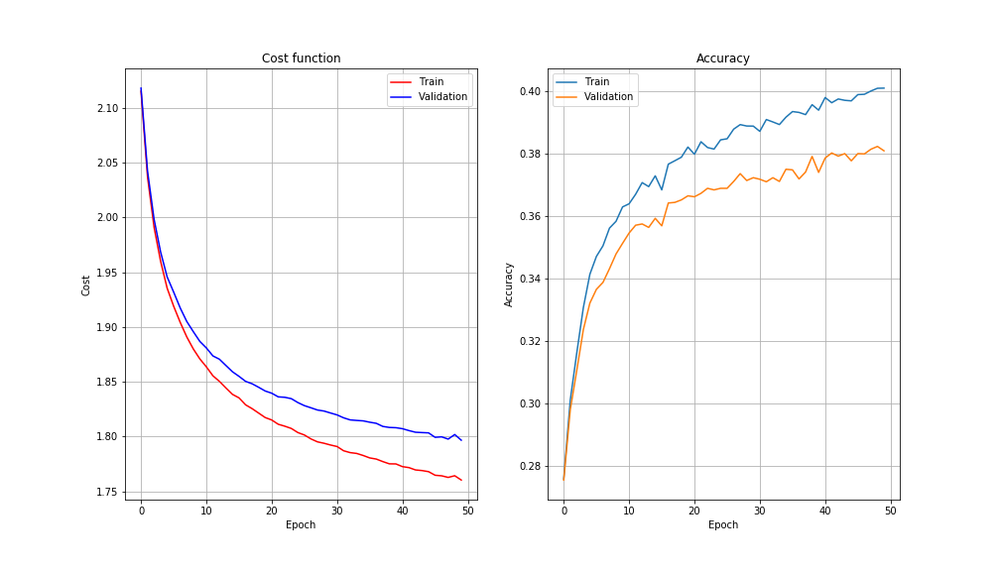

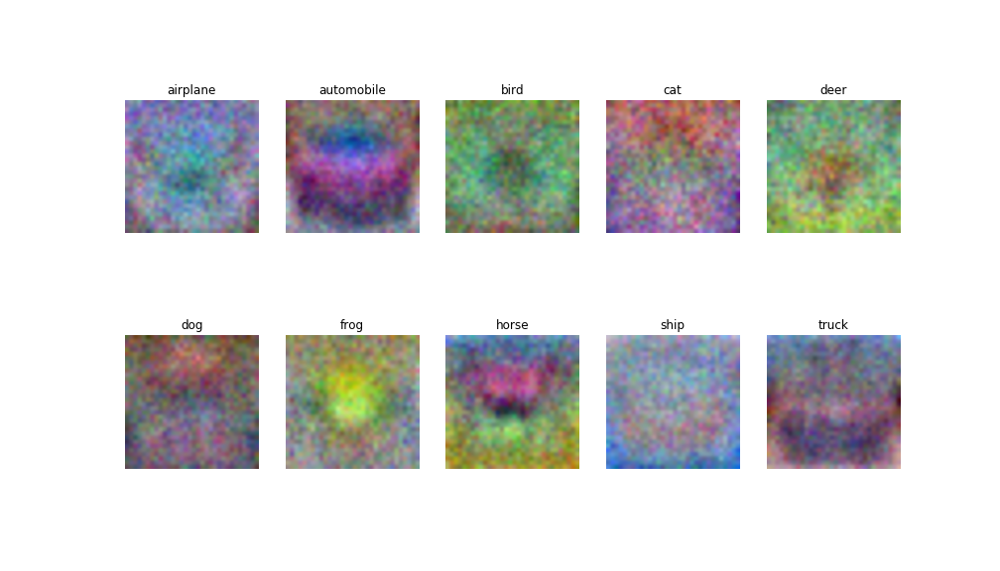

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 40.120%
- cost:     1.760
Validation:
- accuracy: 38.060%%
- cost:      1.796


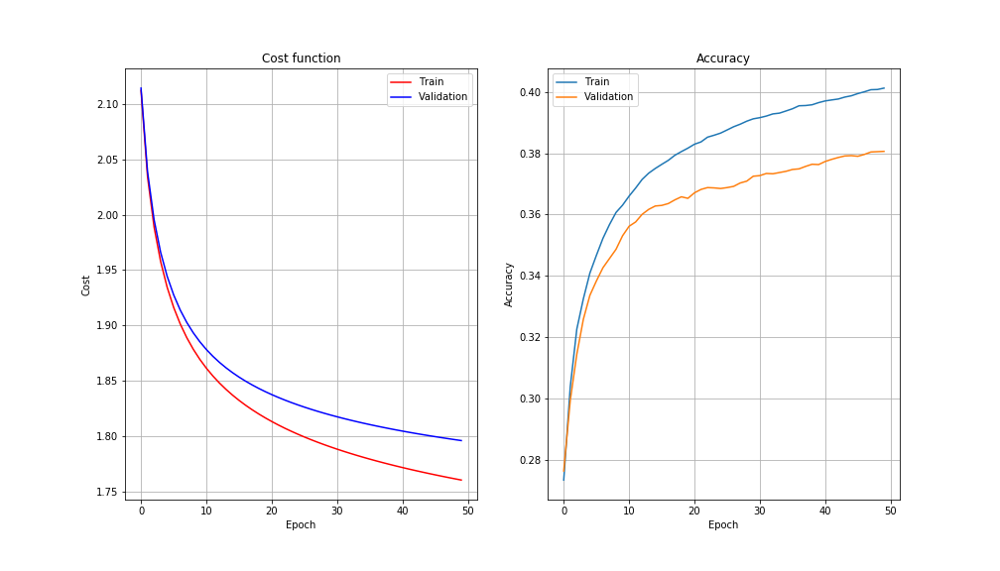

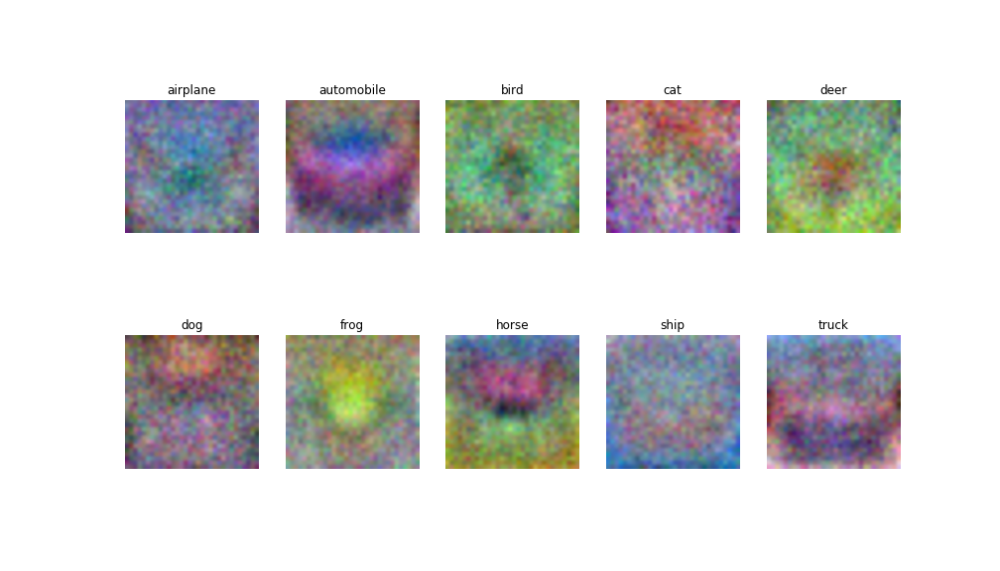

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	30
- batch_size	500
- lambda	0.000
- shuffle	False
Training:
- accuracy: 40.120%
- cost:     1.755
Validation:
- accuracy: 37.940%%
- cost:      1.793


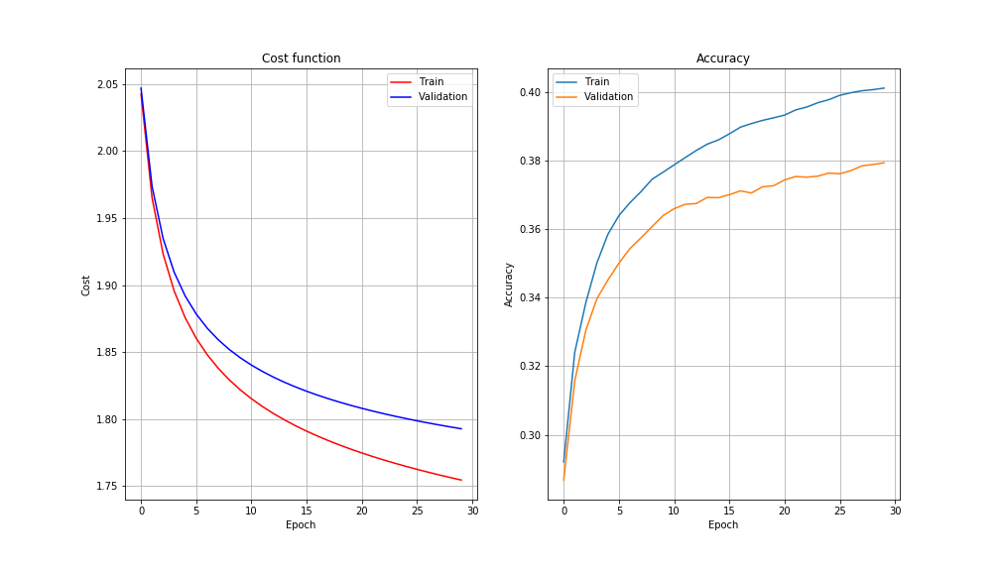

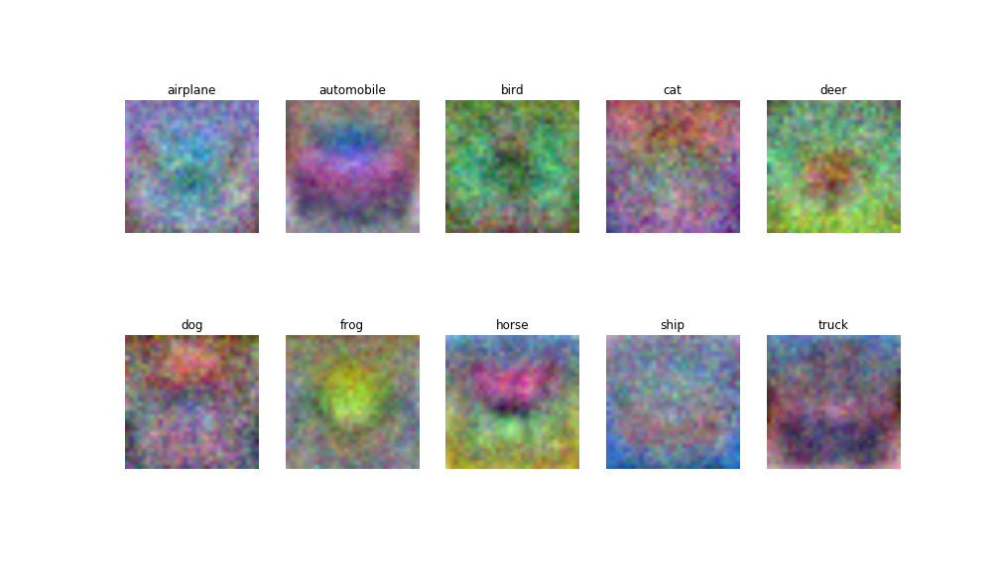

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.417%
- cost:     1.897
Validation:
- accuracy: 37.640%%
- cost:      1.915


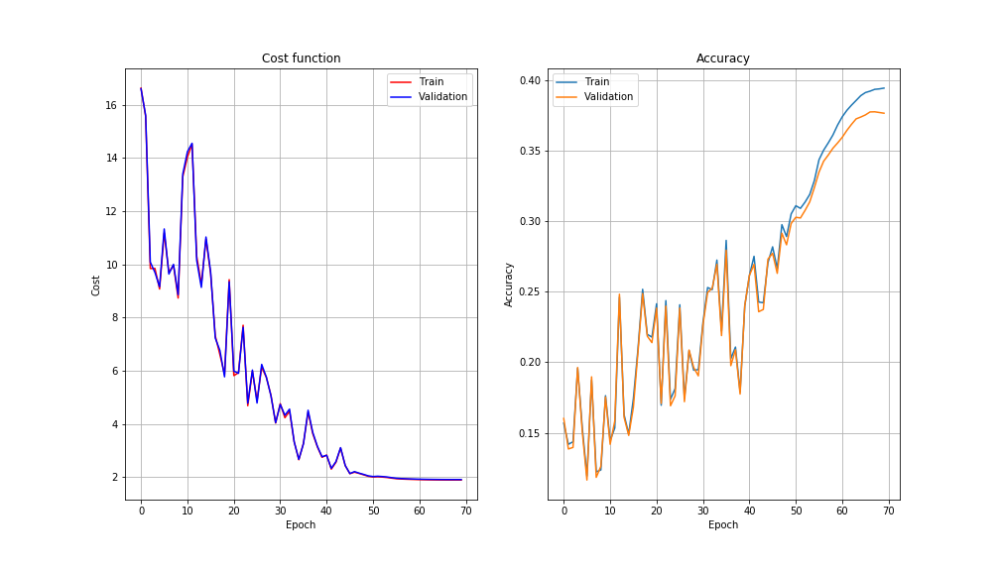

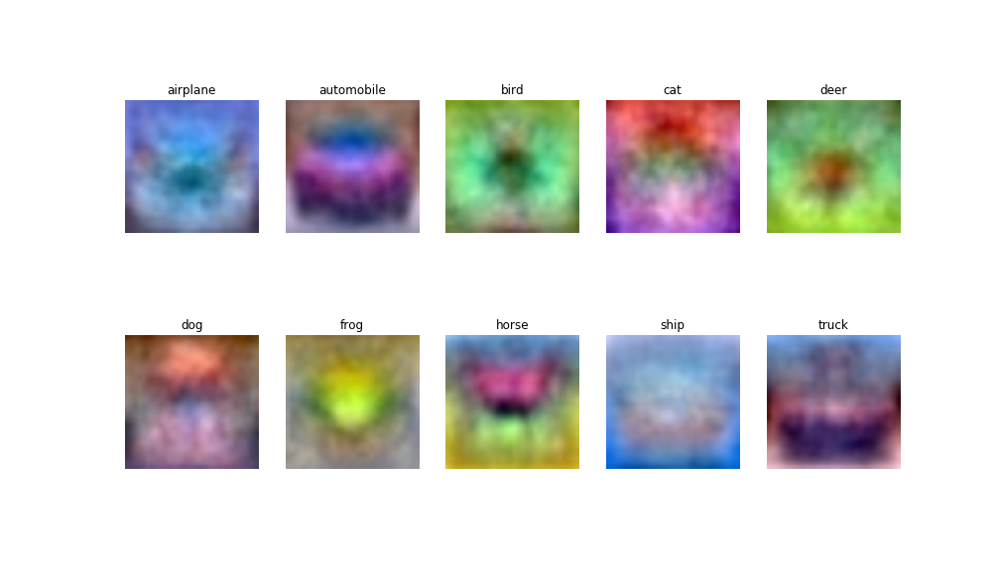

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.385%
- cost:     1.897
Validation:
- accuracy: 37.630%%
- cost:      1.915


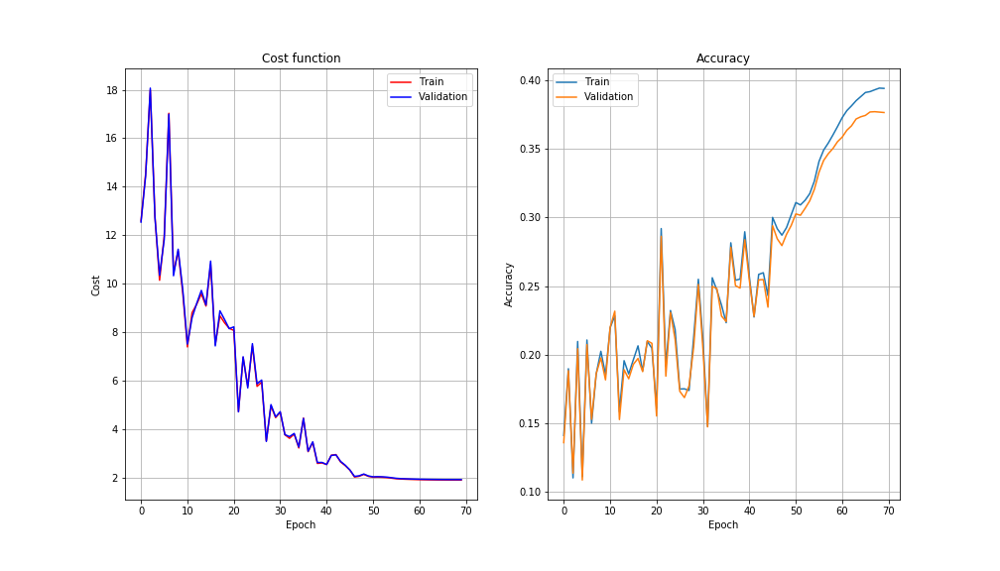

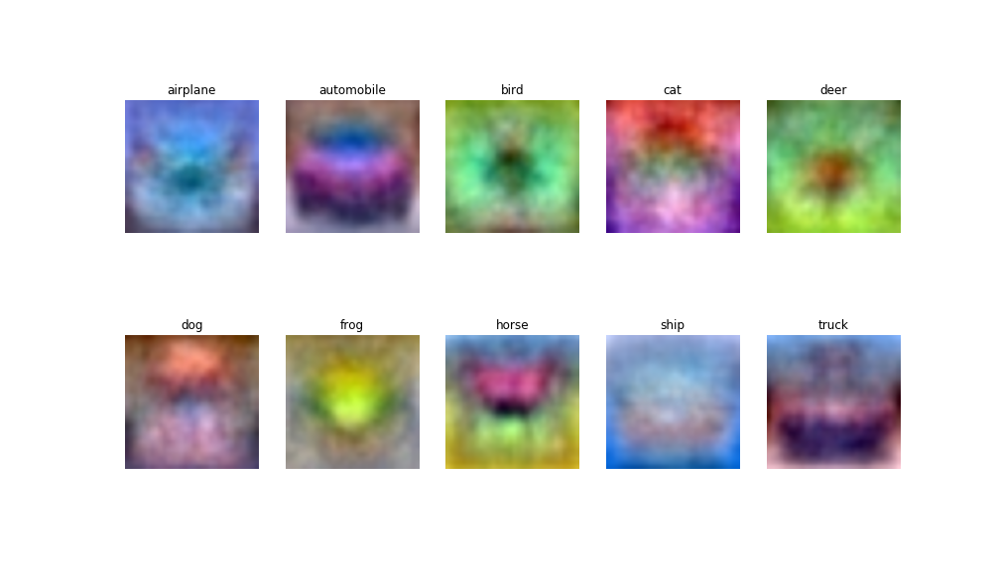

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.297%
- cost:     1.898
Validation:
- accuracy: 37.610%%
- cost:      1.916


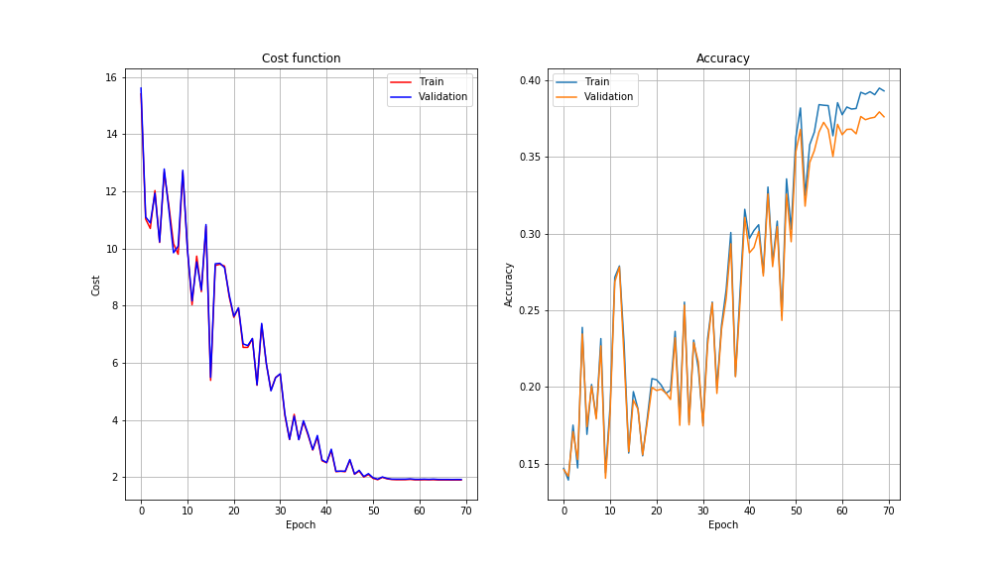

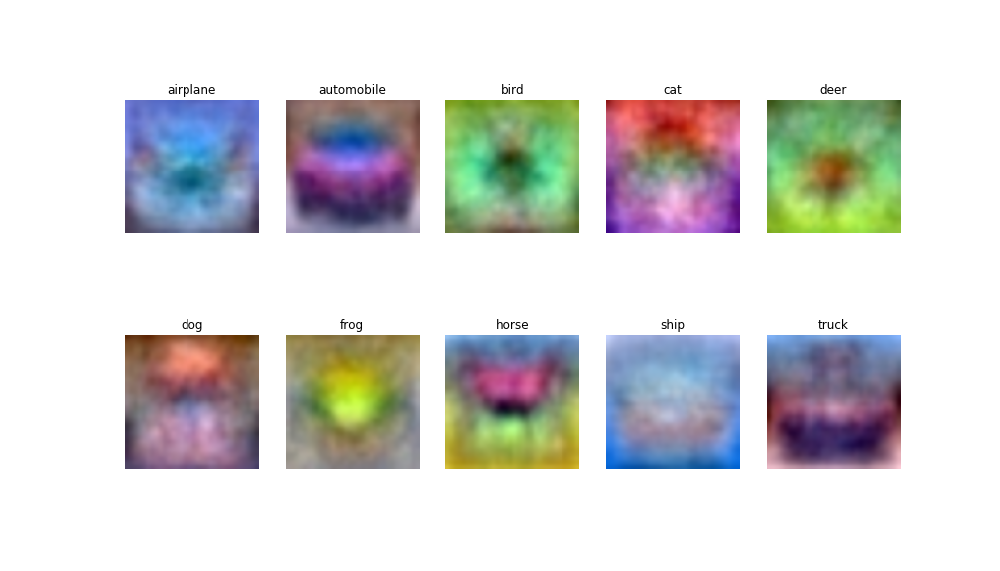

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.365%
- cost:     1.901
Validation:
- accuracy: 37.580%%
- cost:      1.921


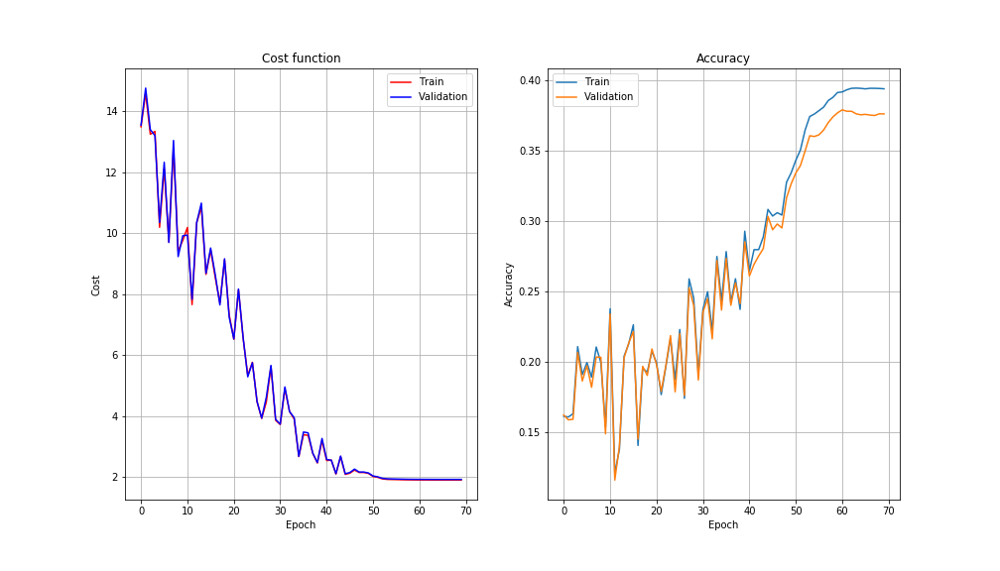

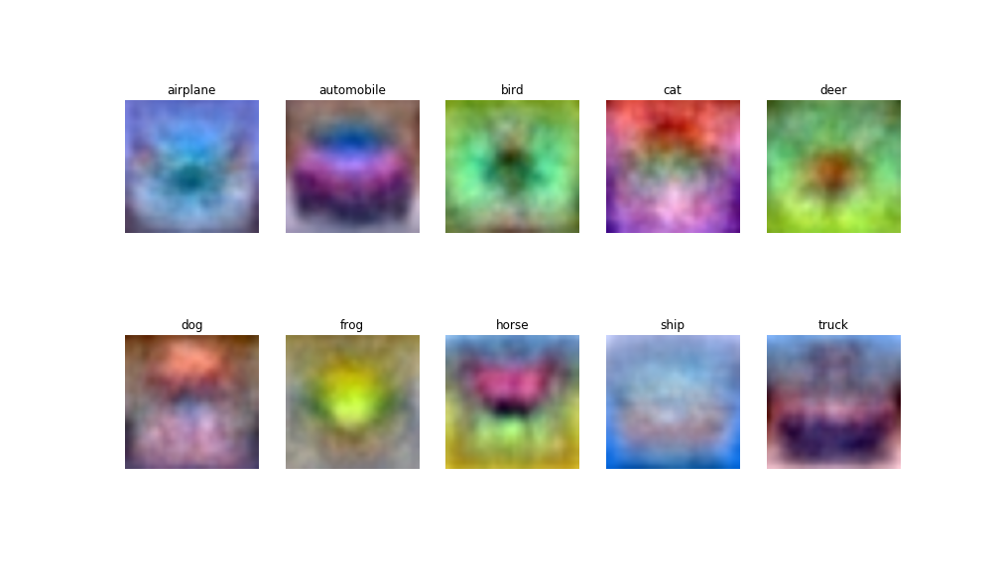

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.258%
- cost:     1.902
Validation:
- accuracy: 37.560%%
- cost:      1.922


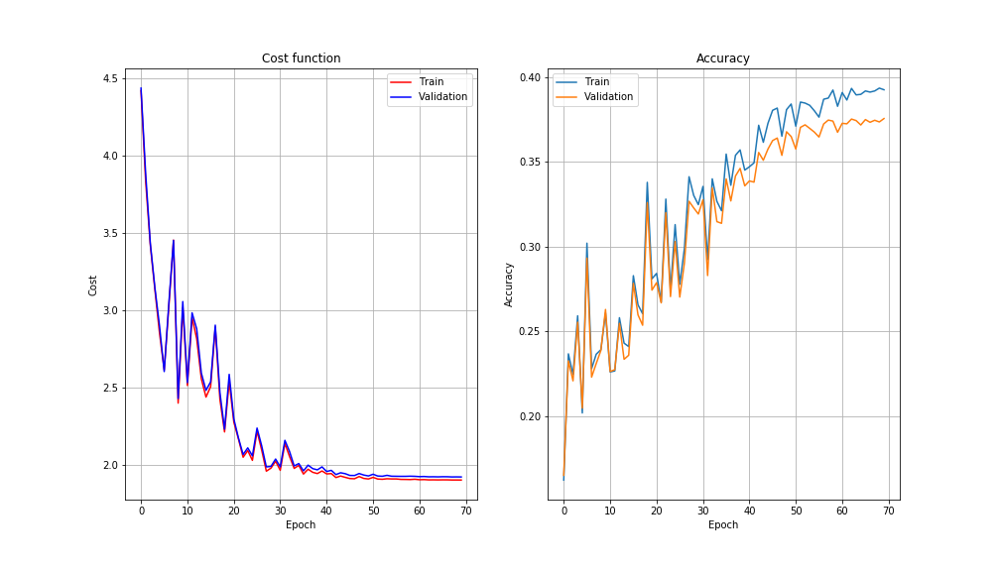

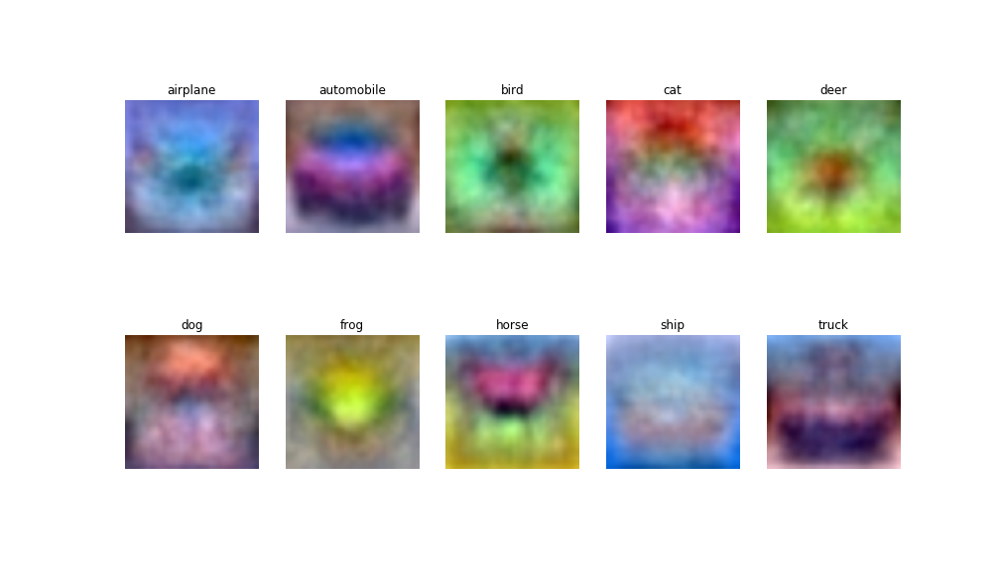

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.425%
- cost:     1.901
Validation:
- accuracy: 37.520%%
- cost:      1.921


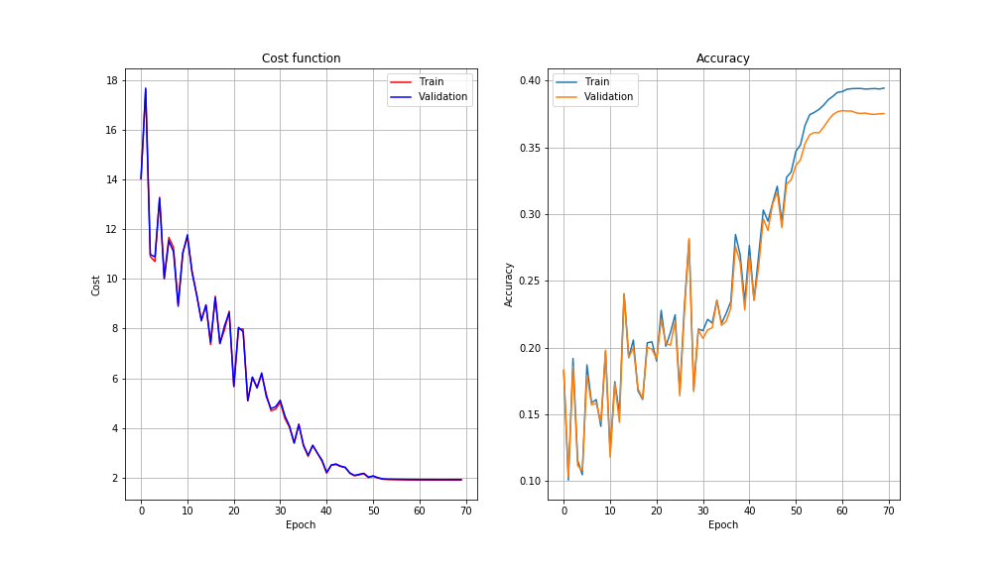

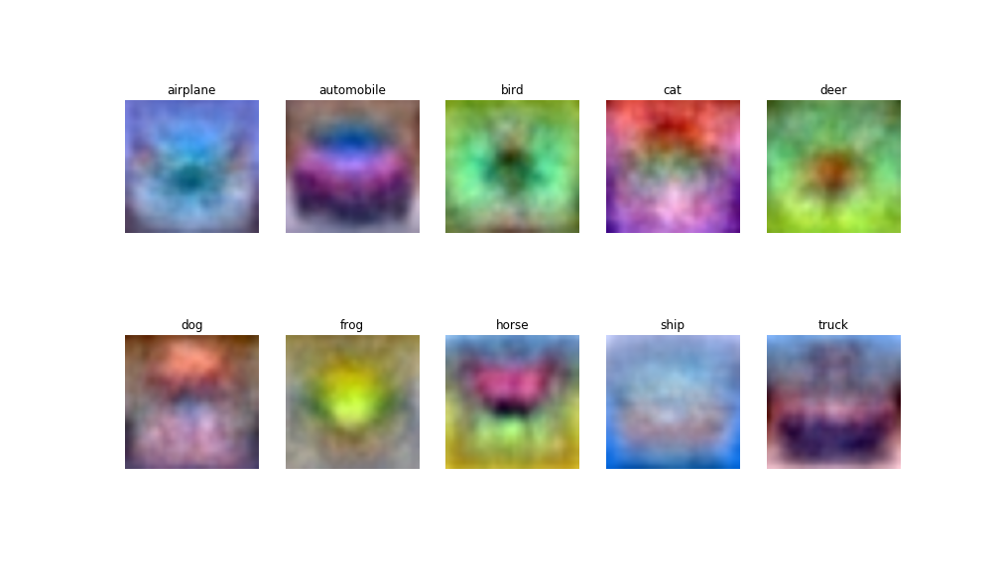

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.260%
- cost:     1.898
Validation:
- accuracy: 37.500%%
- cost:      1.917


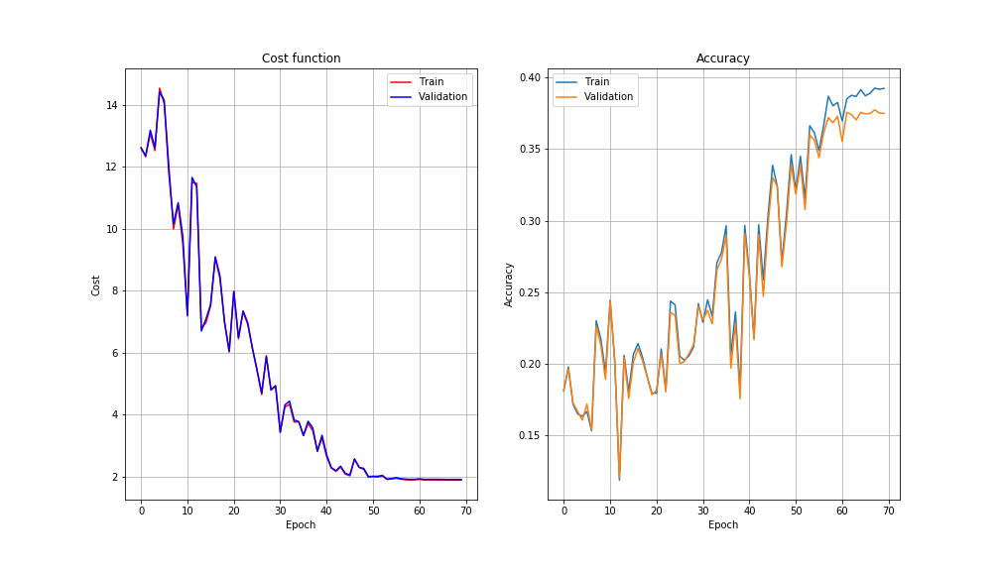

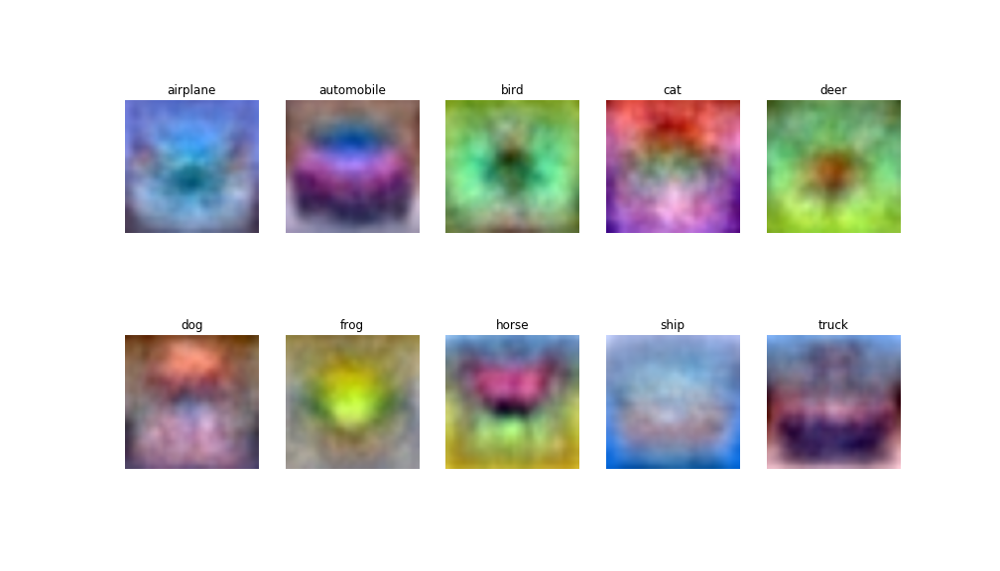

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.370%
- cost:     1.902
Validation:
- accuracy: 37.450%%
- cost:      1.922


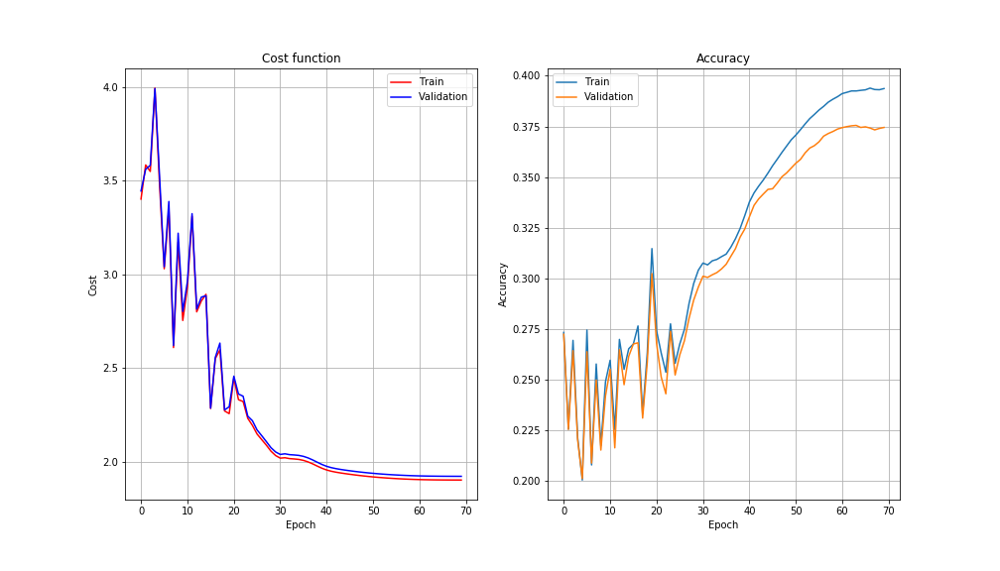

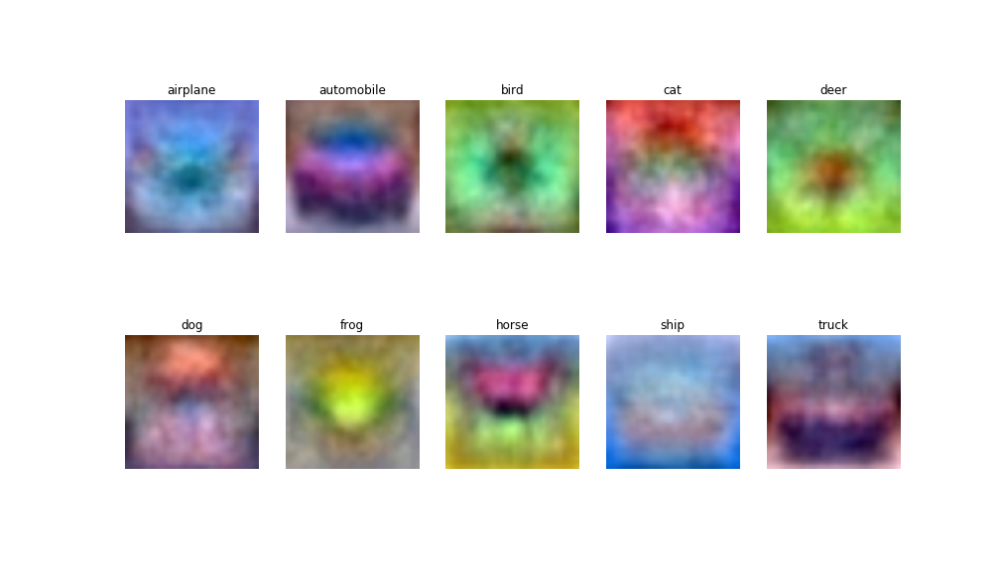

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.270%
- cost:     1.901
Validation:
- accuracy: 37.450%%
- cost:      1.921


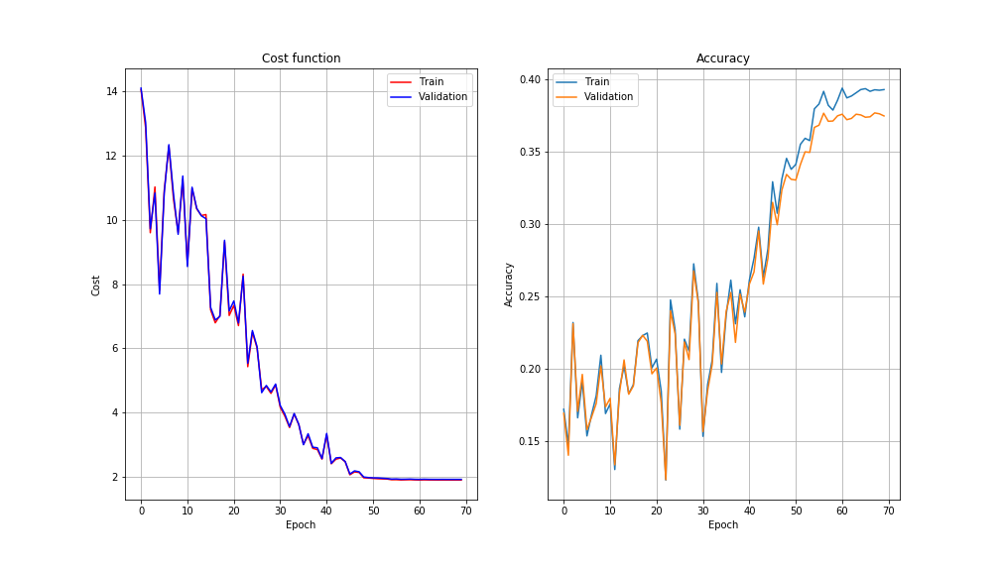

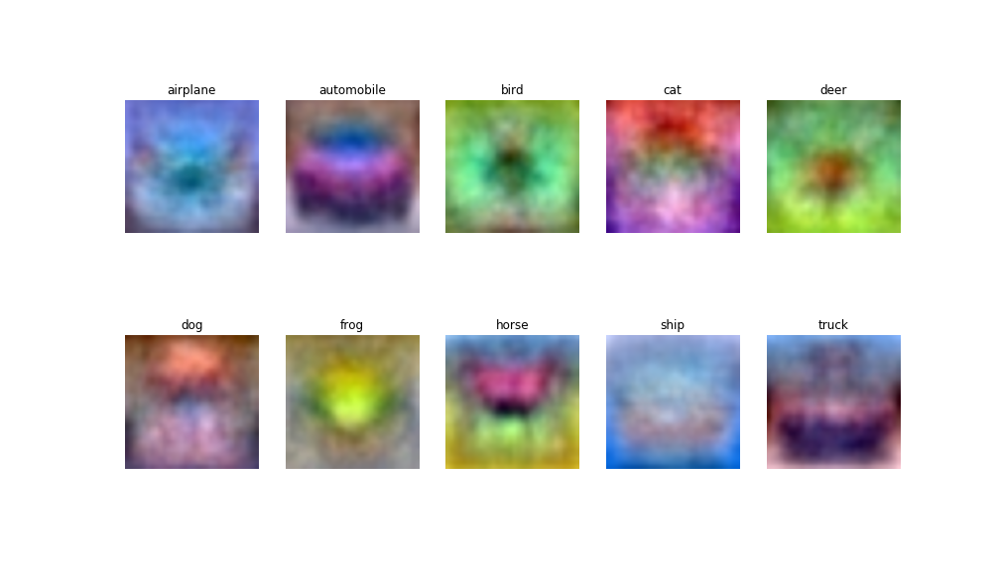

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.345%
- cost:     1.902
Validation:
- accuracy: 37.420%%
- cost:      1.922


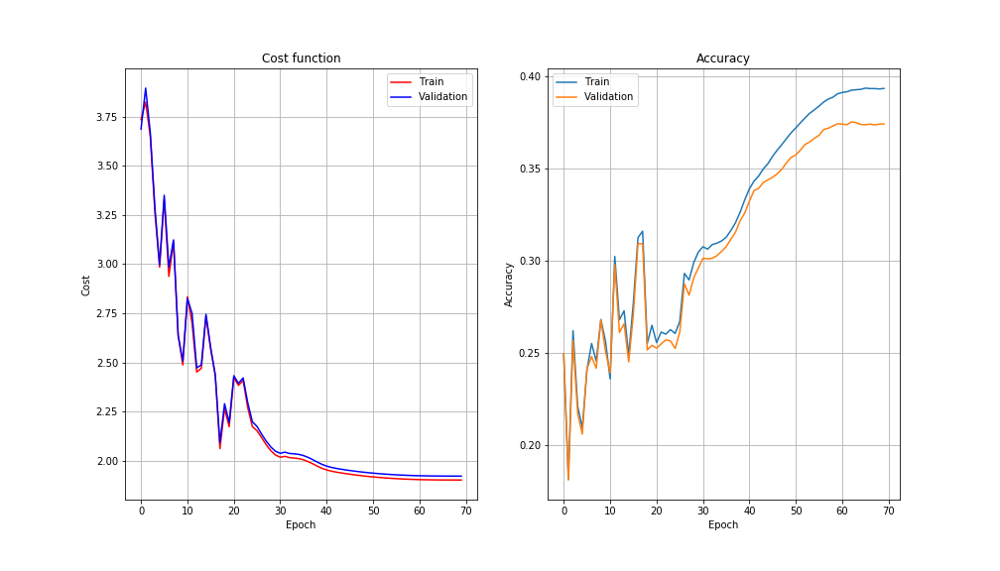

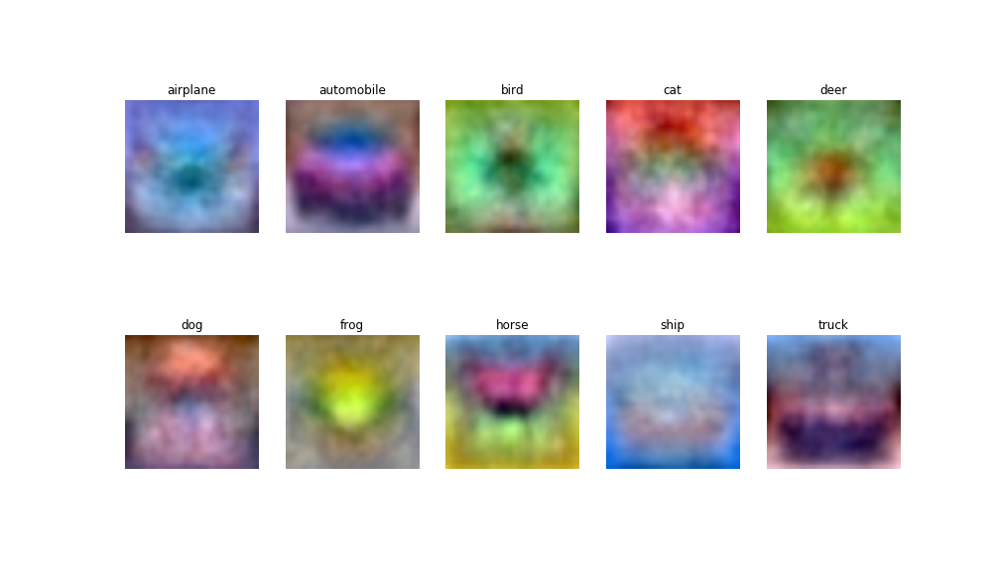

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.185%
- cost:     1.902
Validation:
- accuracy: 37.370%%
- cost:      1.922


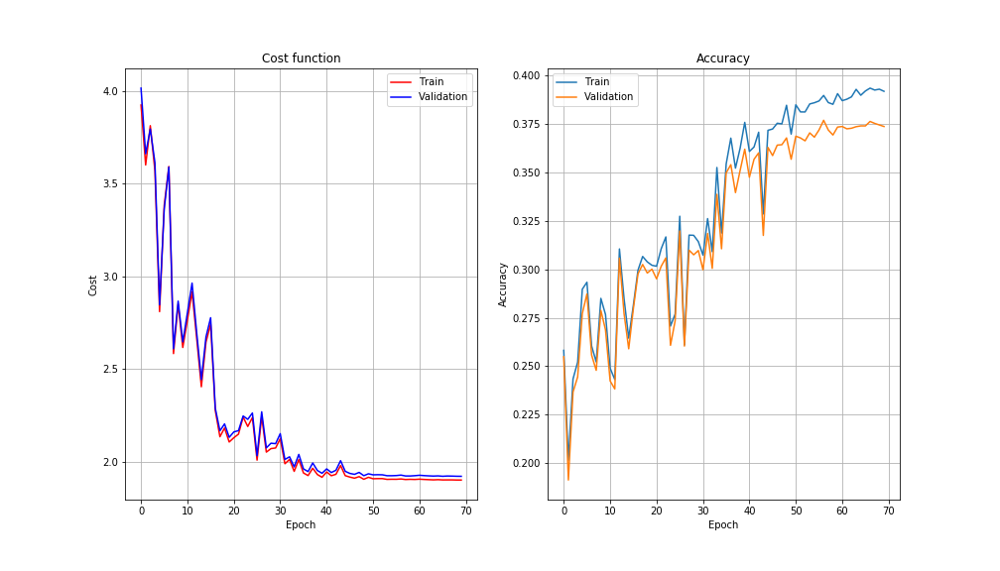

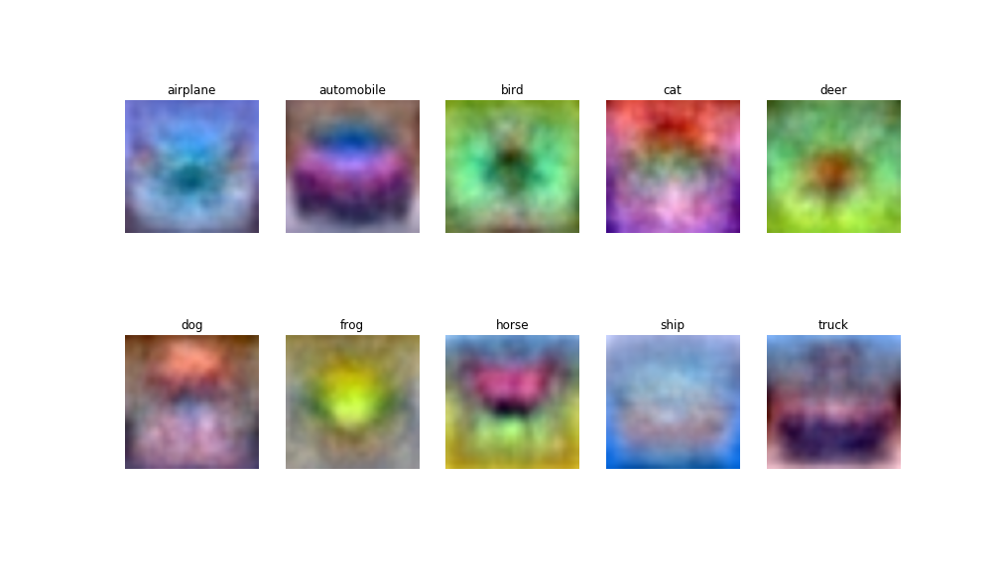

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.230%
- cost:     1.901
Validation:
- accuracy: 37.350%%
- cost:      1.921


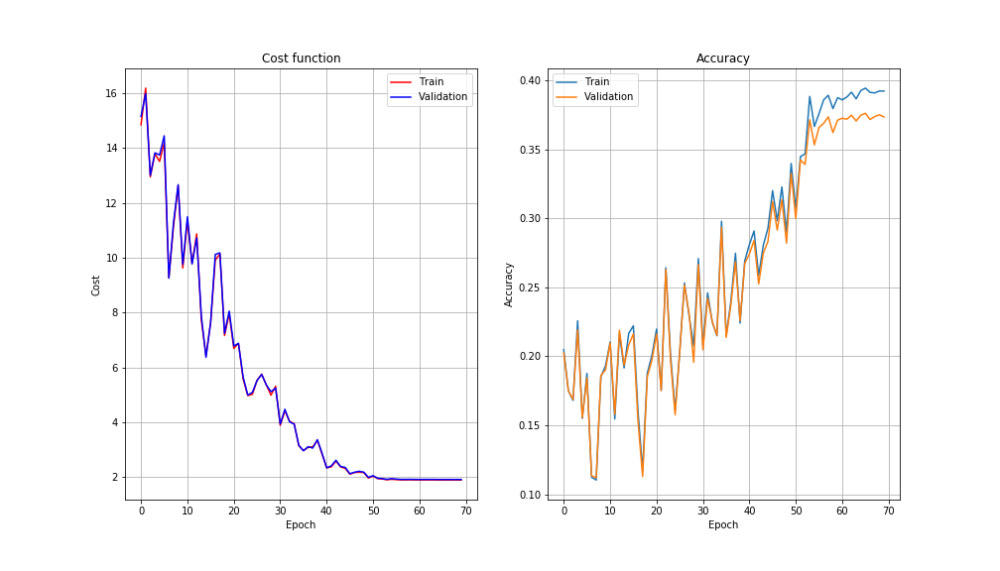

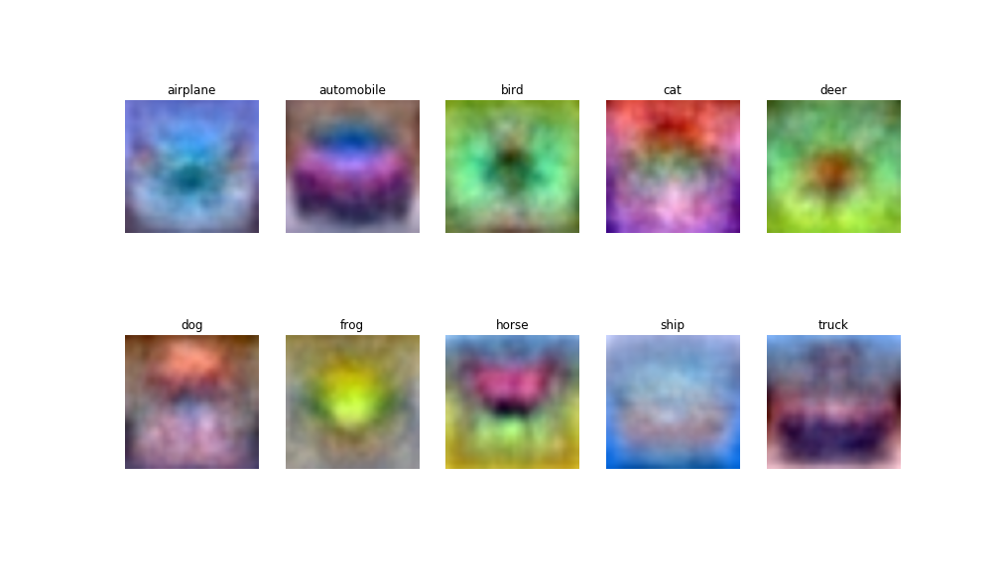

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.198%
- cost:     1.906
Validation:
- accuracy: 37.310%%
- cost:      1.927


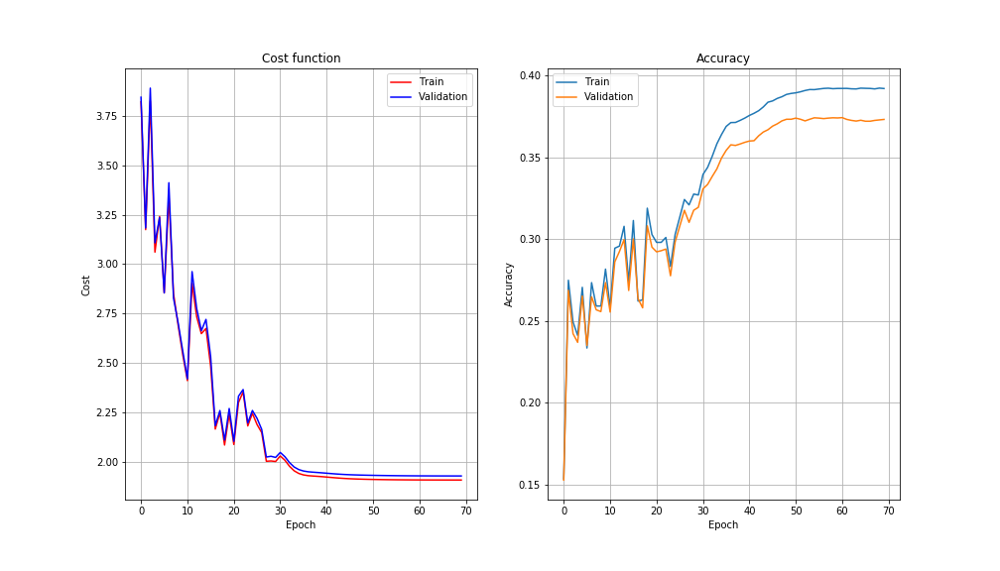

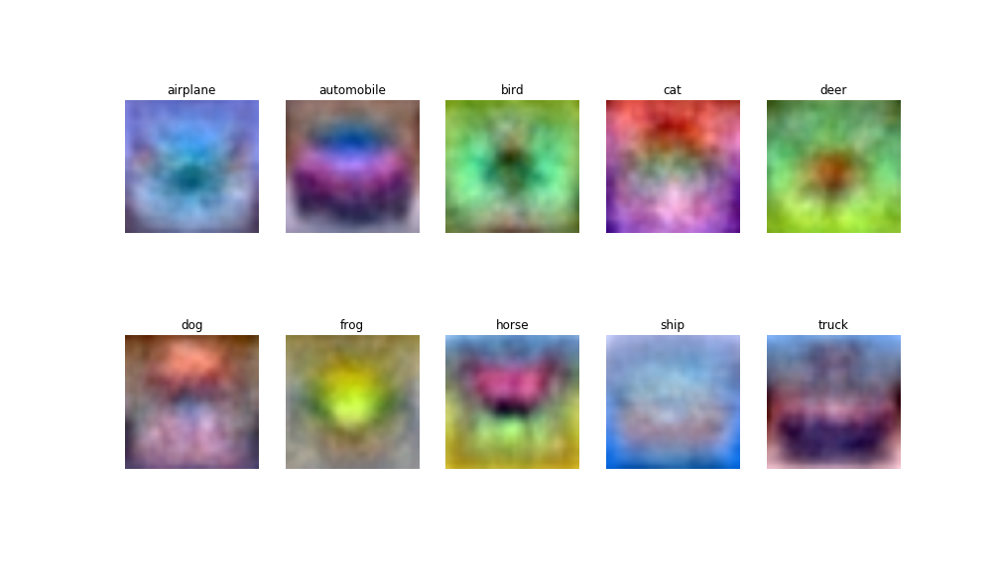

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	False
Training:
- accuracy: 39.180%
- cost:     1.906
Validation:
- accuracy: 37.280%%
- cost:      1.927


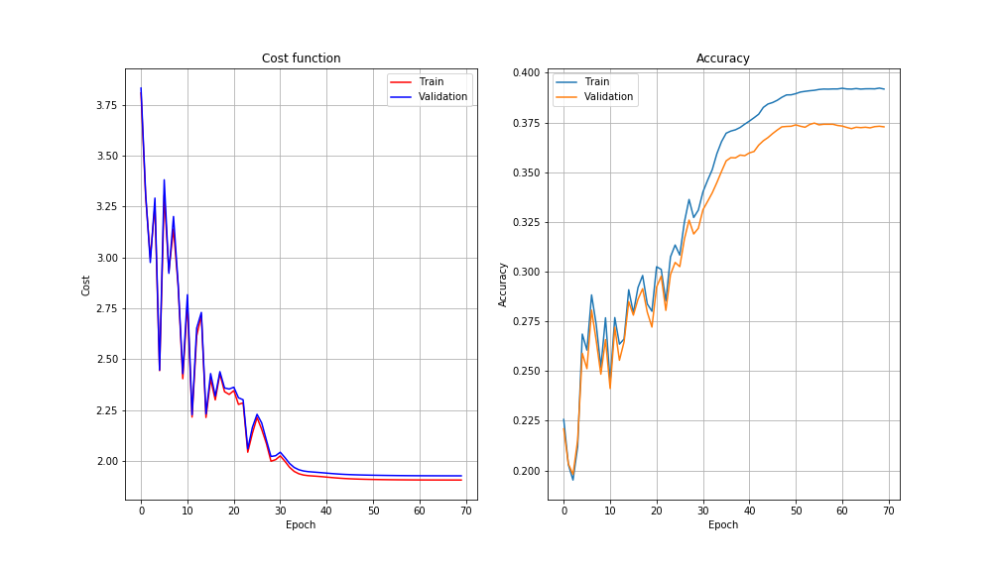

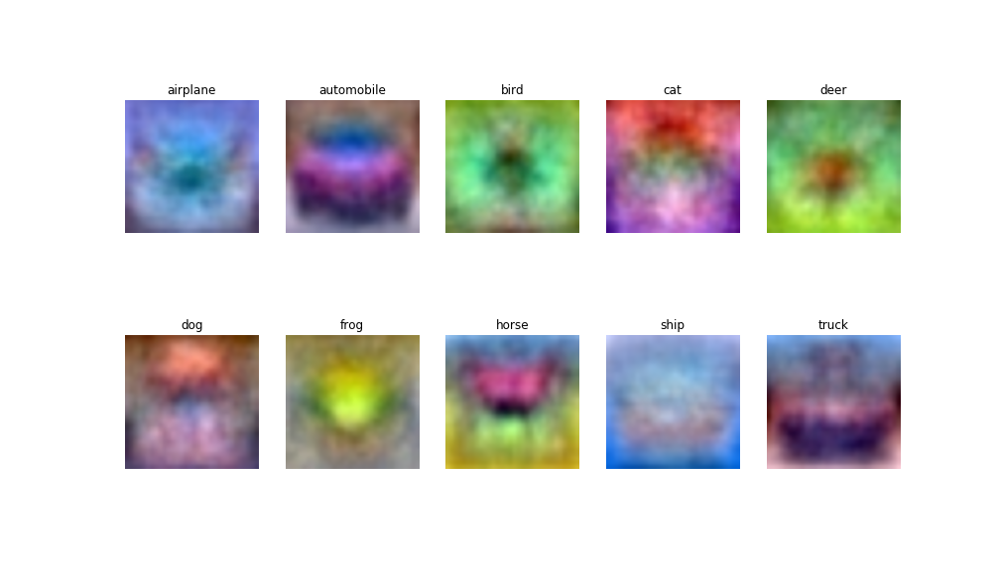

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.108%
- cost:     1.906
Validation:
- accuracy: 37.270%%
- cost:      1.927


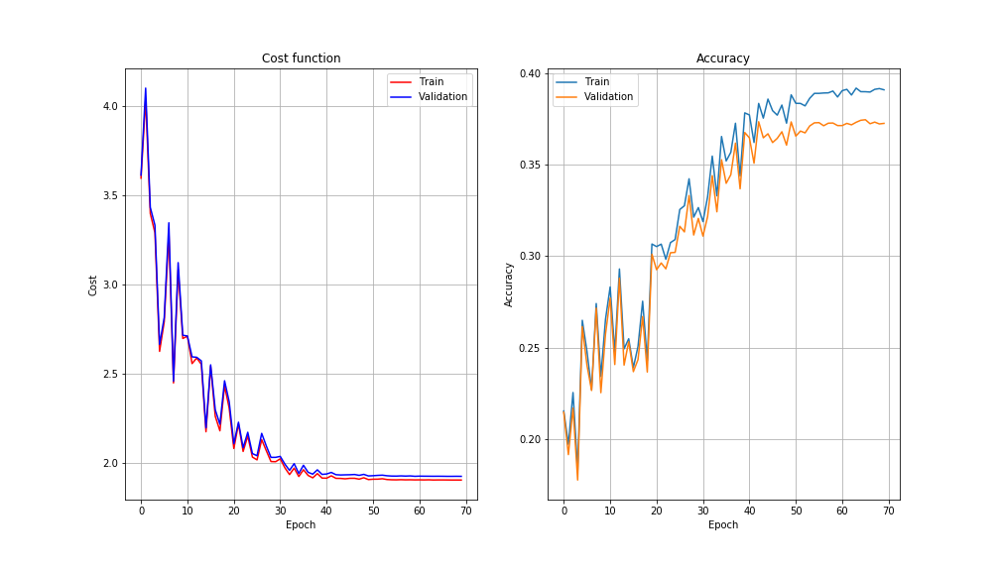

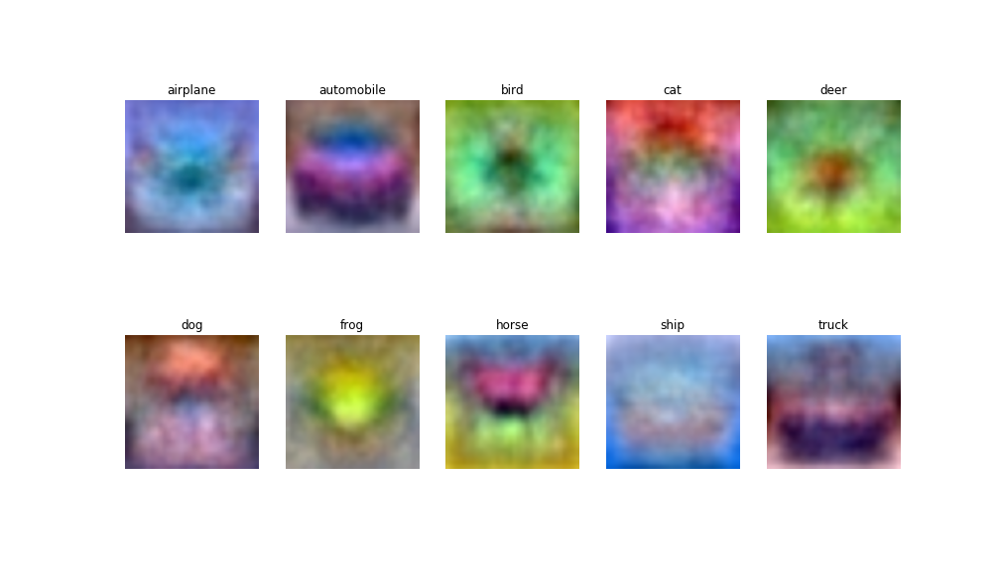

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.050
- shuffle	True
Training:
- accuracy: 39.143%
- cost:     1.906
Validation:
- accuracy: 37.260%%
- cost:      1.927


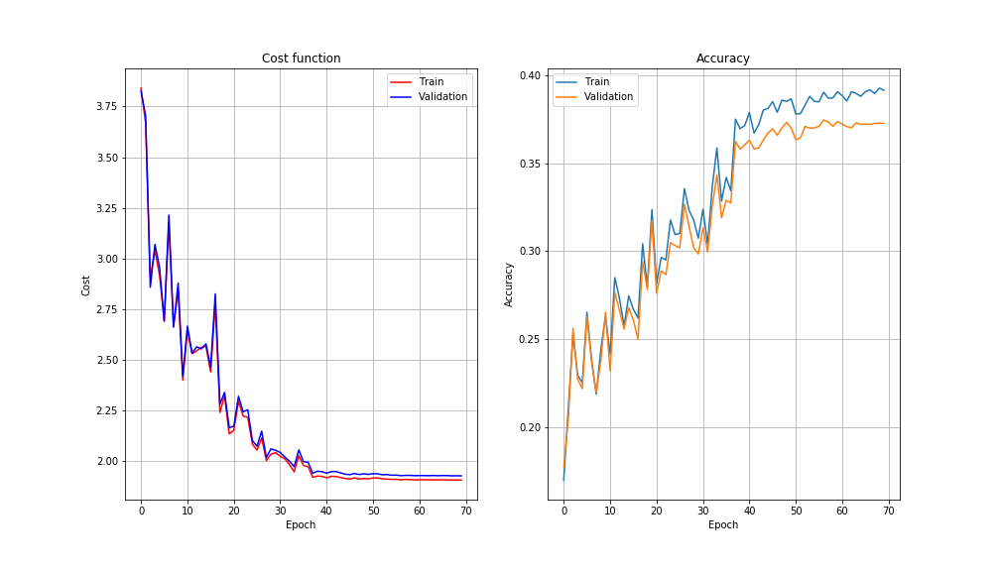

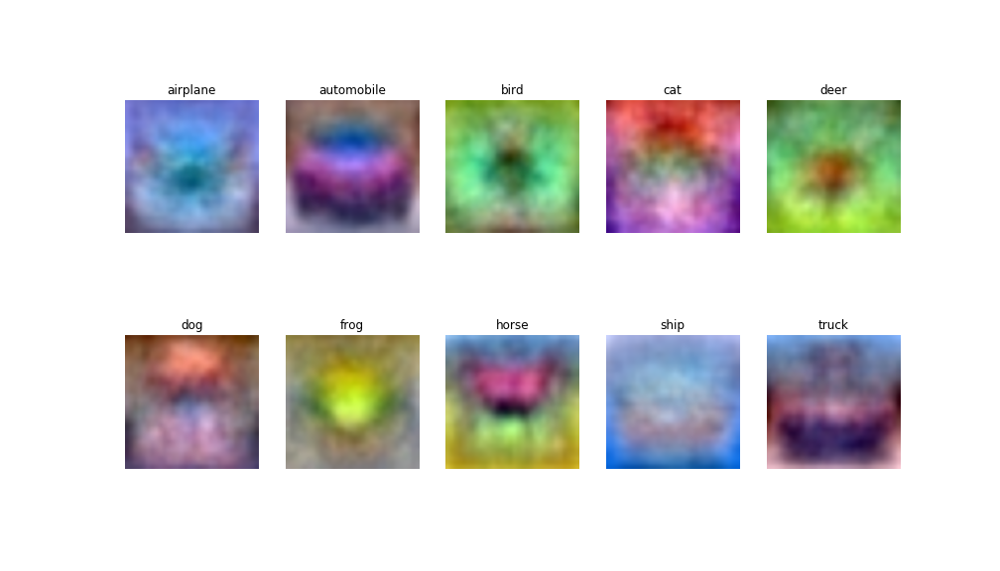

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.728%
- cost:     1.957
Validation:
- accuracy: 37.030%%
- cost:      1.968


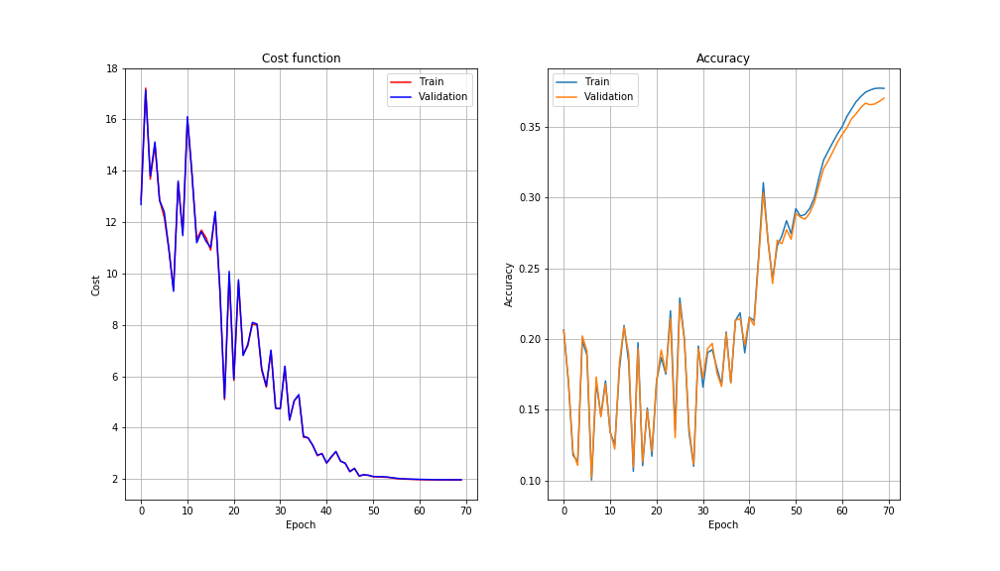

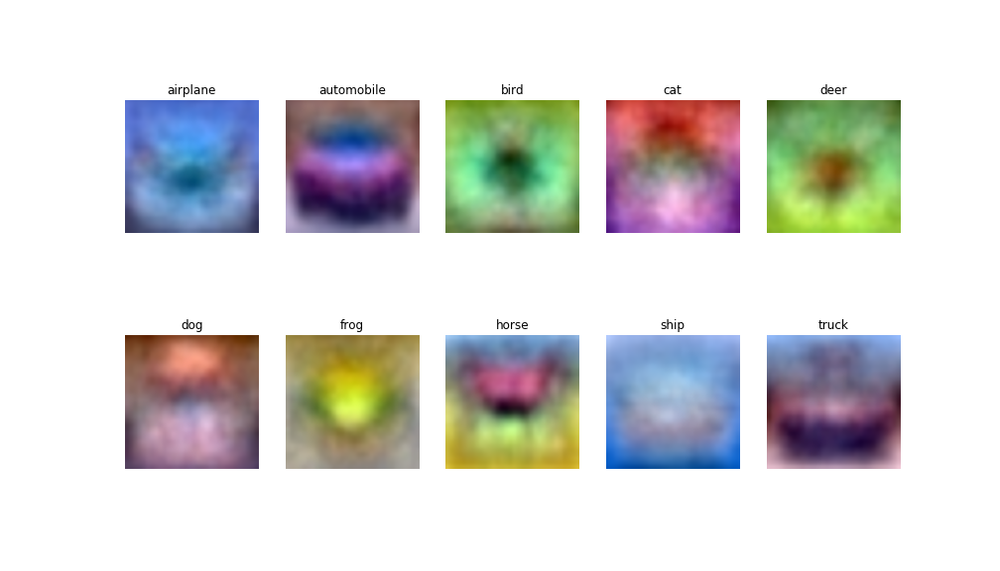

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.780%
- cost:     1.957
Validation:
- accuracy: 36.970%%
- cost:      1.968


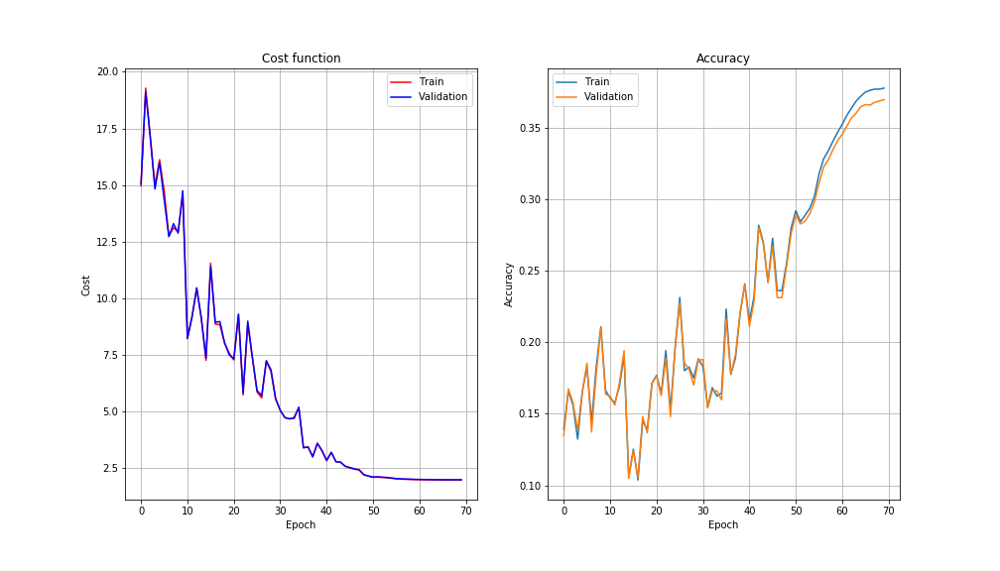

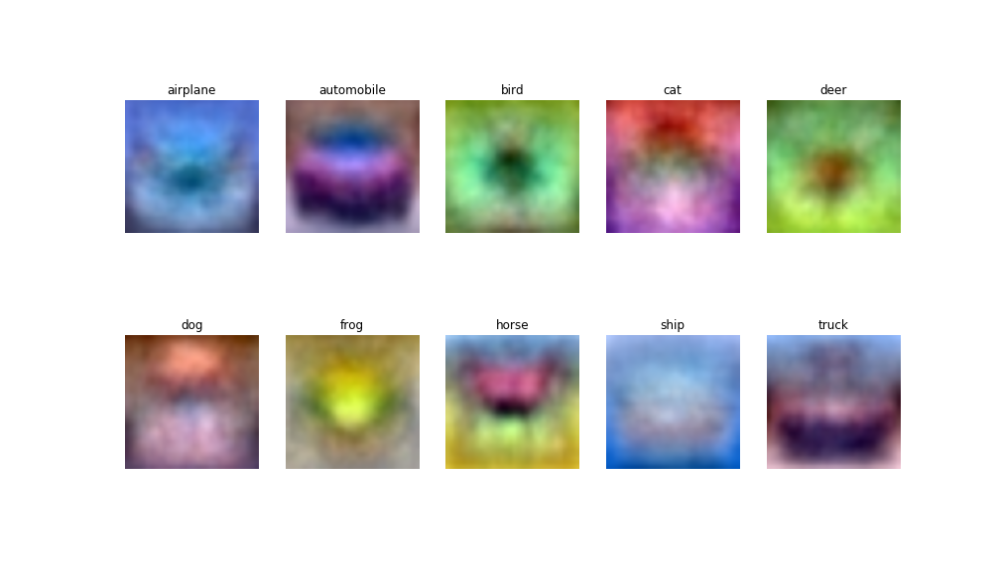

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 38.017%
- cost:     1.957
Validation:
- accuracy: 36.890%%
- cost:      1.969


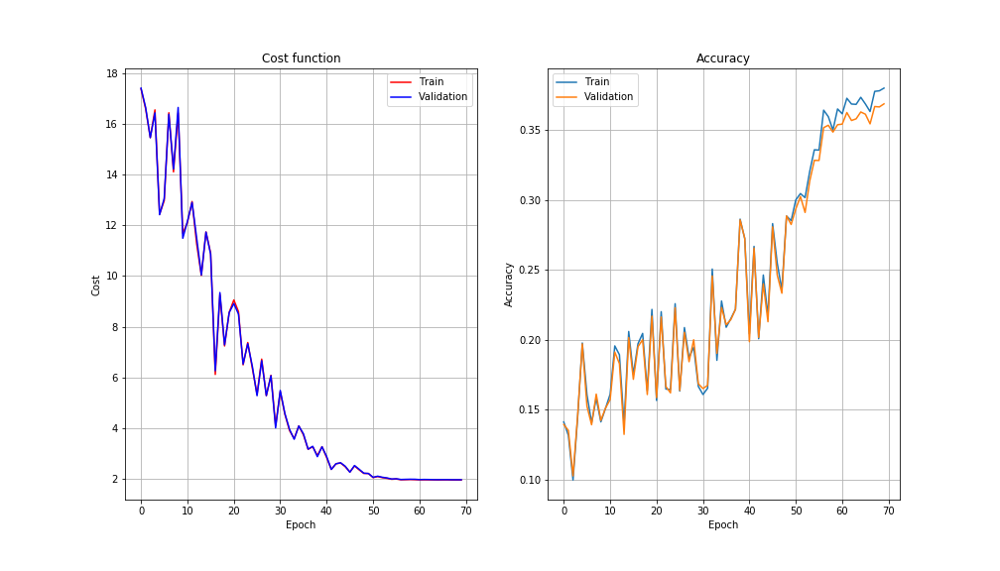

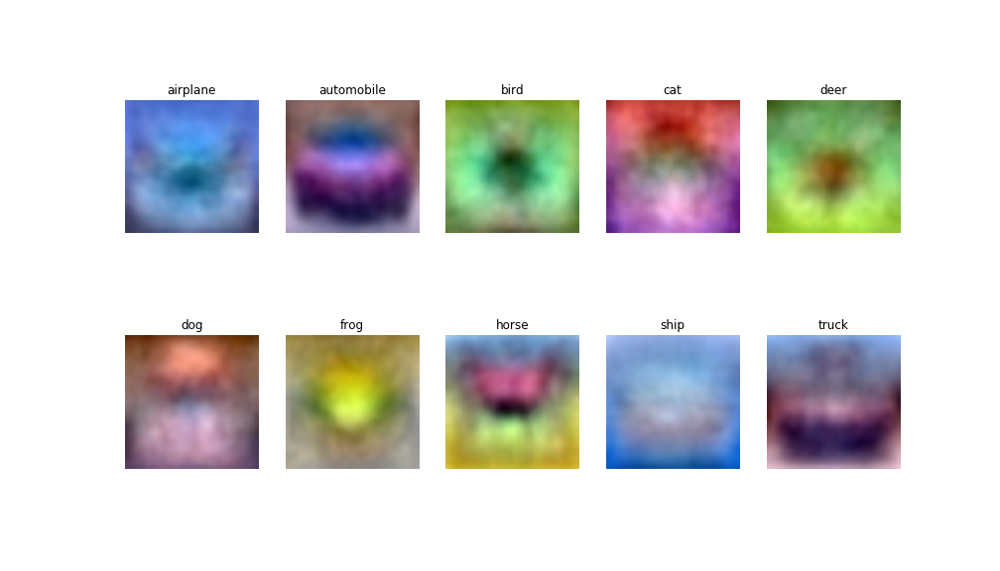

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.825%
- cost:     1.961
Validation:
- accuracy: 36.850%%
- cost:      1.973


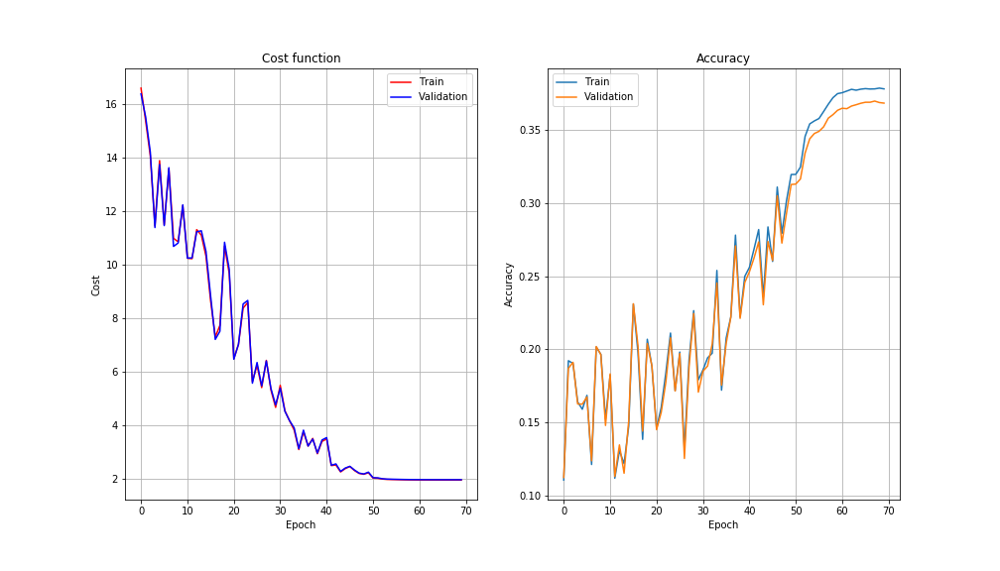

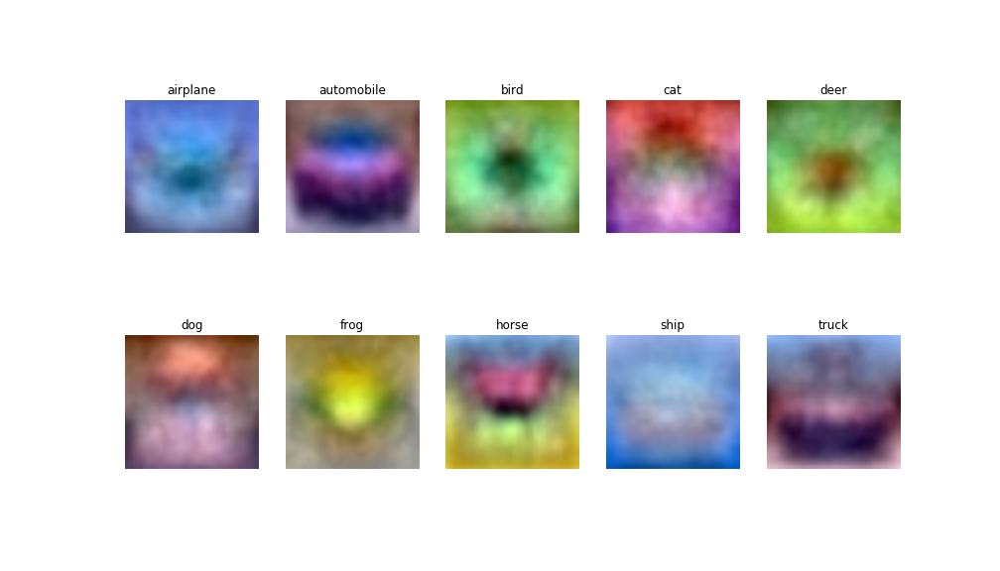

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.905%
- cost:     1.957
Validation:
- accuracy: 36.840%%
- cost:      1.969


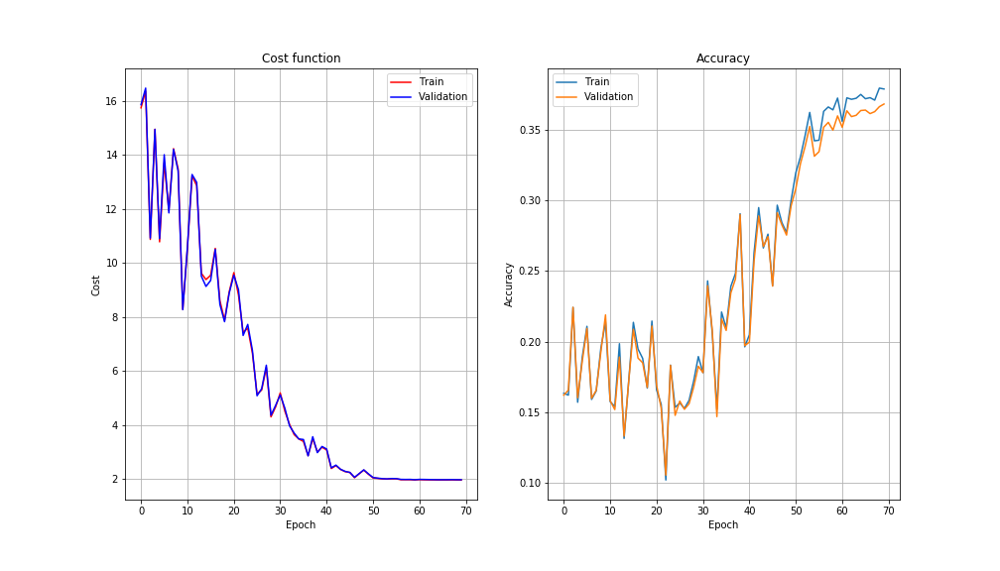

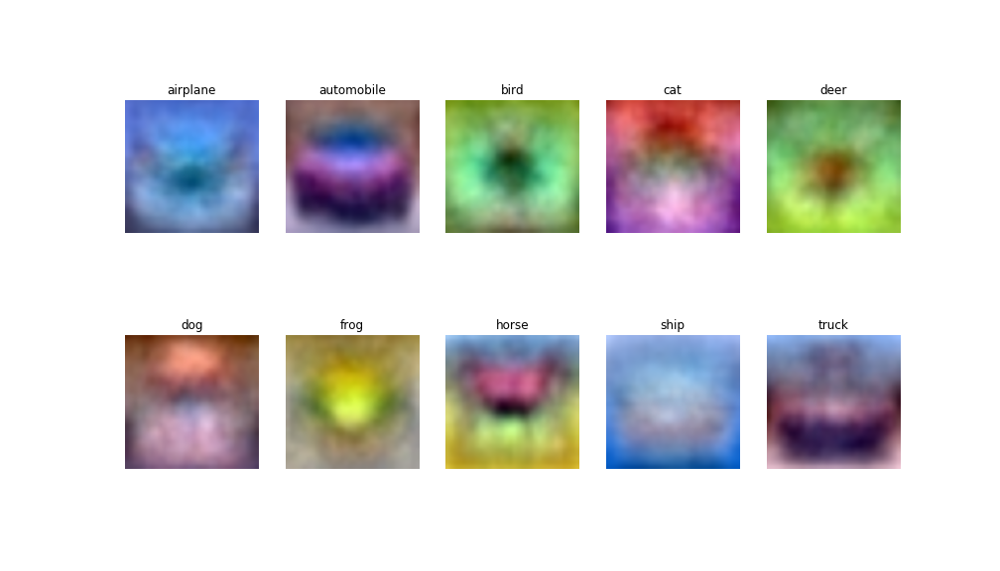

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.858%
- cost:     1.961
Validation:
- accuracy: 36.800%%
- cost:      1.973


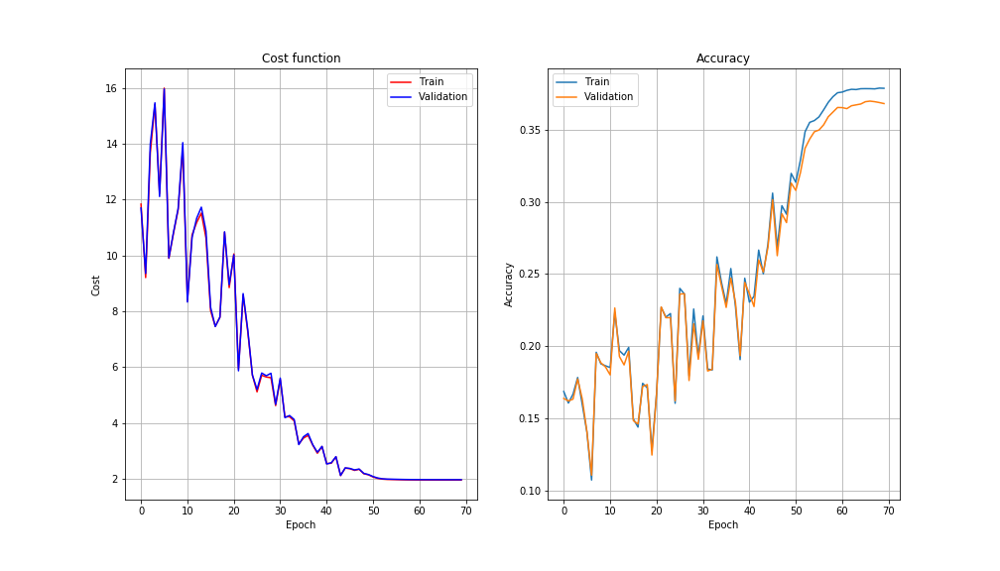

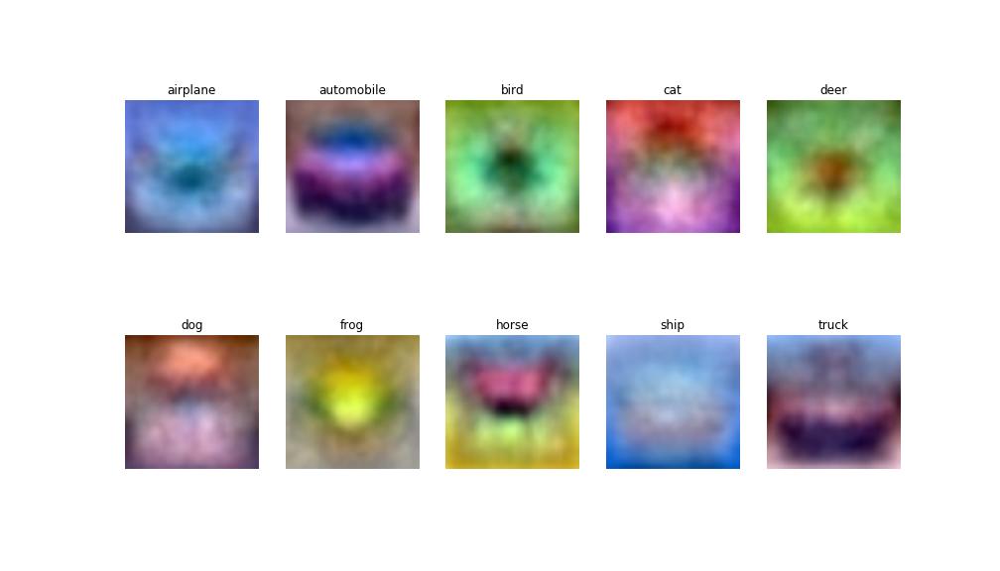

Model trained with:
- initial eta	0.100
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.935%
- cost:     1.961
Validation:
- accuracy: 36.790%%
- cost:      1.974


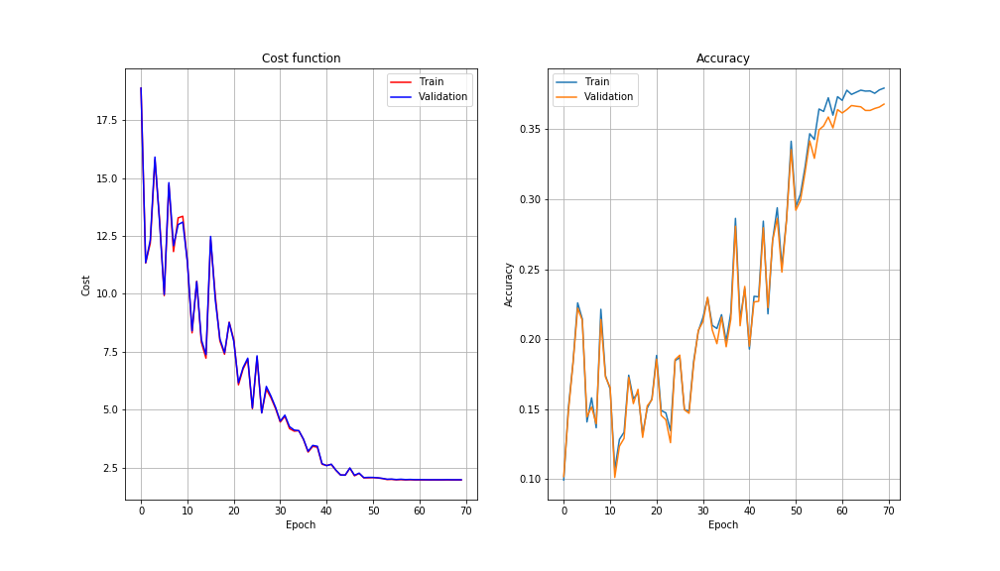

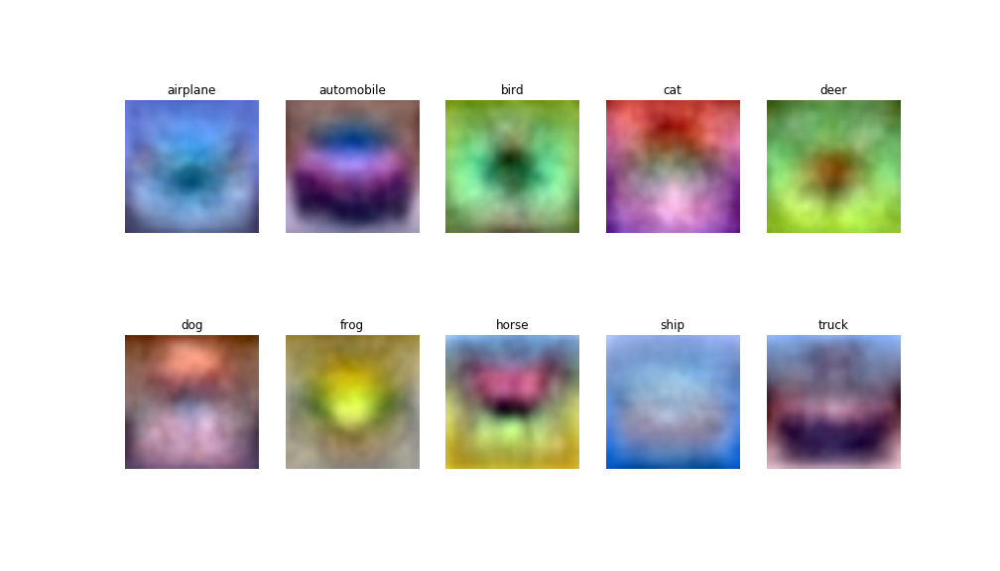

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.865%
- cost:     1.962
Validation:
- accuracy: 36.740%%
- cost:      1.975


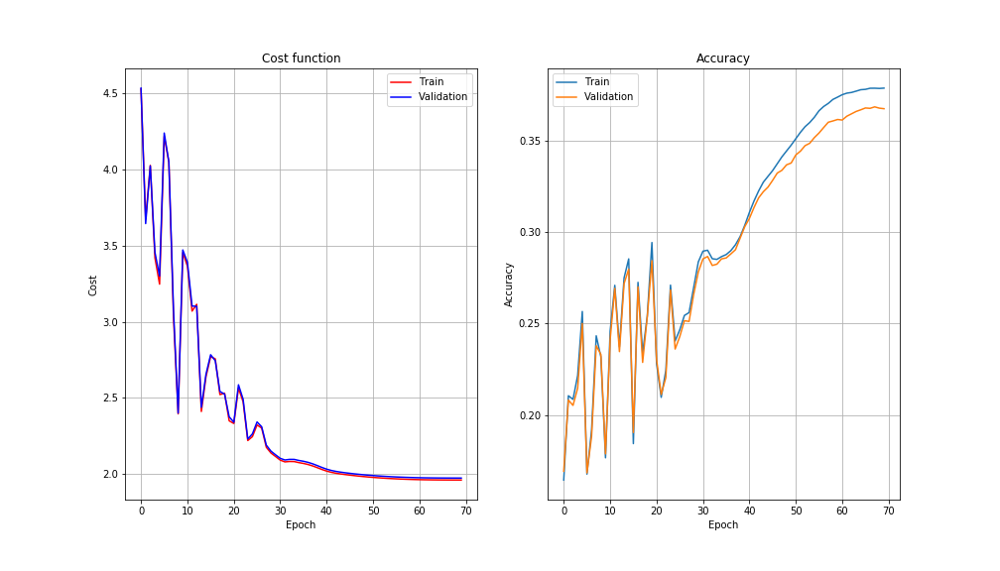

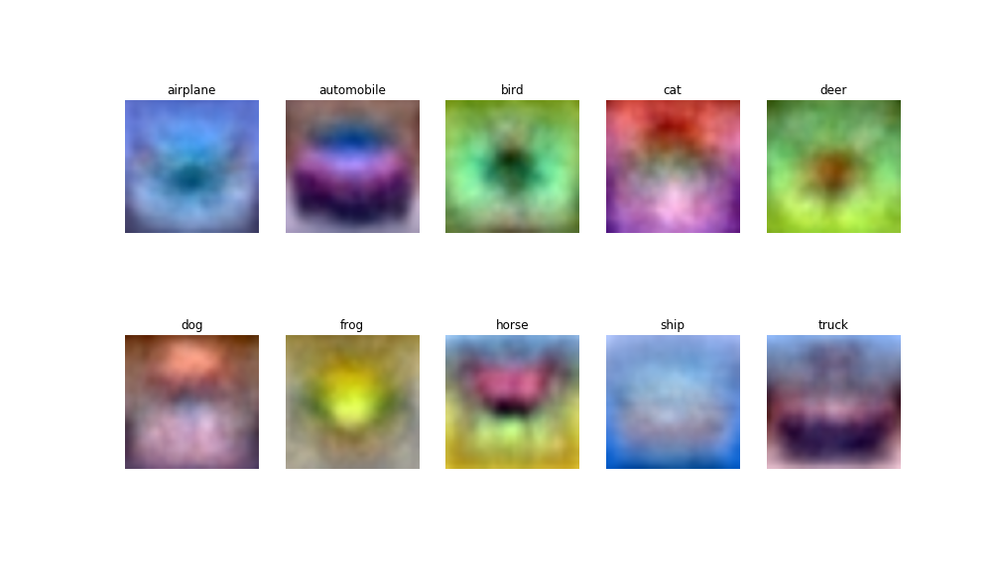

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.925%
- cost:     1.962
Validation:
- accuracy: 36.730%%
- cost:      1.975


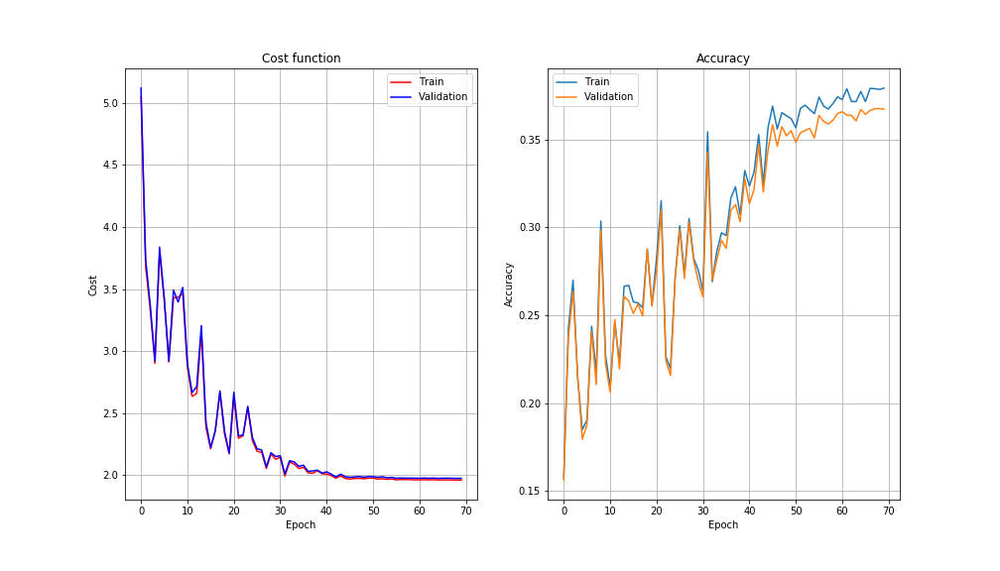

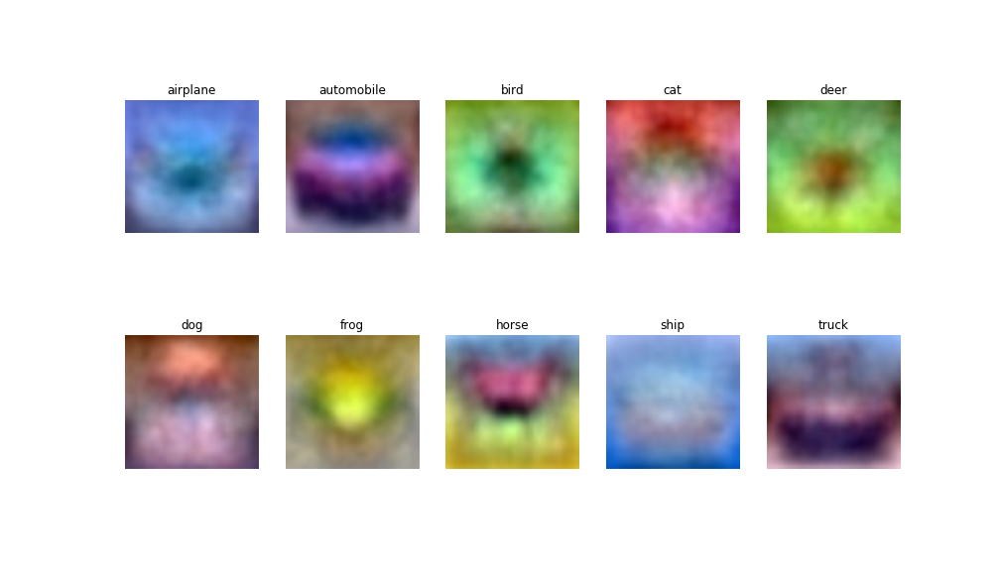

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.850%
- cost:     1.962
Validation:
- accuracy: 36.670%%
- cost:      1.975


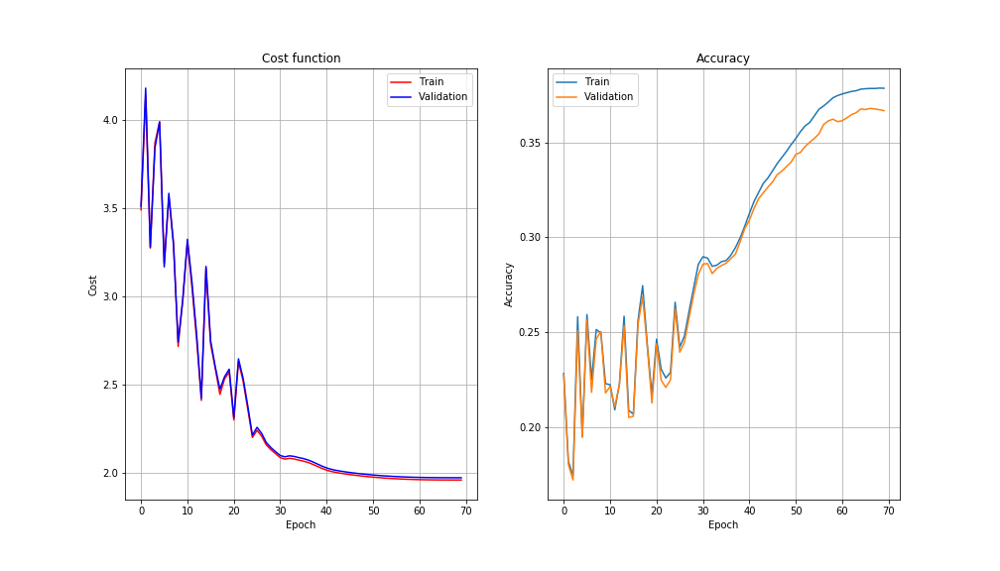

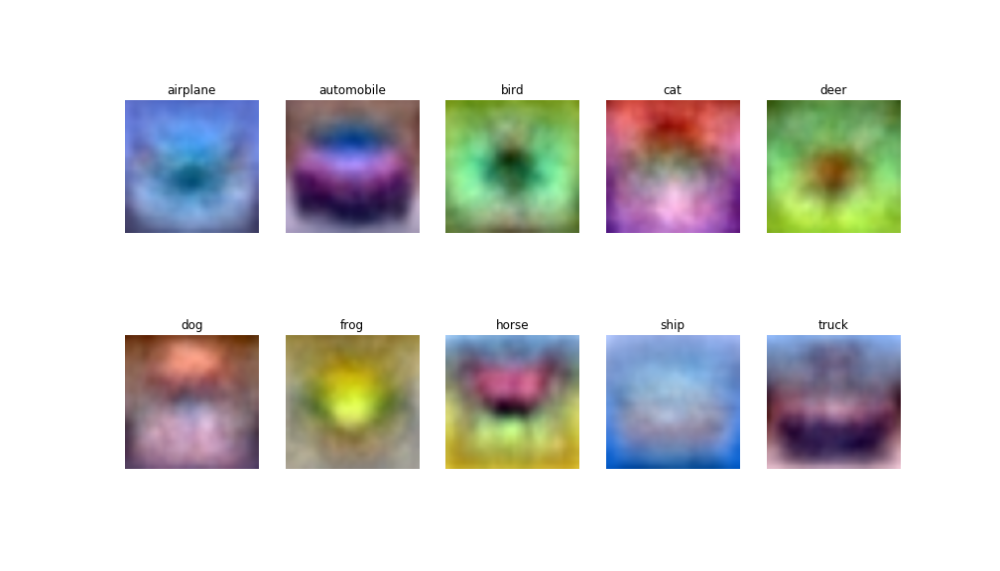

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.885%
- cost:     1.961
Validation:
- accuracy: 36.640%%
- cost:      1.973


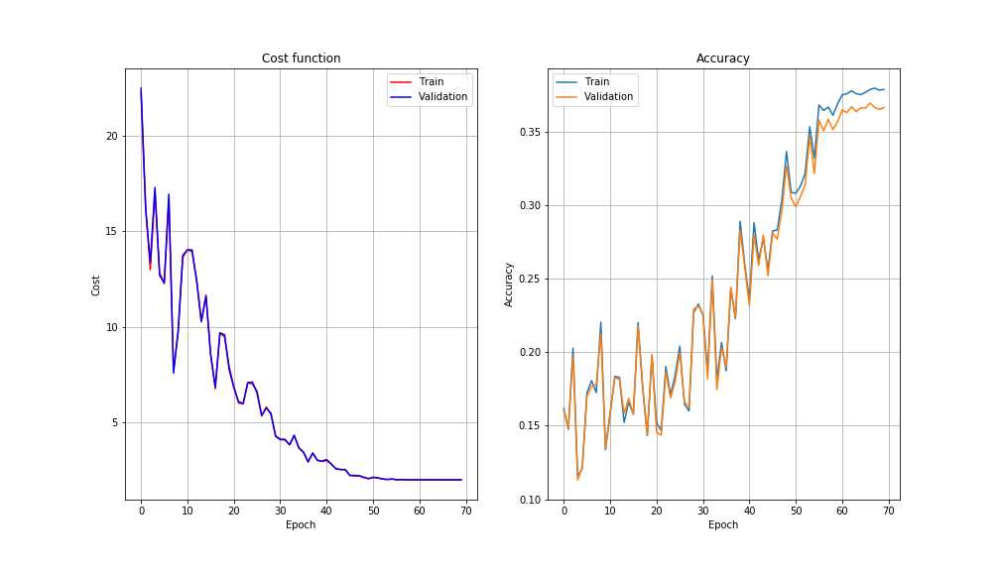

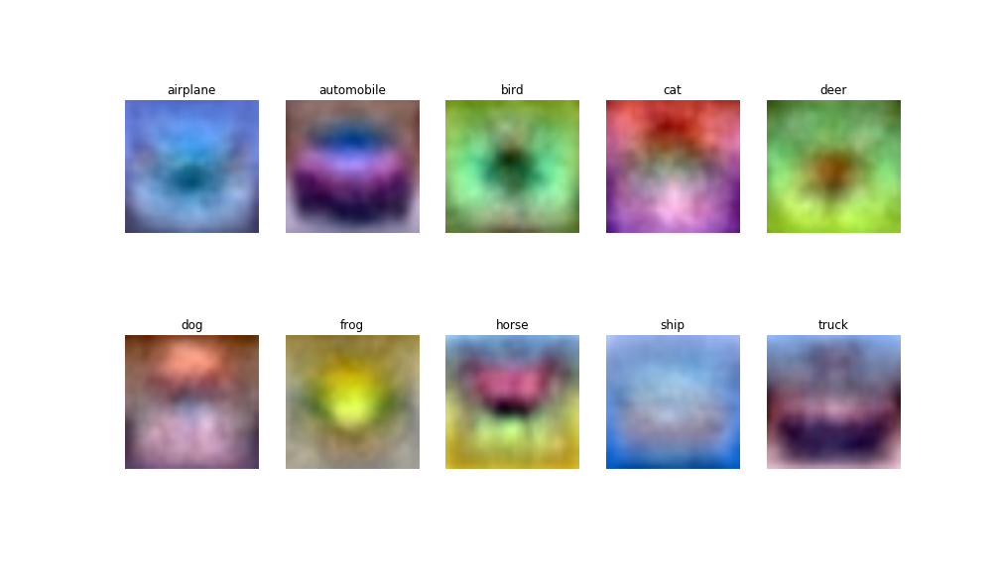

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.862%
- cost:     1.962
Validation:
- accuracy: 36.610%%
- cost:      1.975


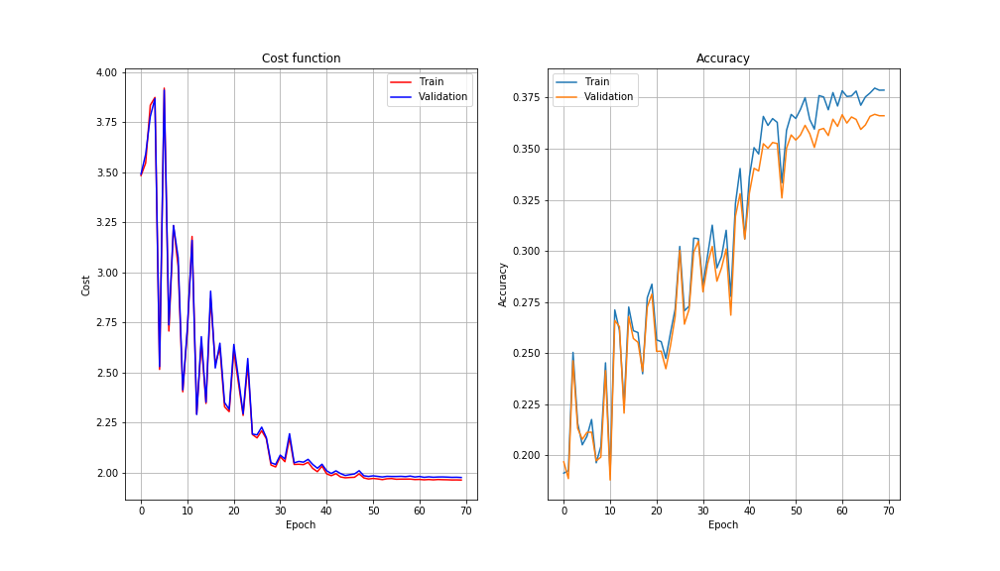

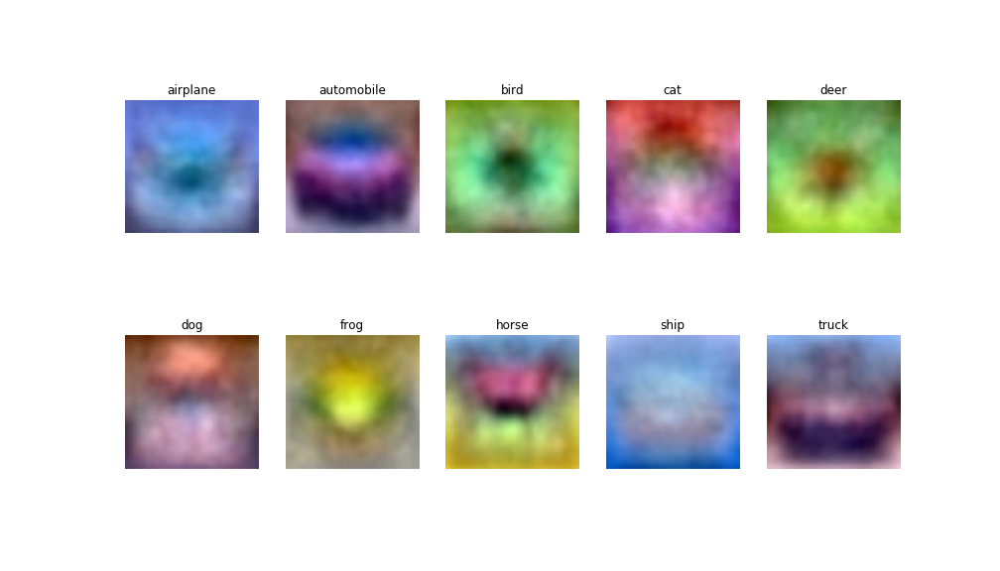

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.817%
- cost:     1.967
Validation:
- accuracy: 36.500%%
- cost:      1.980


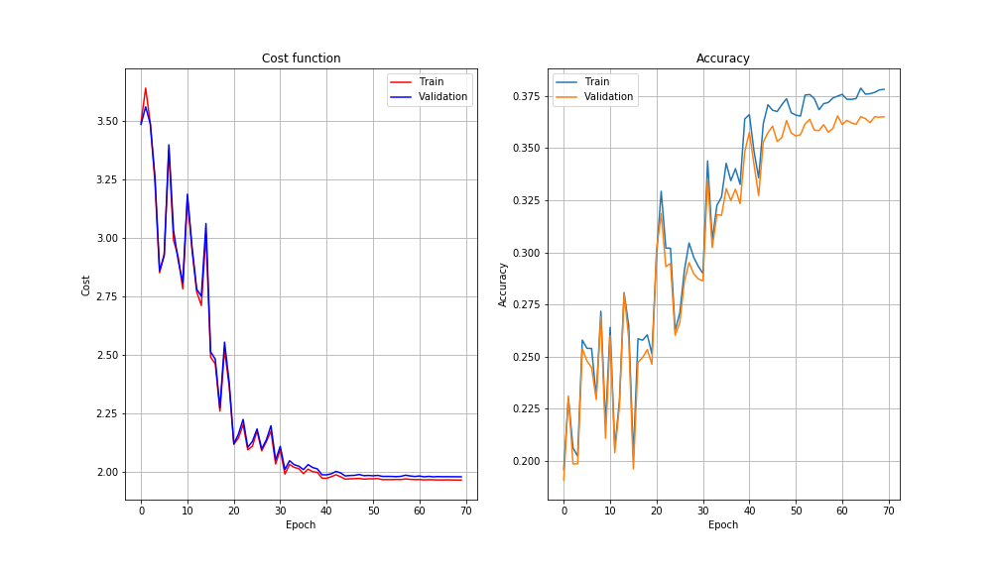

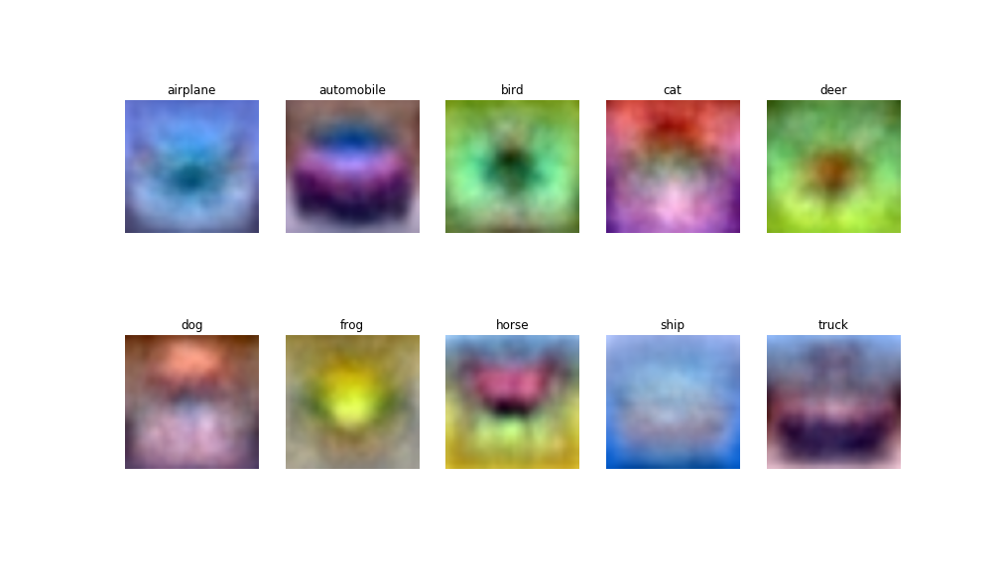

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.640%
- cost:     1.967
Validation:
- accuracy: 36.410%%
- cost:      1.981


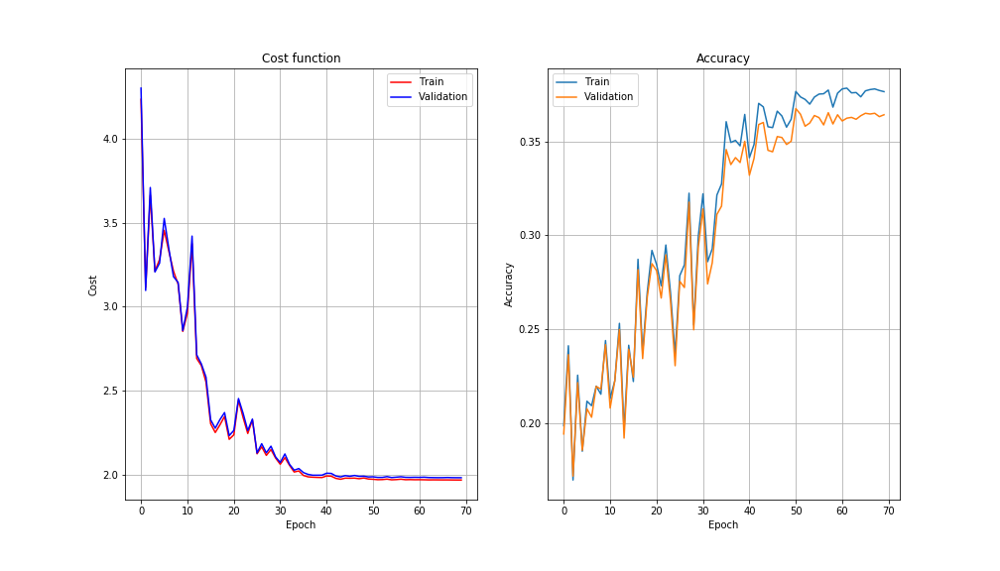

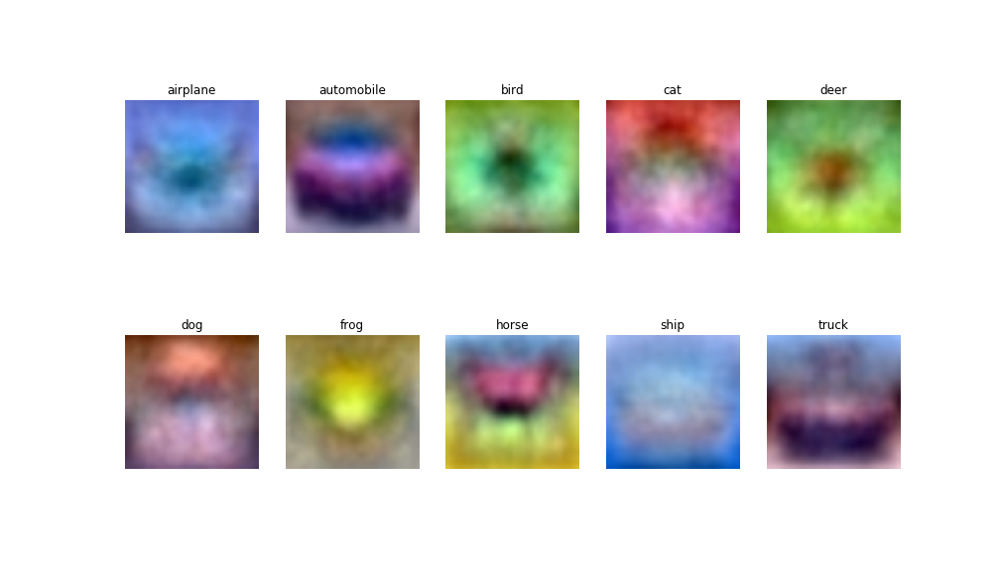

Model trained with:
- initial eta	0.050
- final eta	0.000
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.728%
- cost:     1.967
Validation:
- accuracy: 36.380%%
- cost:      1.981


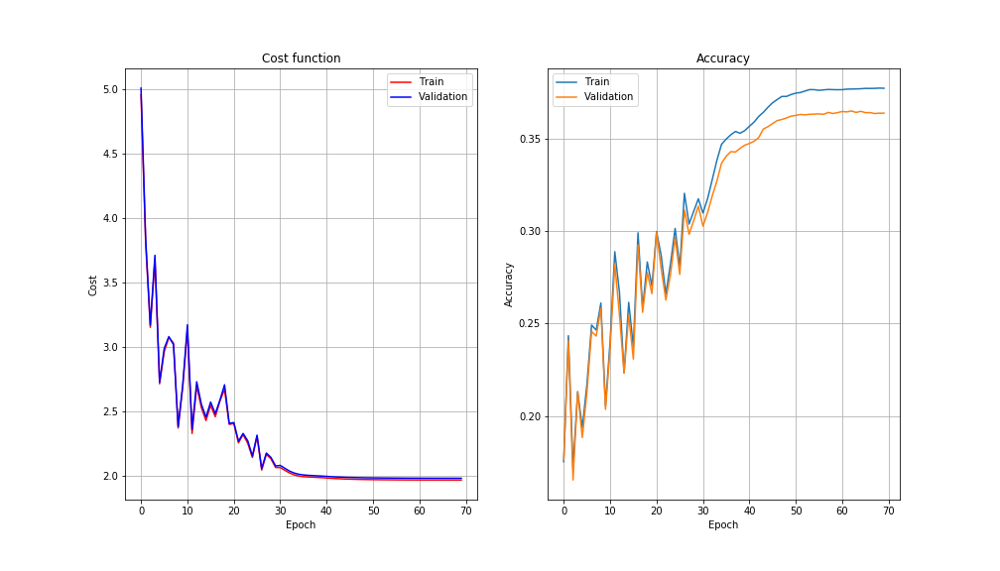

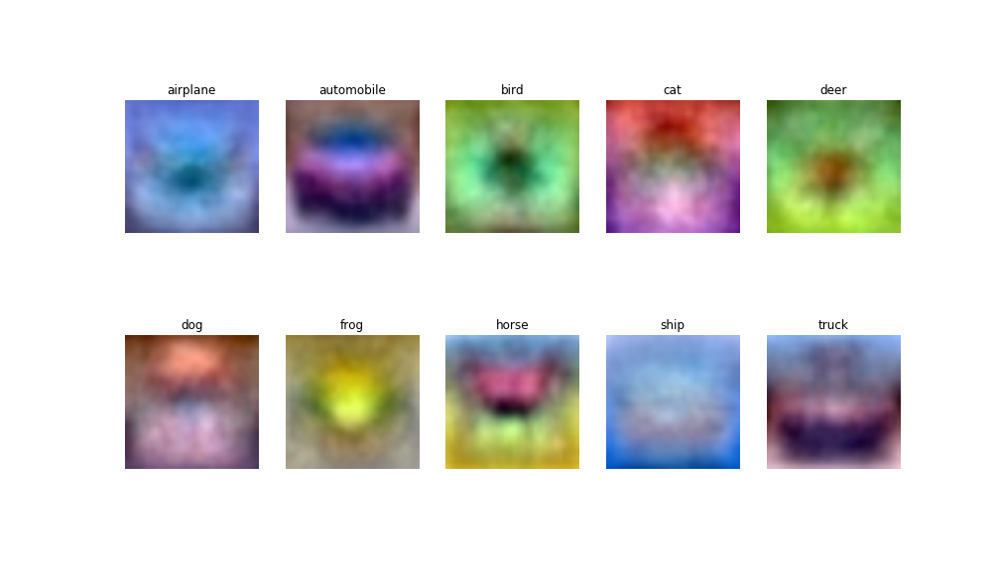

Model trained with:
- initial eta	0.050
- final eta	0.001
- epochs	70
- batch_size	1000
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.748%
- cost:     1.967
Validation:
- accuracy: 36.350%%
- cost:      1.980


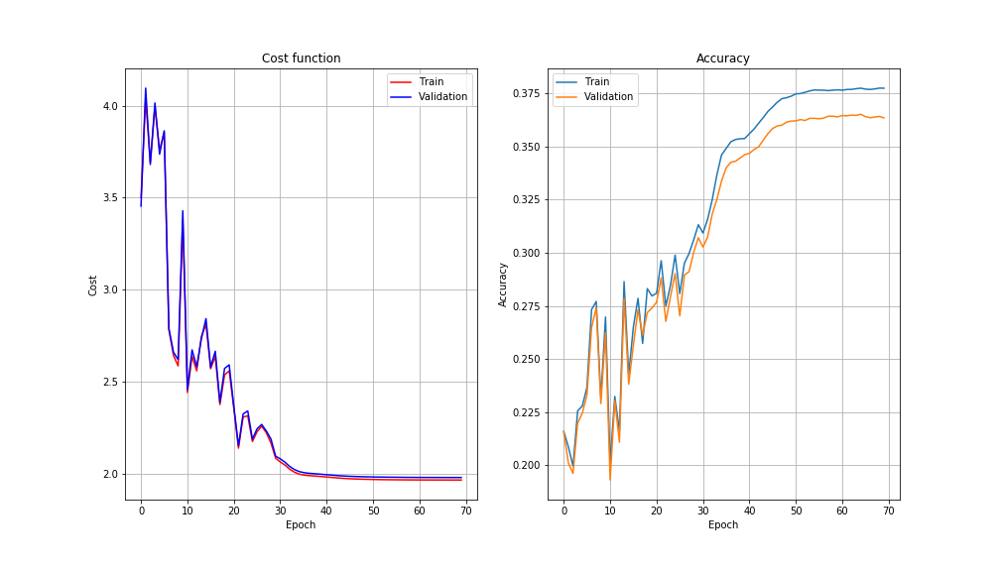

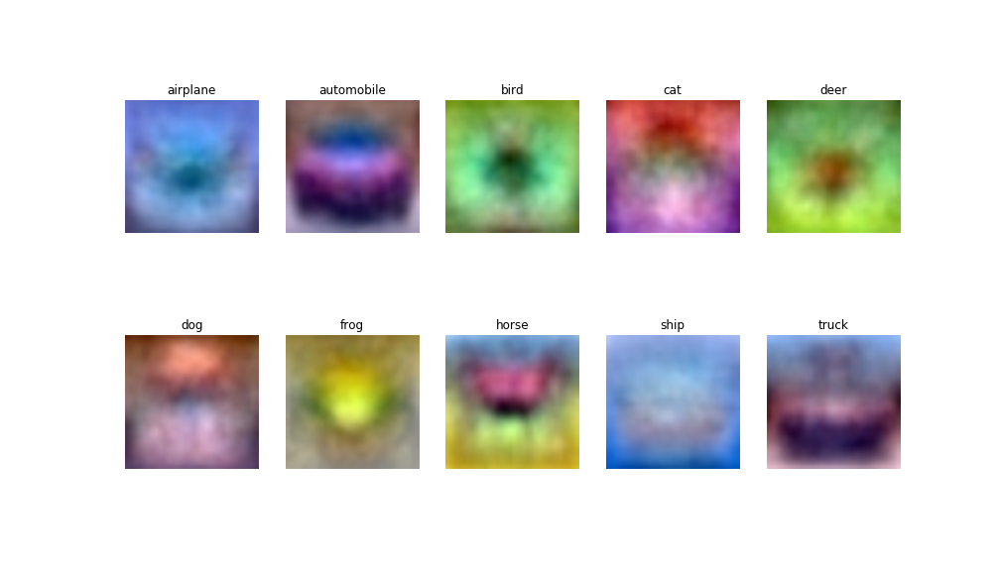

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.008%
- cost:     1.971
Validation:
- accuracy: 35.880%%
- cost:      1.985


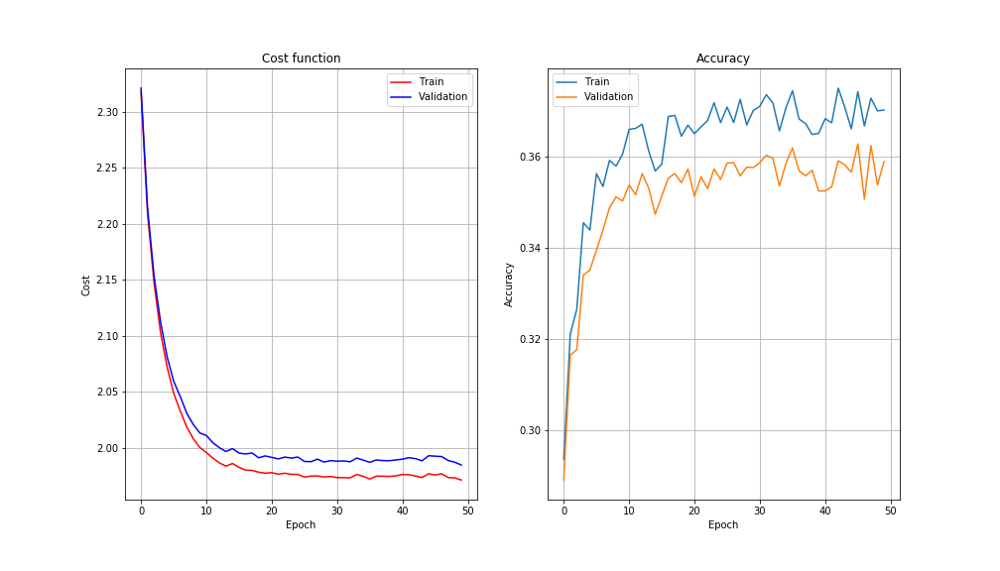

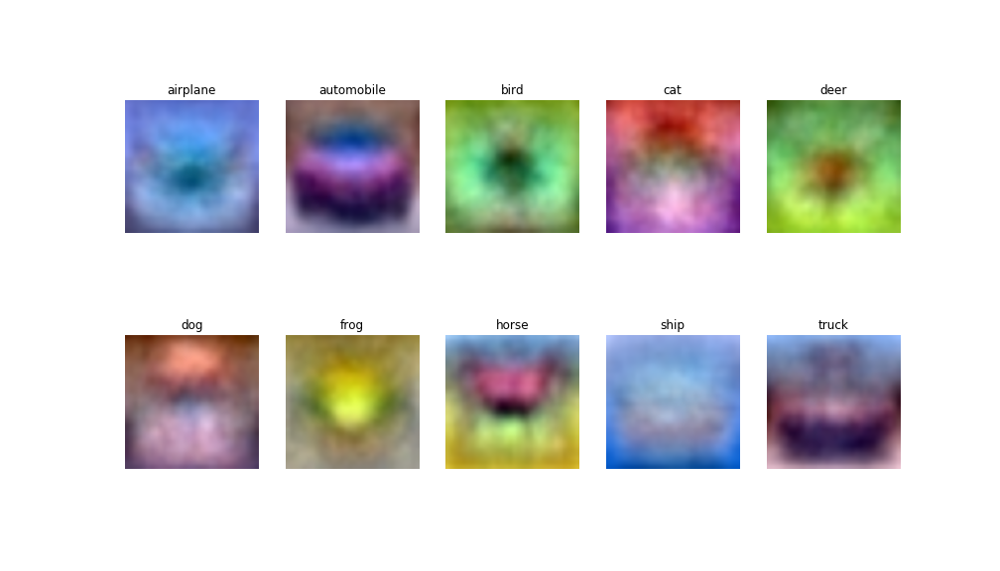

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 37.070%
- cost:     1.974
Validation:
- accuracy: 35.810%%
- cost:      1.988


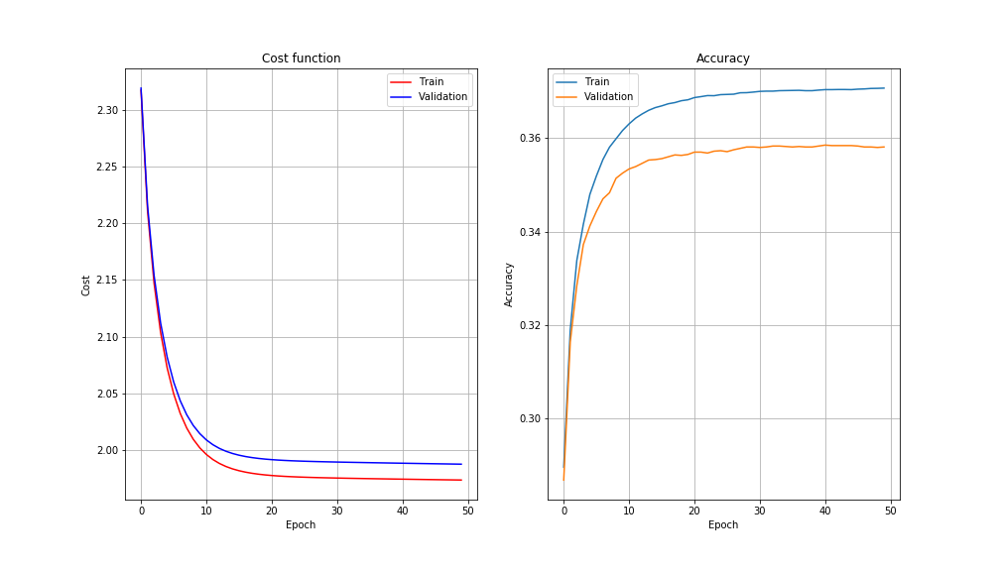

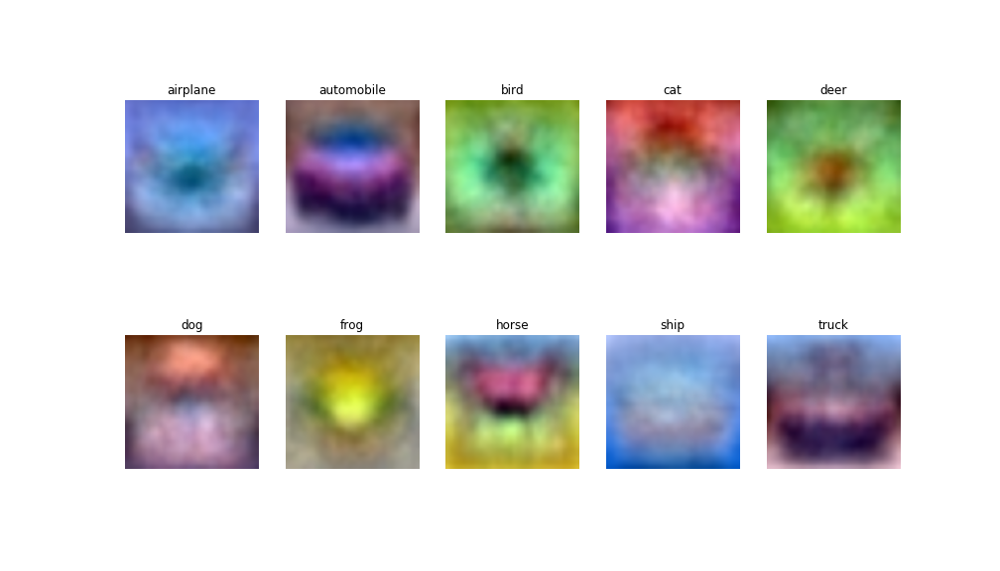

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	30
- batch_size	500
- lambda	0.100
- shuffle	True
Training:
- accuracy: 37.252%
- cost:     1.973
Validation:
- accuracy: 35.790%%
- cost:      1.988


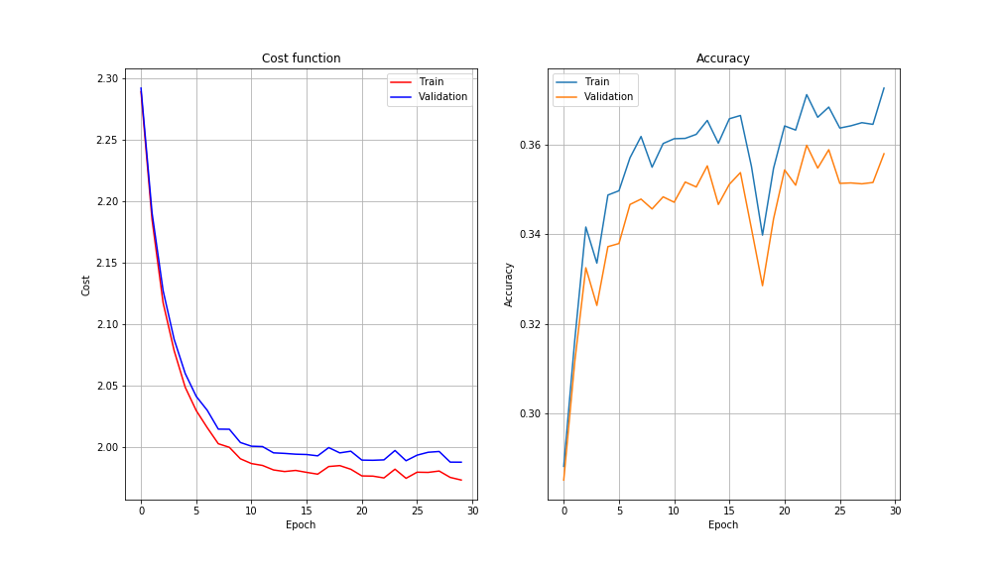

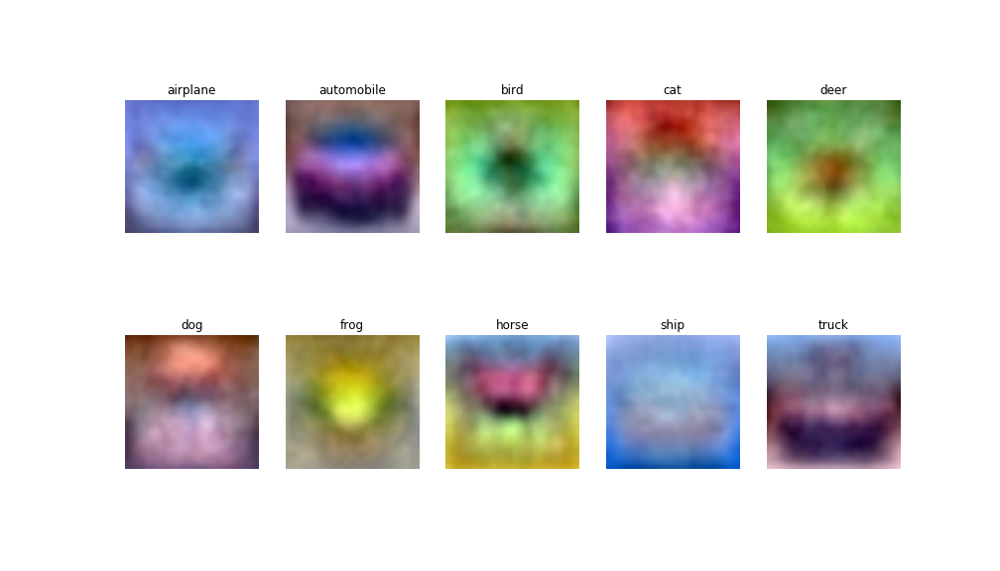

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	250
- lambda	0.100
- shuffle	True
Training:
- accuracy: 36.590%
- cost:     1.975
Validation:
- accuracy: 35.760%%
- cost:      1.988


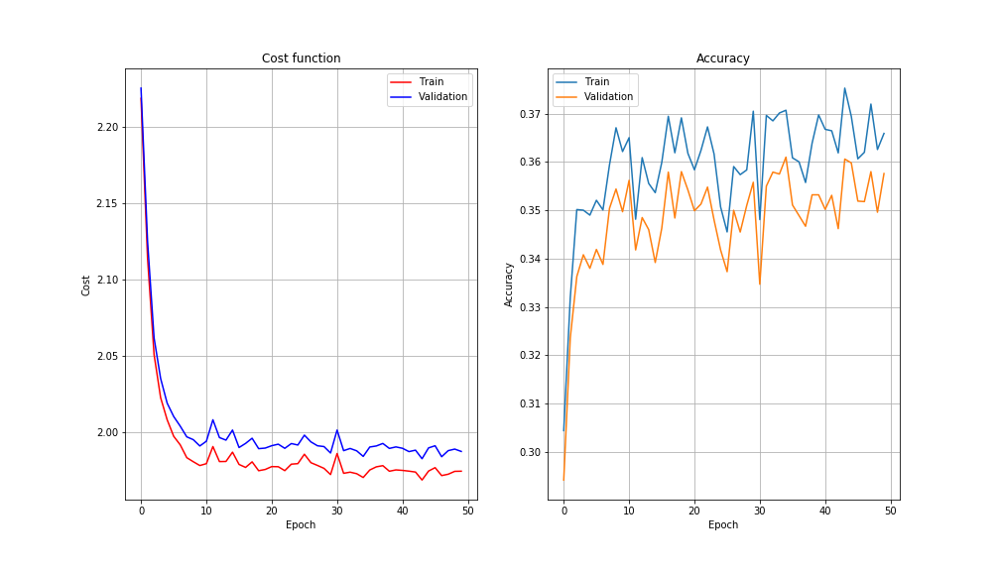

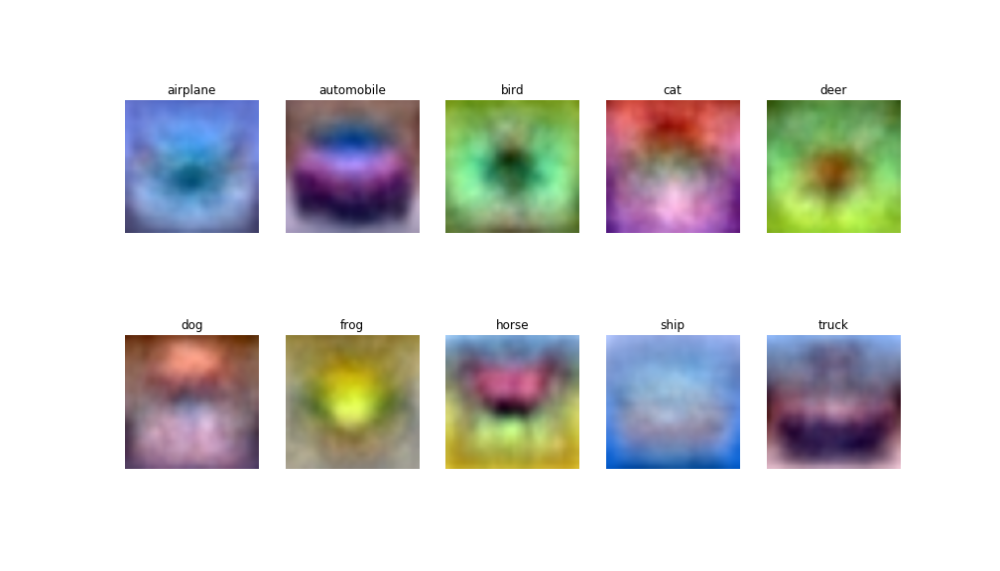

Model trained with:
- initial eta	0.008
- final eta	0.008
- epochs	50
- batch_size	250
- lambda	0.100
- shuffle	False
Training:
- accuracy: 36.580%
- cost:     1.975
Validation:
- accuracy: 35.330%%
- cost:      1.989


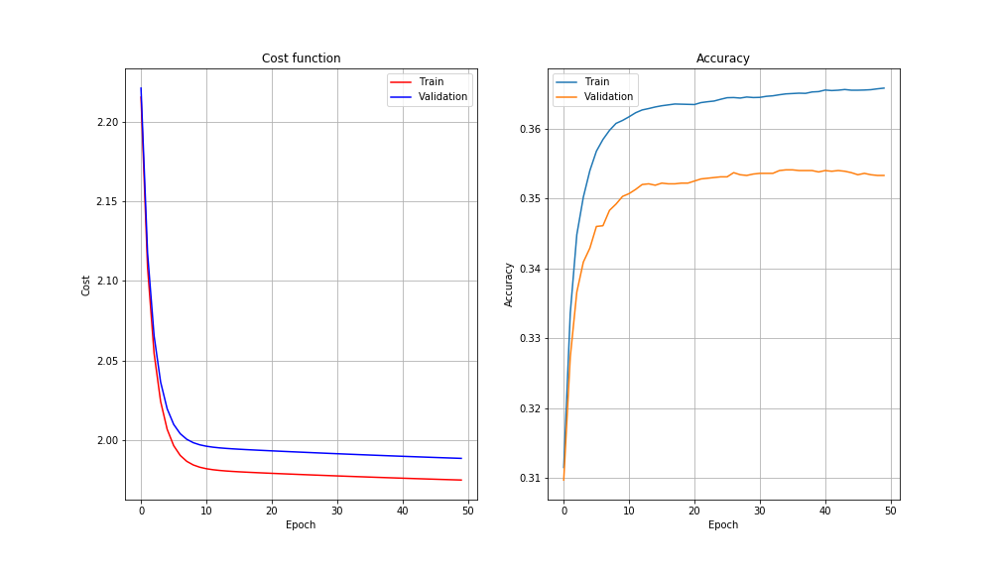

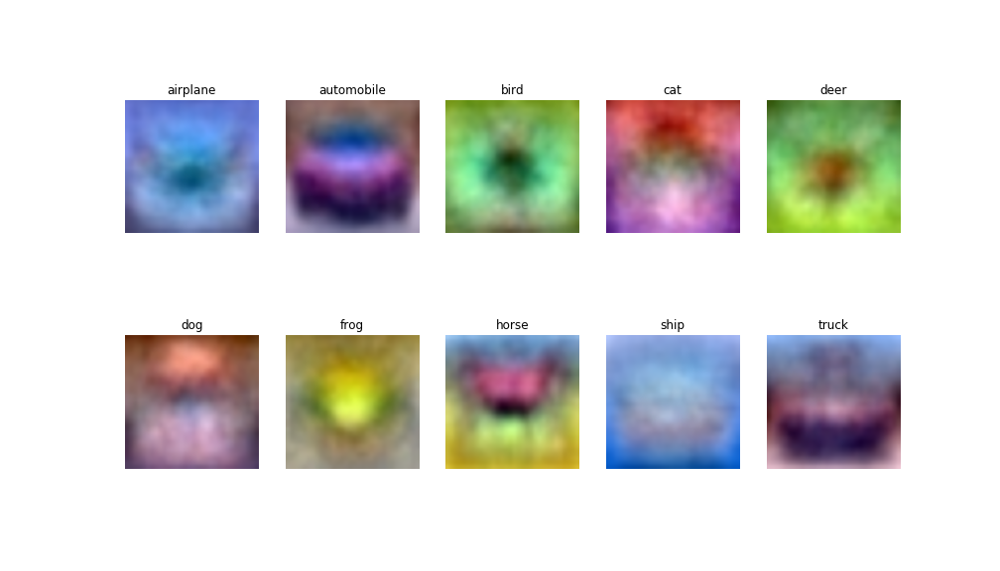

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	50
- batch_size	200
- lambda	0.100
- shuffle	True
Training:
- accuracy: 36.565%
- cost:     1.969
Validation:
- accuracy: 35.300%%
- cost:      1.981


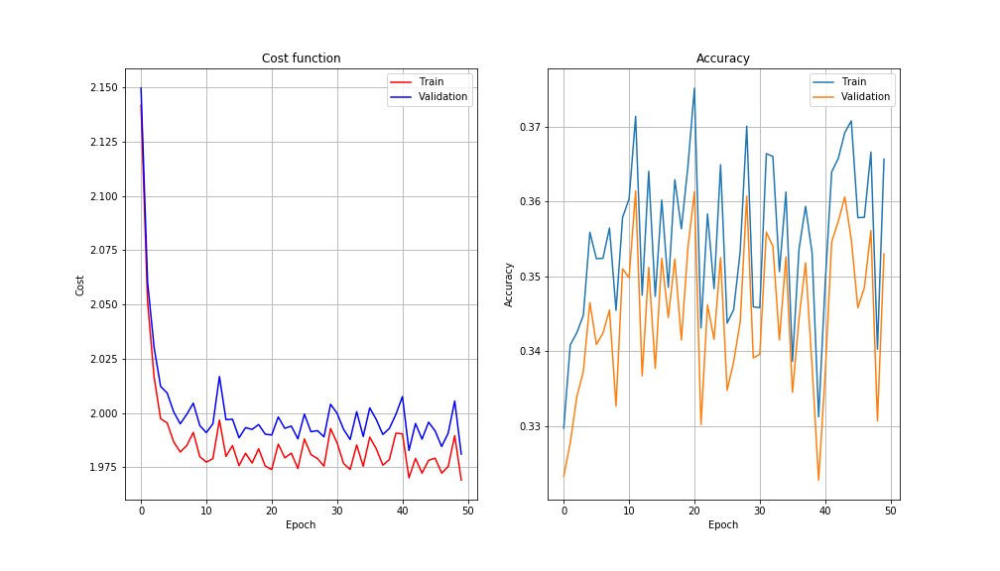

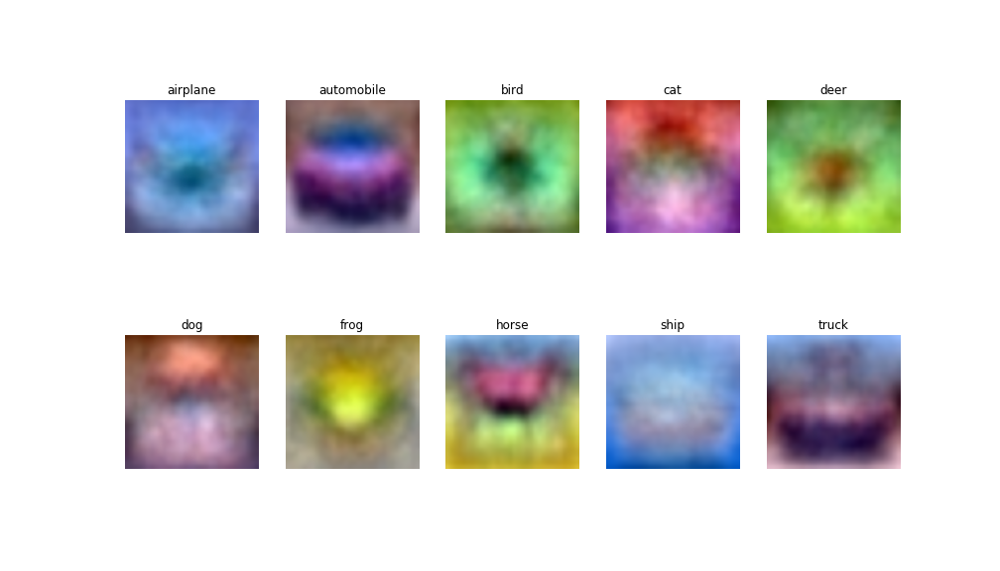

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	30
- batch_size	500
- lambda	0.100
- shuffle	False
Training:
- accuracy: 36.473%
- cost:     1.977
Validation:
- accuracy: 35.300%%
- cost:      1.991


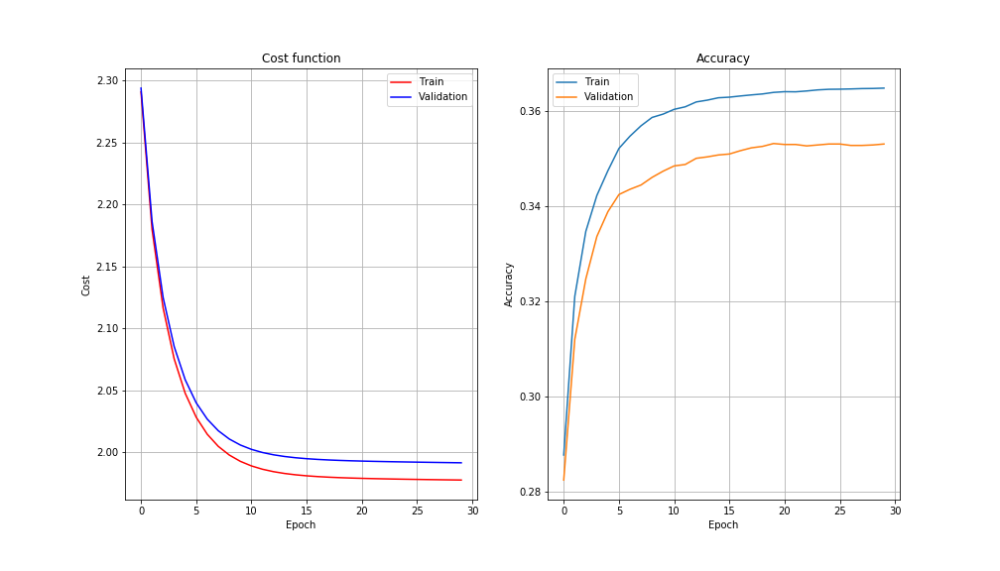

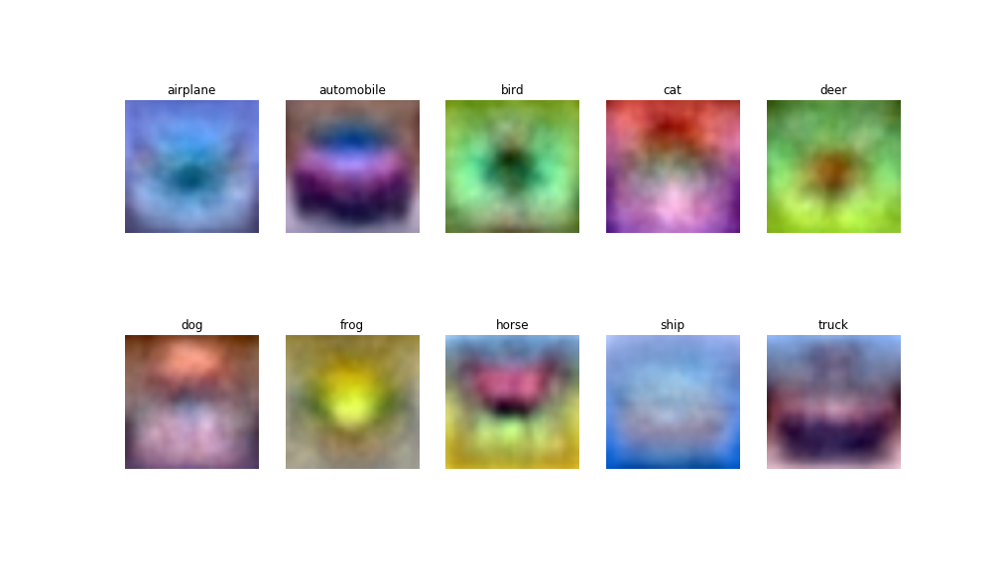

Model trained with:
- initial eta	0.010
- final eta	0.010
- epochs	50
- batch_size	200
- lambda	0.100
- shuffle	False
Training:
- accuracy: 35.325%
- cost:     1.983
Validation:
- accuracy: 34.480%%
- cost:      1.996


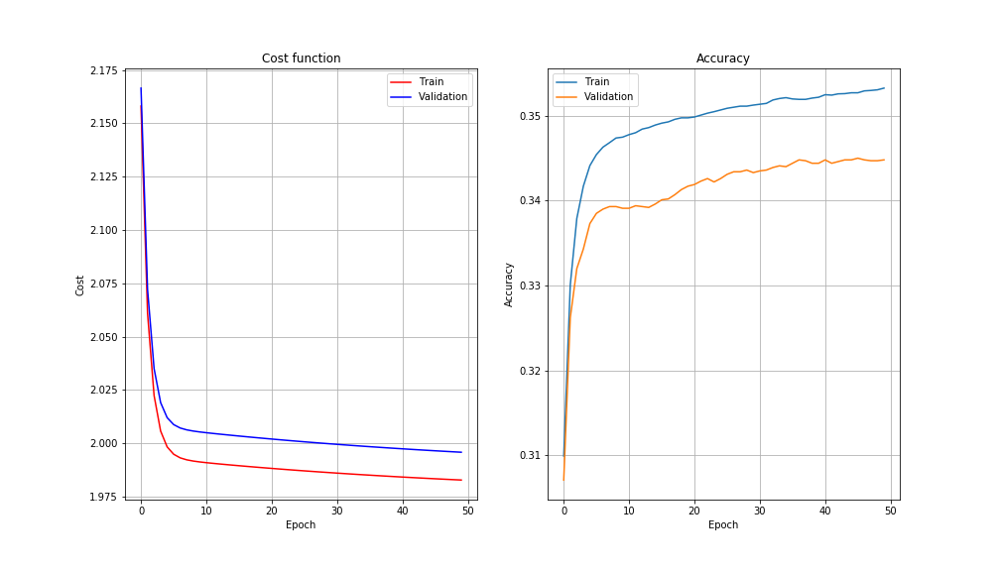

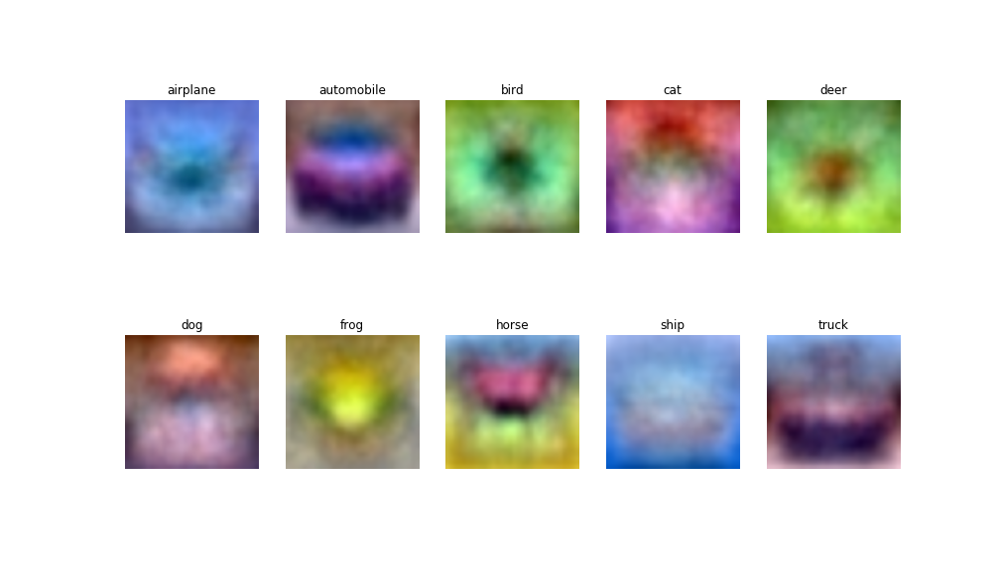

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	500
- lambda	0.300
- shuffle	False
Training:
- accuracy: 34.603%
- cost:     2.075
Validation:
- accuracy: 34.140%%
- cost:      2.082


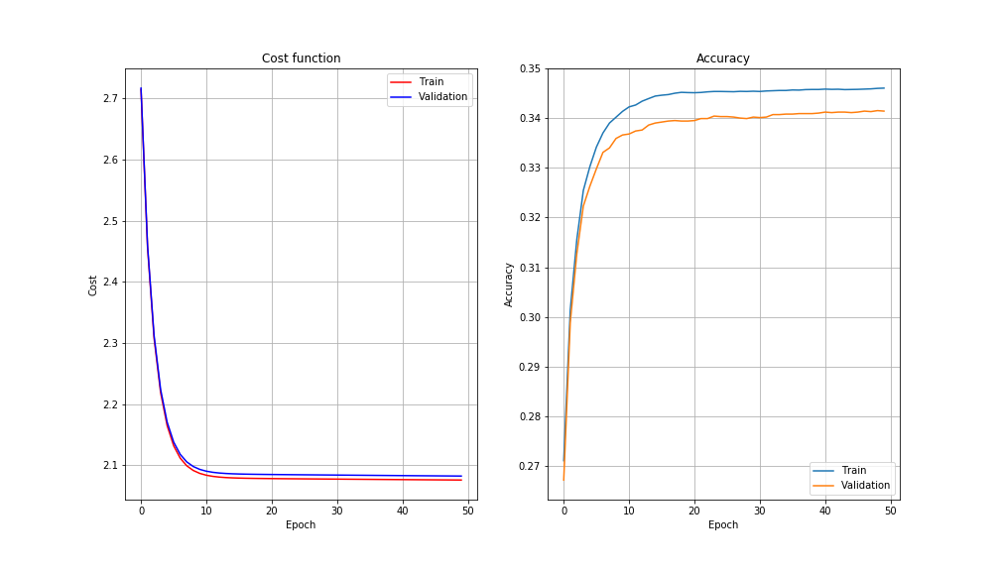

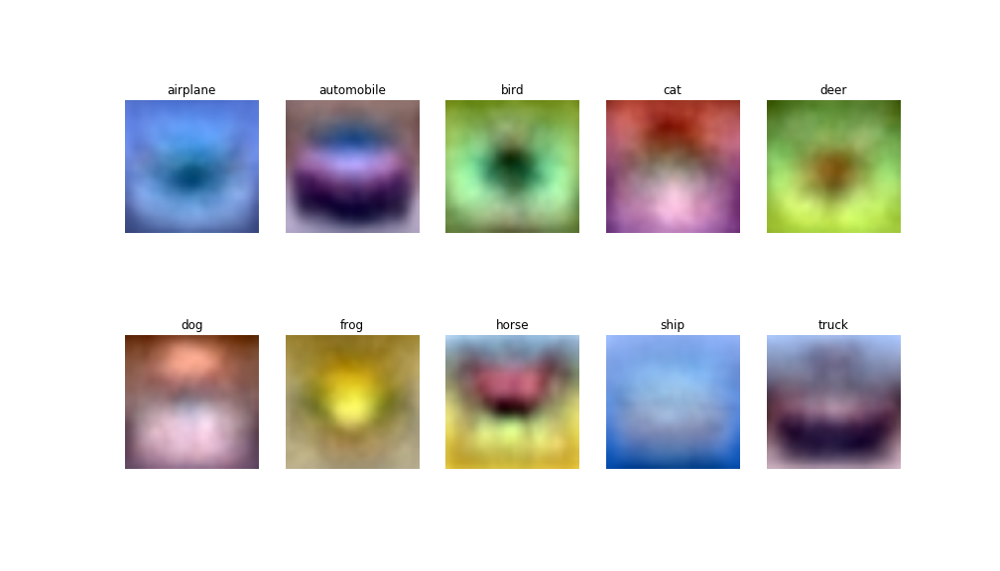

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	200
- lambda	0.300
- shuffle	True
Training:
- accuracy: 34.120%
- cost:     2.073
Validation:
- accuracy: 33.430%%
- cost:      2.079


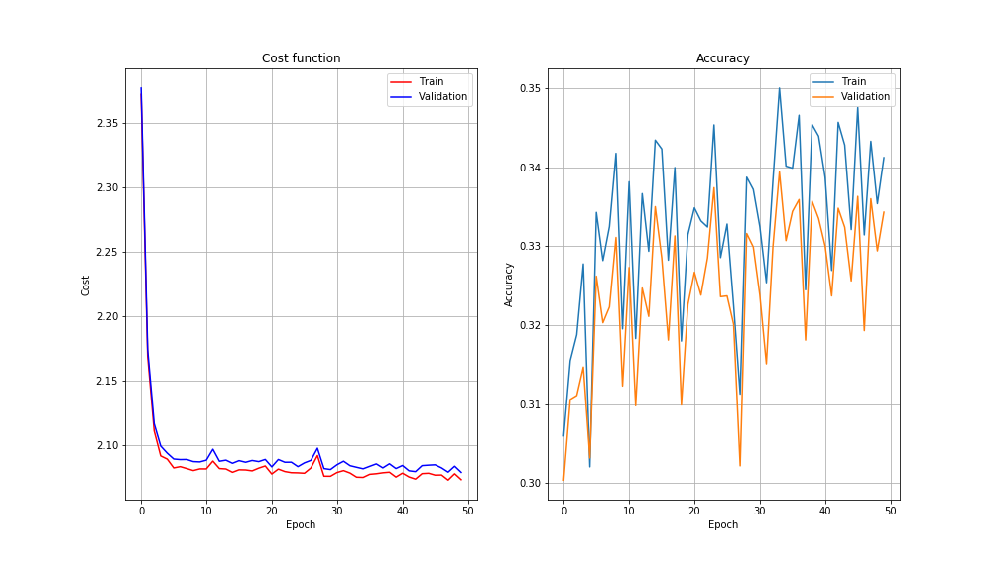

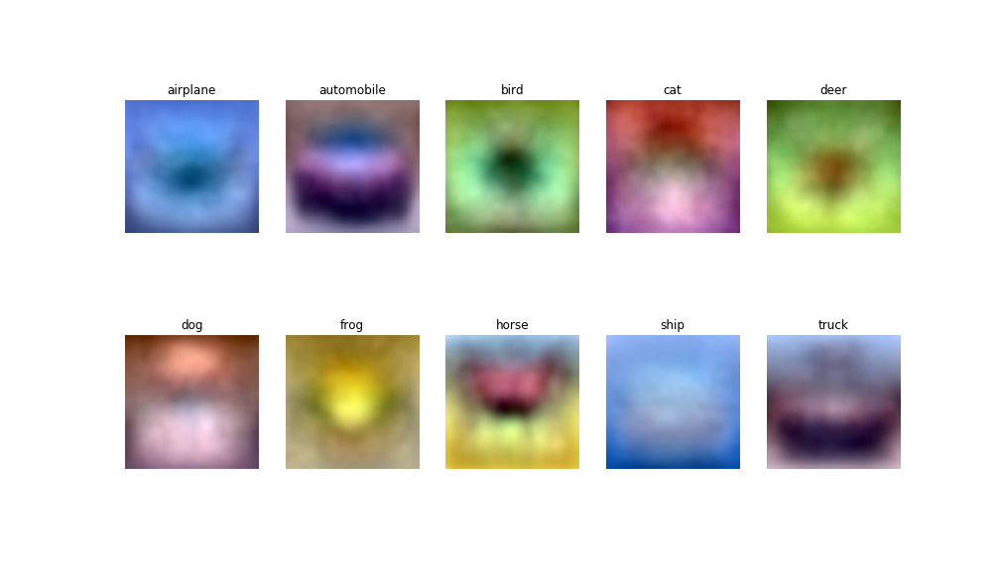

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	200
- lambda	0.300
- shuffle	False
Training:
- accuracy: 33.830%
- cost:     2.075
Validation:
- accuracy: 33.410%%
- cost:      2.081


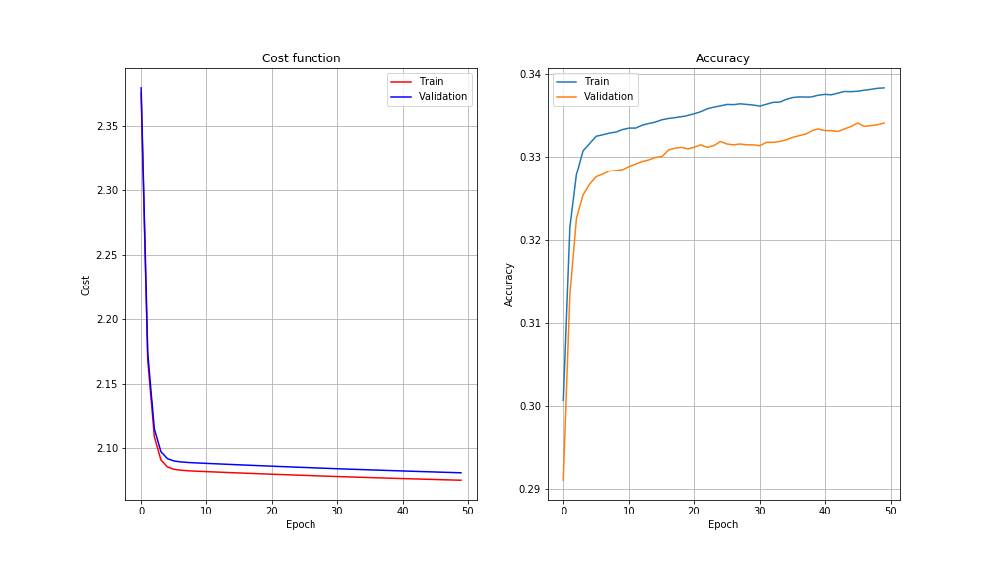

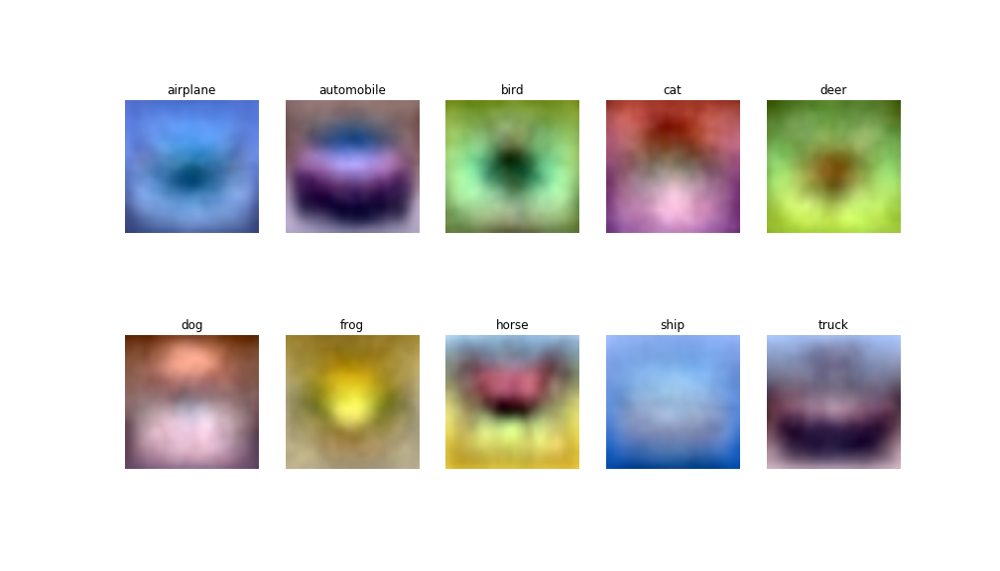

Model trained with:
- initial eta	0.005
- final eta	0.005
- epochs	50
- batch_size	500
- lambda	0.300
- shuffle	True
Training:
- accuracy: 33.682%
- cost:     2.077
Validation:
- accuracy: 33.060%%
- cost:      2.082


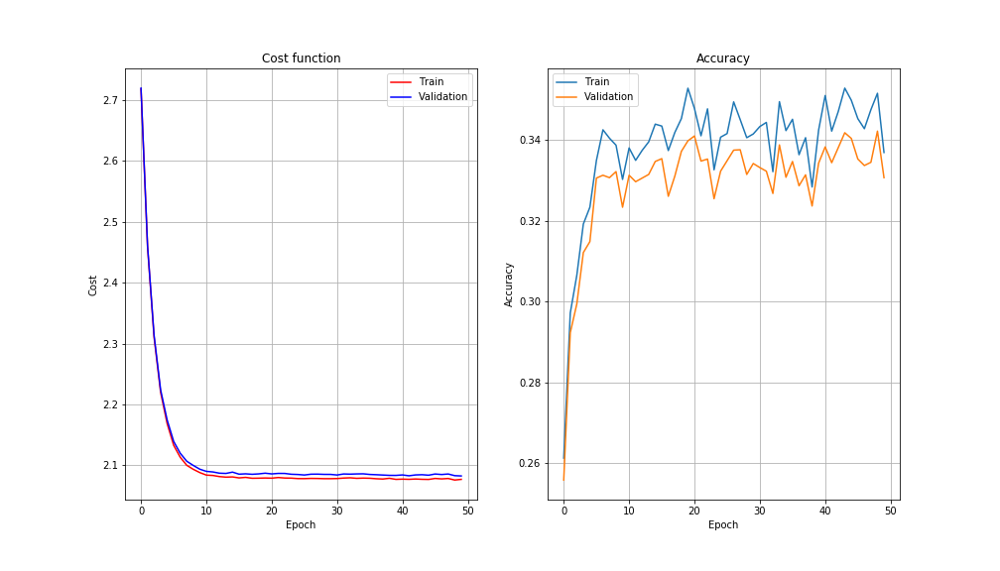

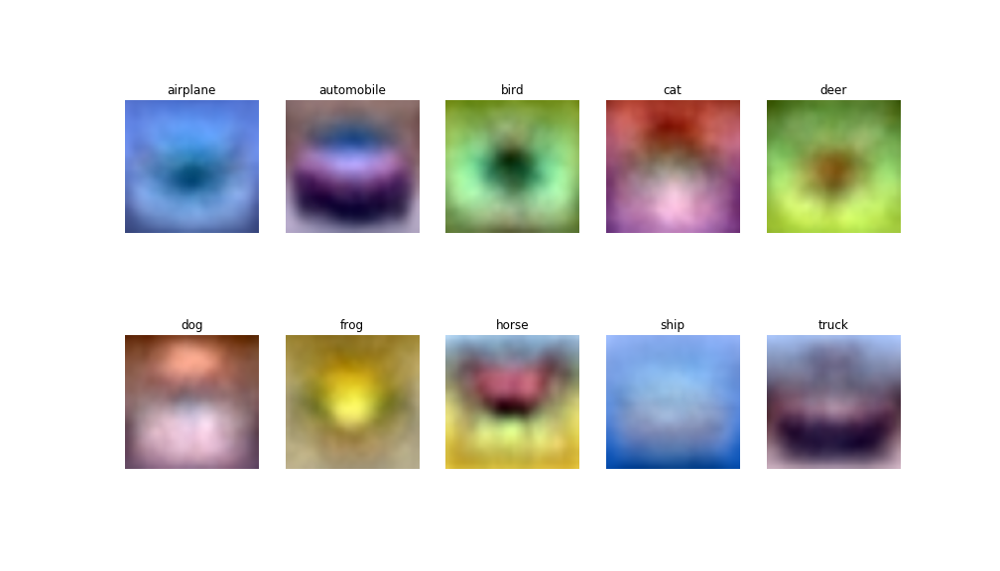

In [28]:
for i in range(df.shape[0]):
    print(df.iloc[i]['summary'])
    print(df.iloc[i]['cost_accuracy_string'])
    display(Image(df.iloc[i]['cost_accuracy_plot']))
    display(Image(df.iloc[i]['weight_viz']))

Now let's select the the model that performs better on the validation set and use the test set to give an unbiased score of its performances.

In [29]:
best_net = df.iloc[0]['model']
_, predictions = best_net.evaluate(test['images'].transpose())
test_accuracy = n.accuracy(predictions, test['one_hot_labels'].transpose())

print(df.iloc[0]['summary'])
print(df.iloc[0]['cost_accuracy_string'])
print('Test:\n- accuracy {:.2%}'.format(test_accuracy))

Model trained with:
- initial eta	0.100
- final eta	0.000
- epochs	50
- batch_size	500
- lambda	0.000
- shuffle	True
Training:
- accuracy: 44.390%
- cost:     1.643
Validation:
- accuracy: 40.770%%
- cost:      1.740
Test:
- accuracy 40.75%


### Performances of an ensemble on the test set

To try to get a better classifier we can put together the 10 best scoring classifiers using an ensemble method.

For each image in the test set, a class is obtained by summing the individual class probabilites given by each classifier and then taking the max.

In [30]:
def ensemble_accuracy(models, data_set):
    individual_accuracies = []
    probabilities_ens = np.zeros_like(data_set['one_hot_labels'], dtype=np.float64).transpose()
    for m in models:
        probs, preds = m.evaluate(data_set['images'].transpose())
        probabilities_ens += probs
        individual_accuracies.append(m.accuracy(preds, data_set['one_hot_labels'].T))
    predictions_ens = np.argmax(probabilities_ens, axis=0)
    return models[0].accuracy(predictions_ens, data_set['one_hot_labels'].transpose()), \
            individual_accuracies, predictions_ens

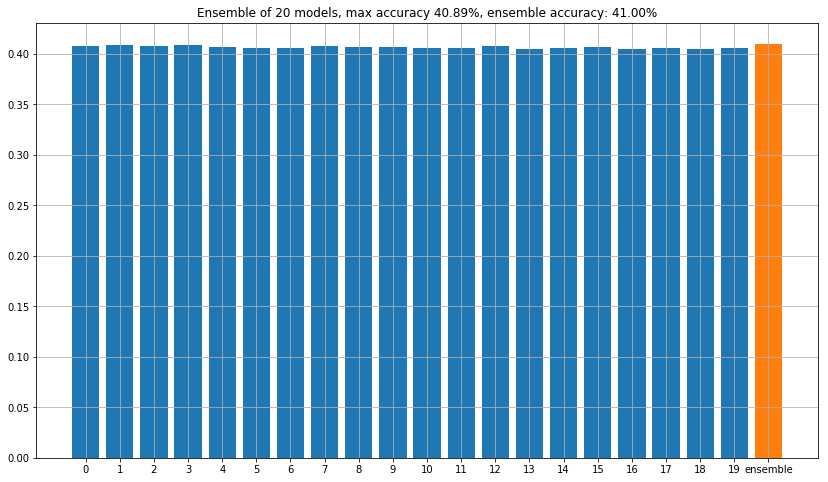

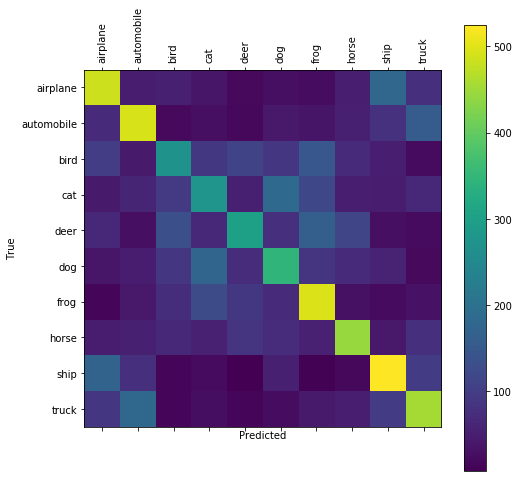

In [31]:
models = df.iloc[:20]['model'].tolist()
ensemble_acc, individual_accuracies, predictions_ens = ensemble_accuracy(models, test)

plt.bar(range(len(models)), individual_accuracies)
plt.bar(len(models), ensemble_acc)
plt.grid(True)
plt.xticks(range(len(models) + 1), list(map(str, range(len(models)))) + ['ensemble'])
plt.title('Ensemble of {} models, max accuracy {:.2%}, ensemble accuracy: {:.2%}'
          .format(len(models), max(individual_accuracies),ensemble_acc));
plt.show()

cm = confusion_matrix(y_true=test['labels'], y_pred=predictions_ens)
plt.matshow(cm)
plt.colorbar()
tick_marks = np.arange(len(cifar.labels))
plt.xticks(tick_marks, cifar.labels, rotation='vertical')
plt.yticks(tick_marks, cifar.labels)
plt.xlabel('Predicted')
plt.ylabel('True')

plt.show()

## Bagging
The ensemble of classifiers actually improved the performances, but not as much as we wanted. In fact, ensemble methods rely on classifiers that have low bias (just like our case, where the individual accuracies are around 40%) and high variance (the decision boundary should be very variable between different trained classifiers). In this way, given a sample, the individual classifiers are most likely to misclassify it, but the probability of them being all in agreement on a wrong is low.

By looking at the confusion matrices, our classifiers usually focus on predicting airplanes, automobiles, frogs, horses, ships and trucks. To diversify our networks, we can train on datasets that are built from the original one by randomly selecting images with replacement.

Later, we will put together these classifiers to build an ensemble that will hopefully perform better.

Here is an example:

In [32]:
def bagging(dataset):
    N = dataset['labels'].size
    indexes = np.random.choice(np.arange(N), size = N, replace=True)
    return {
            'batch_name': dataset['batch_name'] + '_bagging',
            'images': np.vstack(dataset['images'][indexes]),
            'one_hot_labels': np.vstack(dataset['one_hot_labels'][indexes]),
            'labels': np.hstack(dataset['labels'][indexes])
        }

Here we train 20 versions of the same classifier on different bootstrap datasets.

In [33]:
%%time
test_params = (
    {
        'l': 0,
        'epochs': 50,
        'batch_size': 500,
        'initial_eta': .1,
        'final_eta': .0001,
        'shuffle': True, 
        'train_id': i
    } 
    for i in range(20)
)

df = pd.DataFrame([{
        **p, 
        **create_and_train(cifar, bagging(training), validation, **p)
    } 
    for p in test_params])

100%|██████████| 50/50 [03:45<00:00,  4.50s/it]


CPU times: user 1h 16min 17s, sys: 35.9 s, total: 1h 16min 52s
Wall time: 1h 16min 32s


In [34]:
df[['batch_size', 'epochs', 'initial_eta', 'final_eta', 'l', 'shuffle', 'validation_accuracy']]

,batch_size,epochs,initial_eta,final_eta,l,shuffle,validation_accuracy
0,500,50,0.1,0.0001,0,True,0.4013
1,500,50,0.1,0.0001,0,True,0.3968
2,500,50,0.1,0.0001,0,True,0.3924
3,500,50,0.1,0.0001,0,True,0.3955
4,500,50,0.1,0.0001,0,True,0.3922
5,500,50,0.1,0.0001,0,True,0.3971
6,500,50,0.1,0.0001,0,True,0.3963
7,500,50,0.1,0.0001,0,True,0.3983
8,500,50,0.1,0.0001,0,True,0.3974
9,500,50,0.1,0.0001,0,True,0.3955


As we see below, this ensemble behaves quite the same as the previous one, so bagging didn't do the miracle.

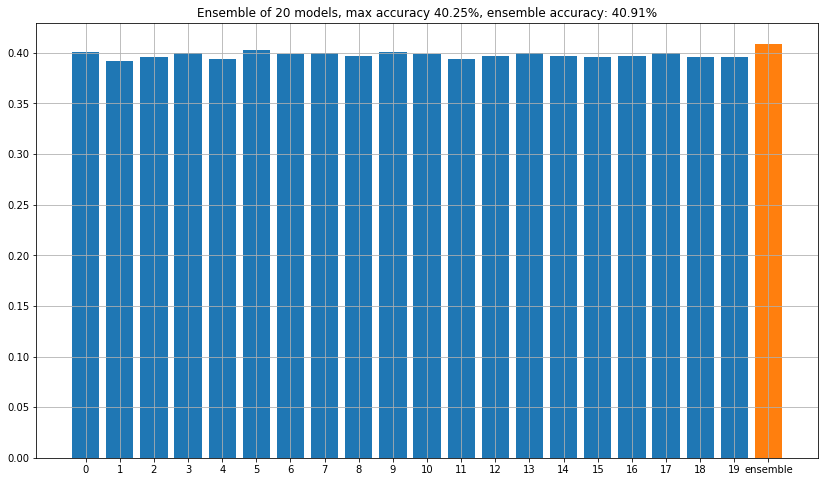

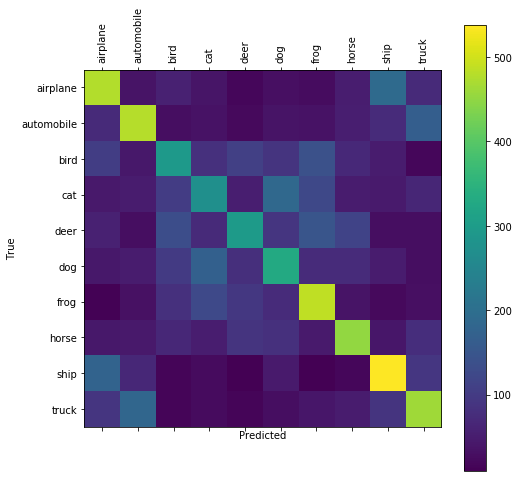

In [35]:
models = df.iloc[:]['model'].tolist()
ensemble_acc, individual_accuracies, predictions_ens = ensemble_accuracy(models, test)

plt.bar(range(len(models)), individual_accuracies)
plt.bar(len(models), ensemble_acc)
plt.grid(True)
plt.xticks(range(len(models) + 1), list(map(str, range(len(models)))) + ['ensemble'])
plt.title('Ensemble of {} models, max accuracy {:.2%}, ensemble accuracy: {:.2%}'
          .format(len(models), max(individual_accuracies),ensemble_acc));
plt.show()

cm = confusion_matrix(y_true=test['labels'], y_pred=predictions_ens)
plt.matshow(cm)
plt.colorbar()
tick_marks = np.arange(len(cifar.labels))
plt.xticks(tick_marks, cifar.labels, rotation='vertical')
plt.yticks(tick_marks, cifar.labels)
plt.xlabel('Predicted')
plt.ylabel('True')

plt.show()

In [37]:
!jupyter nbconvert --to html Assignment1.ipynb

[NbConvertApp] Converting notebook Assignment1.ipynb to html
[NbConvertApp] Writing 38894630 bytes to Assignment1.html
